# Experiment 4
Transaction Rate
1. One per Seconds
2. One per 2 Seconds
3. One per 5 Seconds
4. One per 10 Seconds

# Experiment 4.1

Batch Time Out : 10 Sec
Pref Max Bytes: 36 KB
Endorsement Policy: ALL OR
Transaction Rate : One per Second

In [1]:
from time import sleep
def create_peer_invoke_command():
    base = "docker exec -it cli peer chaincode invoke -o orderer.organ.com:7050 --tls true --cafile /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/ordererOrganizations/organ.com/orderers/orderer.organ.com/msp/tlscacerts/tlsca.organ.com-cert.pem -C organ-channel -n organcc "
    return(base)

def add_peers(org='hl', peer_n=0):
    hl_p1_add = ' --peerAddresses peer1.histocompatibility.organ.com:7051 '
    hl_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/histocompatibility.organ.com/peers/peer1.histocompatibility.organ.com/tls/ca.crt '
    hl_p0_add = ' --peerAddresses peer0.histocompatibility.organ.com:7051 '
    hl_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/histocompatibility.organ.com/peers/peer0.histocompatibility.organ.com/tls/ca.crt '
    
    ho_p1_add = ' --peerAddresses peer1.hospital.organ.com:7051 '
    ho_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/hospital.organ.com/peers/peer1.hospital.organ.com/tls/ca.crt  '
    ho_p0_add = ' --peerAddresses peer0.hospital.organ.com:7051 '
    ho_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/hospital.organ.com/peers/peer0.hospital.organ.com/tls/ca.crt  '
    
    gp_p1_add = ' --peerAddresses peer1.gp.organ.com:7051 '
    gp_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/gp.organ.com/peers/peer1.gp.organ.com/tls/ca.crt  '
    gp_p0_add = ' --peerAddresses peer0.gp.organ.com:7051 '
    gp_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/gp.organ.com/peers/peer0.gp.organ.com/tls/ca.crt  '
    
    op_p1_add = ' --peerAddresses peer1.opo.organ.com:7051 '
    op_p1_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/opo.organ.com/peers/peer1.opo.organ.com/tls/ca.crt  '
    op_p0_add = ' --peerAddresses peer0.opo.organ.com:7051 '
    op_p0_cert = ' --tlsRootCertFiles /opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/opo.organ.com/peers/peer0.opo.organ.com/tls/ca.crt  '
    cmd = ""
    cmd += create_peer_invoke_command() + hl_p1_add + hl_p1_cert
    cmd += hl_p0_add + hl_p0_cert
    cmd += ho_p0_add + ho_p0_cert + ho_p1_add + ho_p1_cert
    cmd += gp_p0_add + gp_p0_cert + gp_p1_add + gp_p1_cert
    cmd += op_p0_add + op_p0_cert + op_p1_add + op_p1_cert
    return(cmd)

def add_organ(organ_id = '', organ_name='', organ_data=''):
    cmd = add_peers() + '-c '
    
    cmd += '\'{"Args":["initOrgan", "' + str(organ_id) + '", "' + str(organ_name) + '", ' + str(organ_data) + ']}\''
    return(cmd)

def read_organ(organ_id='421'):
    cmd = add_peers()
    cmd +=  '-c \'{\"Args\":[\"readOrgan",\"' + str(organ_id) + '\"]}\''
    return(cmd)

def add_candidate(candidate_id = '', organ_name='', info=''):
    cmd = add_peers() + '-c '
    cmd += '\'{"Args":["initCandidate", "' + candidate_id + '", "' + organ_name + '", ' + info + ']}\''
    return(cmd)

def read_candidate(candidate_id='421'):
    cmd = add_peers()
    cmd +=  '-c \'{\"Args\":[\"readCandidate",\"' + str(candidate_id) + '\"]}\''
    return(cmd)

def docker_cleanup():
    !{ "docker rm -f $(docker ps -aq)"}
    !{ "docker volume prune -f"}
    !{ "docker network prune -f"}
    docker_images = "docker images --format '{{.Repository}}'"
    images = !{docker_images}
    dev_images=[]
    for image in images:
        if(image.find('dev-', 0, 6)>=0):
            dev_images.append(image)
    docker_rmi = "docker rmi -f "+" ".join(dev_images)
    print(docker_rmi)
    !{docker_rmi}

In [2]:
docker_cleanup()

9fcf32473412
b2f876bbda8e
707f3456ef45
cf195516a0ba
9350d485e599
f5f67c3cd02e
1e03b68f65ed
b16673c1753e
01e53c2d9954
75f21297a981
a8e3d452dbd8
9ac5927b1398
ee392ae0cc4a
fd5de479eaee
a916a0e19ca6
a3f66ed9687f
b0ec401dcbf7
205afb020440
Deleted Volumes:
experiment4transactionrate_peer0.hospital.organ.com
experiment4transactionrate_peer1.opo.organ.com
experiment4transactionrate_peer1.hospital.organ.com
5f5081bc7df73f08368f871f8366563edca08fc5169eeb5c0ac8817727363660
experiment4transactionrate_orderer.organ.com
experiment4transactionrate_peer0.gp.organ.com
experiment4transactionrate_peer0.histocompatibility.organ.com
experiment4transactionrate_peer0.opo.organ.com
experiment4transactionrate_peer1.gp.organ.com
experiment4transactionrate_peer1.histocompatibility.organ.com

Total reclaimed space: 29.37MB
Deleted Networks:
experiment4transactionrate_organ_chain_network

docker rmi -f dev-peer1.opo.organ.com-organcc-1.0-f7ab76561c21a418dff95bfcdf78a45d8518b5f2d2be784ba3c86fb909c544e7 dev-peer0.op

In [3]:
with open(r"/home/thesis/Downloads/data_1.json", 'r') as file:
    data_1 = file.read()
with open(r"/home/thesis/Downloads/data_2.json", 'r') as file:
    data_2 = file.read()
with open(r"/home/thesis/Downloads/data_3.json", 'r') as file:
    data_3 = file.read()
with open(r"/home/thesis/Downloads/data_4.json", 'r') as file:
    data_4 = file.read()
import json
data = []
data.append(json.dumps(data_1))
data.append(json.dumps(data_2))
data.append(json.dumps(data_3))
data.append(json.dumps(data_4))

Issueing Transactions every 1 seconds

In [7]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(1)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(1)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(1)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(1)

2019-04-22 18:41:47.375 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:41:47.375 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:41:47.375 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:41:47.376 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:41:47.376 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:41:47.376 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:41:47.376 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:41:47.376 UTC [viperutil] getKeysRec

2019-04-22 18:41:47.384 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 18:41:47.384 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 18:41:47.384 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:41:47.384 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 18:41:47.385 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000292c30, CONNECTING
2019-04-22 18:41:47.388 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000292c30, READY
2019-04-22 18:41:47.389 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:41:47.389 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:41:47.389 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 18:41:47.439 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000149800, READY
2019-04-22 18:41:47.441 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:41:47.441 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:41:47.441 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:41:47.441 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:41:47.441 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0006837c0, CONNECTING
2019-04-22 18:41:47.447 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0006837c0, READY
2019-04-22 18:41:47.448 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:41:47.448 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 18:41:48.925 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0003647f0, READY
2019-04-22 18:41:48.926 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:41:48.926 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:41:48.927 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:41:48.927 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:41:48.927 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e2de0, CONNECTING
2019-04-22 18:41:48.929 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e2de0, READY
2019-04-22 18:41:48.930 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:41:48.930 UTC [grpc] DialContext -> DEBU

2019-04-22 18:44:15.950 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08ED95F8E50510...C7A6BA46A46F0DF4386EBA02CEB1A787 
2019-04-22 18:44:15.950 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EB11D3F04F64F056A0C935EB287F5134BDCA9DDA08B908947EBDE575F3CDBC2D 
2019-04-22 18:44:15.954 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \262.`\322\030\305\201\374\207\032\246\300\r/\263\370\343\227=;\212\007+|3Gh\232\033\313\260\240\022\202\206\001\n\333\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\276\205\001\n\007organcc\022\261\205\001\n\006\n\0048001\022\005\n\001\001\030\001\032\236\205\001\n\0048001\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfe

2019-04-22 18:44:17.405 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:17.405 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:17.405 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:17.405 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:17.405 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:17.405 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:17.405 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:17.405 UTC [viperutil] getKeysRec

2019-04-22 18:44:17.449 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00051df40, READY
2019-04-22 18:44:17.450 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:44:17.450 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:17.450 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:44:17.450 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:44:17.451 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0004b8510, CONNECTING
2019-04-22 18:44:17.454 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004b8510, READY
2019-04-22 18:44:17.455 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:44:17.455 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:44:19.179 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:19.179 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:44:19.179 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:44:19.179 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:19.180 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:44:19.180 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:19.180 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:44:19.180 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-22 18:44:19.229 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000077eb0, READY
2019-04-22 18:44:19.229 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:44:19.229 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:19.229 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:44:19.229 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:19.230 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ec730, CONNECTING
2019-04-22 18:44:19.232 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ec730, READY
2019-04-22 18:44:19.232 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:44:19.232 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-22 18:44:20.835 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:20.835 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:20.836 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:20.836 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:20.837 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:20.837 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:20.837 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:20.838 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:44:20.878 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000275f00, READY
2019-04-22 18:44:20.879 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:44:20.879 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:20.879 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:20.879 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:20.879 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0003579b0, CONNECTING
2019-04-22 18:44:20.881 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0003579b0, READY
2019-04-22 18:44:20.882 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:44:20.882 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:44:21.047 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C088497F8E50510...CFFFCD436BF766A450304222417FFC9E 
2019-04-22 18:44:21.047 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: ECE7D5E8970F0D6AA4D863DAB1D08381D61F8FB6A7E55071900D84A7E4AC43F1 
2019-04-22 18:44:21.054 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \250X\006\2019\035\241\223$a\351\243\321\203\256ts\204\177HU?z\027\363:\203L\346w\"z\022\244\206\001\n\375\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\340\205\001\n\007organcc\022\323\205\001\n\006\n\0048004\022+\n\001\001\030\001\"$\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\032\232\205\001\n\0048004\032\220\205\001{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 3669

2019-04-22 18:44:22.541 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:22.541 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:22.541 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:22.543 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:22.543 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:22.543 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:22.544 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:22.544 UTC [viperutil] getKeysRec

2019-04-22 18:44:22.560 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0004338e0, READY
2019-04-22 18:44:22.561 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:44:22.561 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:44:22.561 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:44:22.561 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:22.561 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0000af6e0, CONNECTING
2019-04-22 18:44:22.564 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0000af6e0, READY
2019-04-22 18:44:22.565 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:44:22.565 UTC [grpc] DialContext -> DEBU

2019-04-22 18:44:22.782 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C088697F8E50510...6B6E62F2FE5DAAD8BED3C1514BBE48C0 
2019-04-22 18:44:22.783 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 25426F86308E4F1C607A36E6CBE6A2F2B7D2BFB6148D146F78D8559180810B7F 
2019-04-22 18:44:22.786 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n }\201\236\365;\243\037GoD\321\020\034X\305\277\217\013,)n\374KI`T\027V\2353\251\232\022\264\206\001\n\215\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\360\205\001\n\007organcc\022\343\205\001\n\006\n\0048005\0227\n\001\001\030\001\"0\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\032\236\205\001\n\0048005\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\"

2019-04-22 18:44:24.265 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:24.266 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:24.266 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:24.266 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:24.266 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:24.266 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:44:24.267 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:44:24.267 UTC [vipe

2019-04-22 18:44:24.297 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002741a0, READY
2019-04-22 18:44:24.301 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:44:24.301 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:24.301 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:24.301 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:24.301 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bb8e0, CONNECTING
2019-04-22 18:44:24.309 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003bb8e0, READY
2019-04-22 18:44:24.312 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:44:24.312 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:44:24.535 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C088897F8E50510...606401E2306AD38FA2C2D743F6680B47 
2019-04-22 18:44:24.535 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E3237DBD90711A5BBA1881A6E49CD16D2E15DF097BC4B19C034999E737D99F41 
2019-04-22 18:44:24.540 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n +\257VF\323\361\252\rA!\275\213\361\361\234\255\007\271R\202A\225k\371\343N\030-T\337\301\246\022\271\206\001\n\222\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\365\205\001\n\007organcc\022\350\205\001\n\006\n\0048006\022C\n\001\001\030\001\"<\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\032\227\205\001\n\0048006\032\215\205\001{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidat

2019-04-22 18:44:26.010 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:26.011 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:26.011 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:26.011 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:26.013 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:26.013 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:26.013 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:26.013 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:44:26.058 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000332c40, READY
2019-04-22 18:44:26.059 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:44:26.059 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:26.059 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:26.059 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:26.059 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00027bd00, CONNECTING
2019-04-22 18:44:26.062 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00027bd00, READY
2019-04-22 18:44:26.063 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:44:26.063 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:44:26.108 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00059bc20, READY
2019-04-22 18:44:26.109 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:44:26.114 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:44:26.115 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:26.115 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:44:26.115 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:44:26.115 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0006e8370, CONNECTING
2019-04-22 18:44:26.118 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006e8370, READY
2019-04-22 18:44:26.121 UTC [msp.identity

2019-04-22 18:44:27.776 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:27.776 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:27.776 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:27.776 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:27.776 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:27.776 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:27.777 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:27.777 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:44:27.800 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00036ba70, READY
2019-04-22 18:44:27.801 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:44:27.801 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:27.801 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:27.801 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:27.801 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003aca00, CONNECTING
2019-04-22 18:44:27.805 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003aca00, READY
2019-04-22 18:44:27.806 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:44:27.806 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:44:27.855 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:44:27.856 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:44:27.856 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:27.856 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:44:27.856 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:44:27.856 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0003acc90, CONNECTING
2019-04-22 18:44:27.859 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003acc90, READY
2019-04-22 18:44:27.861 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C088B97F8E50510...5F4341445F444F4E223A20227947227D 
2019-04-22 18:44:27.861 UTC [msp

2019-04-22 18:44:29.526 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:29.526 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:29.526 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:29.527 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:29.529 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:29.529 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:29.530 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:29.530 UTC [viperutil] getKeysRec

2019-04-22 18:44:29.580 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000596de0, READY
2019-04-22 18:44:29.580 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:44:29.580 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:29.581 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:29.581 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:29.581 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002cc640, CONNECTING
2019-04-22 18:44:29.585 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002cc640, READY
2019-04-22 18:44:29.586 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:44:29.586 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:44:29.775 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C088D97F8E50510...D2B188E11DECA430EC526A14B66CD633 
2019-04-22 18:44:29.775 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DF23A0B4646E629AE5FD0869CF206986CB24CCA03699B2210A8DDAEF139D60E0 
2019-04-22 18:44:29.778 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n P`\205\330f\220\306\227\270c\225H\254\001\211\2101\321\213\037g\211\325\307\217$\305\303\367#ng\022\344\206\001\n\275\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\240\206\001\n\007organcc\022\223\206\001\n\006\n\0048009\022g\n\001\001\030\001\"`\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022\002\010\r\032\236\205\0

2019-04-22 18:44:31.286 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:31.286 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:31.286 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:31.286 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:31.287 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:31.287 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:31.287 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:31.287 UTC [viperutil] getKeysRec

2019-04-22 18:44:31.319 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0004360a0, READY
2019-04-22 18:44:31.327 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:44:31.327 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:44:31.327 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:31.328 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:44:31.328 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0004bdf30, CONNECTING
2019-04-22 18:44:31.330 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0004bdf30, READY
2019-04-22 18:44:31.331 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:44:31.331 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:44:31.374 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C088F97F8E50510...5F4341445F444F4E223A20225962227D 
2019-04-22 18:44:31.374 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 49FEF657D6950B9963E6C9D16402682AA487473E46FF4E4CA866D2BBC81678CB 
2019-04-22 18:44:31.527 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C088F97F8E50510...D0DDAA730FDAD50EB30EB84C73073423 
2019-04-22 18:44:31.527 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 03D2C0EB13567FA2B7D5BCD5E95D9751D7F3ADE3D792DA0E6AA0FC19499C459D 
2019-04-22 18:44:31.532 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n f\357\241\010-\243\3546\367\350\014&\302\371\255=i\007\323\336~:\240\030\225\314\376D\245T\354\031\022\351\206\001\n\302\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\245\206\001\n\007organcc\022\230\206\001\

2019-04-22 18:44:32.999 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:32.999 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:32.999 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:33.000 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:33.000 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:33.000 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:44:33.000 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:44:33.001 UTC [vipe

2019-04-22 18:44:33.037 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:44:33.037 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:44:33.037 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:33.037 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:44:33.037 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00036d700, CONNECTING
2019-04-22 18:44:33.039 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00036d700, READY
2019-04-22 18:44:33.040 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:44:33.040 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:33.040 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-22 18:44:33.271 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B089197F8E50510...B596F338274E649C5035A8227D30BDD8 
2019-04-22 18:44:33.271 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4700E0139FF4172F270E1ABC08DC07040B1481234B23977B53D0FE0D8A1F0A23 
2019-04-22 18:44:33.275 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \375\331\321~y\372j\257\014\242\242,\262'\026\035Y\355\256y\226\303N\207\250w\314\023\020I$\004\022\364\206\001\n\315\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\260\206\001\n\007organcc\022\243\206\001\n\006\n\0048011\022\177\n\001\001\030\001\"x\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022\002\010\r\n\n\n\0048

2019-04-22 18:44:34.758 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:34.758 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:44:34.758 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:34.759 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:44:34.759 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:34.760 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:44:34.760 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:34.760 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 18:44:34.788 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:44:34.788 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:44:34.788 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000292fd0, CONNECTING
2019-04-22 18:44:34.792 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000292fd0, READY
2019-04-22 18:44:34.797 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:44:34.797 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:34.797 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:34.797 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:

2019-04-22 18:44:34.848 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0000776e0, READY
2019-04-22 18:44:34.849 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:44:34.849 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:34.849 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:44:34.849 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:34.849 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000293740, CONNECTING
2019-04-22 18:44:34.854 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000293740, READY
2019-04-22 18:44:34.855 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:44:34.856 UTC [grpc] Dial

2019-04-22 18:44:36.526 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:36.527 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:44:36.527 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:36.528 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:44:36.528 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:44:36.528 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:36.529 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:44:36.529 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:44:36.574 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000385ca0, READY
2019-04-22 18:44:36.575 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:44:36.575 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:44:36.575 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:36.575 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:44:36.575 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000304660, CONNECTING
2019-04-22 18:44:36.579 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000304660, READY
2019-04-22 18:44:36.585 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:44:36.585 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:44:36.823 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C089497F8E50510...9D6FE40248C169A690E464F2F6CB127C 
2019-04-22 18:44:36.823 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 14FACF056943ABC01F38D1868B3ABFD53C3CC84665F60FE311CA1BEDFA8DE31D 
2019-04-22 18:44:36.827 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \366\207\273\352\333\027ilJ\217\251\035^=BG\trC#\237\363\227\007A\257\377\312\257m\214\023\022\226\207\001\n\357\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\322\206\001\n\007organcc\022\305\206\001\n\006\n\0048013\022\230\001\n\001\001\030\001\"\220\001\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022\002\010\r\n\n\

2019-04-22 18:44:38.360 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:38.360 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:38.360 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:38.360 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:38.360 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:38.360 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:38.361 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:38.361 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:44:38.399 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00034de10, READY
2019-04-22 18:44:38.400 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:44:38.400 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:38.400 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:44:38.400 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:44:38.400 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00028e4c0, CONNECTING
2019-04-22 18:44:38.403 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00028e4c0, READY
2019-04-22 18:44:38.404 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:44:38.404 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:44:40.154 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:40.154 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:40.155 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:40.155 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:40.155 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:40.155 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:40.156 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:40.156 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:44:40.223 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0001346b0, READY
2019-04-22 18:44:40.224 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:44:40.224 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:40.224 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:44:40.224 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:44:40.224 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0003f7850, CONNECTING
2019-04-22 18:44:40.226 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0003f7850, READY
2019-04-22 18:44:40.227 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:44:40.227 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:44:42.157 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:42.157 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:42.157 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:42.157 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:42.157 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:42.158 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:42.158 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:42.158 UTC [viperutil] getKeysRec

2019-04-22 18:44:42.188 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000229db0, READY
2019-04-22 18:44:42.189 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:44:42.189 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:42.189 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:42.189 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:42.189 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000517f50, CONNECTING
2019-04-22 18:44:42.192 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000517f50, READY
2019-04-22 18:44:42.192 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:44:42.192 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:44:42.527 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B089A97F8E50510...510451B7FC359FEBAA5E438CB02BA48A 
2019-04-22 18:44:42.527 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C046C17B30C85697B7ADFD3C22D9831D03A65EC9DC2DCBE4FFD5E616FE290261 
2019-04-22 18:44:42.532 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \016\"\301\325\2220\377?\322\255_\304\212\210\334p~\236+\306\316\304\007|\341\211g\364\260\017\247\261\022\321\214\002\n\255\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\220\214\002\n\007organcc\022\203\214\002\n\006\n\0044001\n\n\n\0048001\022\002\010\006\022\274\001\n\001\001\030\001\"\264\001\n\n\n\0044000\022\002\010\024\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\024\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n

2019-04-22 18:44:44.100 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:44.100 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:44.100 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:44.100 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:44.101 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:44.101 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:44.101 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:44.101 UTC [viperutil] getKeysRec

2019-04-22 18:44:44.146 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:44:44.146 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:44:44.146 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:44:44.146 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:44:44.146 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0004ac150, CONNECTING
2019-04-22 18:44:44.148 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ac150, READY
2019-04-22 18:44:44.149 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:44:44.149 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:44.149 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-22 18:44:44.205 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00055b710, READY
2019-04-22 18:44:44.208 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B089C97F8E50510...5F4341445F444F4E223A20225962227D 
2019-04-22 18:44:44.208 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 5C00C198BFB95EEE503CC53F2FAD97263259FCB4384B756A6DA53F9CCAA211EA 
2019-04-22 18:44:44.445 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B089C97F8E50510...B2F608E3A1996509595F98A18279183E 
2019-04-22 18:44:44.445 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 2FD103E80F6BDA6EBA0F4BDB597A79858A3BCB2E13D054C76C15426DE7300B89 
2019-04-22 18:44:44.450 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \363\345DNl\205jzZ\347aK\345\267\251K\342S\345Qr\307\340\002\206W\371\314\310\032\305\345\022\317\214\002\n\2

2019-04-22 18:44:45.976 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:45.977 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:45.977 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:45.978 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:45.978 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:45.978 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:45.978 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:45.978 UTC [viperutil] getKeysRec

2019-04-22 18:44:46.019 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00032fdf0, READY
2019-04-22 18:44:46.020 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:44:46.020 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:46.020 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:44:46.020 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:44:46.020 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000270a00, CONNECTING
2019-04-22 18:44:46.023 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000270a00, READY
2019-04-22 18:44:46.024 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:44:46.024 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:44:47.739 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:47.739 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:47.739 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:47.739 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:47.739 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:47.739 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:47.739 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:47.739 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:44:47.752 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:44:47.752 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:44:47.752 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:44:47.752 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:47.753 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000385630, CONNECTING
2019-04-22 18:44:47.757 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000385630, READY
2019-04-22 18:44:47.758 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:44:47.758 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:47.758 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 18:44:47.808 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000384930, READY
2019-04-22 18:44:47.809 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:44:47.809 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:47.809 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:44:47.809 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:47.809 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000274800, CONNECTING
2019-04-22 18:44:47.814 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000274800, READY
2019-04-22 18:44:47.815 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:44:47.815 UTC [grpc] Dial

2019-04-22 18:44:49.731 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:49.731 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:49.731 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:49.731 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:49.731 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:49.731 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:49.731 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:49.731 UTC [viperutil] getKeysRec

2019-04-22 18:44:49.751 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:44:49.751 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:44:49.751 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:44:49.754 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:44:49.754 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0004de190, CONNECTING
2019-04-22 18:44:49.756 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004de190, READY
2019-04-22 18:44:49.757 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:44:49.757 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:49.757 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 18:44:50.072 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08A197F8E50510...5D05BD5368D520EEE3F17AFF2D50E891 
2019-04-22 18:44:50.072 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 54F65CA69079396B99745030EC45B6DDCD51725D2A08C864EC2F3CB927F68B05 
2019-04-22 18:44:50.075 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \274U\007\005\226\301Sdr\211\036r}\200\236\356\030\001V\213\226\016d\271o\n<i\004\rz\310\022\201\215\002\n\335\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\300\214\002\n\007organcc\022\263\214\002\n\006\n\0044005\n\n\n\0048005\022\002\010\n\022\354\001\n\001\001\030\001\"\344\001\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0048001\022\002\010\025\n\n\n\0048002\022\002\010\026\n\n\n\0048003\0

2019-04-22 18:44:51.547 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:51.548 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:44:51.548 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:51.548 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:44:51.549 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:51.549 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:44:51.550 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:44:51.550 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 18:44:51.569 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000131be0, READY
2019-04-22 18:44:51.570 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:44:51.570 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:51.570 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:44:51.570 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:51.570 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc000342010, CONNECTING
2019-04-22 18:44:51.573 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000342010, READY
2019-04-22 18:44:51.574 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:44:51.574 UTC [grpc] DialContext -> DEBU

2019-04-22 18:44:51.879 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08A397F8E50510...D4E73410499C16387F47CB7A96D3FE9B 
2019-04-22 18:44:51.879 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 351FEF4BC34B18249AFDA1F9EFDC6002488E159DABA655B0BDB0DF6029C3F21D 
2019-04-22 18:44:51.886 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \340\311\221\374s0\027#\3537\335\321W\177T\037$\r\033\341/*\303y\241\320\030\025\201o\351\033\022\377\214\002\n\333\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\276\214\002\n\007organcc\022\261\214\002\n\006\n\0044006\n\n\n\0048006\022\002\010\013\022\370\001\n\001\001\030\001\"\360\001\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0044005\022\002\010\031\n\n\n\0048001\022\002\010\025\n\n\n\00

2019-04-22 18:44:53.449 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:53.450 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:53.450 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:53.450 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:53.450 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:53.450 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:53.450 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:53.450 UTC [viperutil] getKeysRec

2019-04-22 18:44:53.478 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:44:53.479 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:53.479 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:44:53.479 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:53.479 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00034fa30, CONNECTING
2019-04-22 18:44:53.488 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00034fa30, READY
2019-04-22 18:44:53.489 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:44:53.489 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:44:53.489 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 18:44:53.827 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08A597F8E50510...884B42673A5B597E969FE58A5ED758ED 
2019-04-22 18:44:53.827 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 589D967C2020A097ED7F7AAA1DF3E2928E52C22B303BB994793A4BCD275AEA45 
2019-04-22 18:44:53.831 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \347\016r\263\2270\273\250\355\346\253\"(l\023\270\341-\316#\376\033\000v\304\204`IeX\227\250\022\211\215\002\n\345\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\310\214\002\n\007organcc\022\273\214\002\n\006\n\0044007\n\n\n\0048007\022\002\010\014\022\204\002\n\001\001\030\001\"\374\001\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0044005\022\002\010\031\n\n\n\0044006\022\002\010\032\n\n\n\00

2019-04-22 18:44:55.359 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:55.359 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:55.359 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:55.359 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:55.360 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:55.360 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:44:55.360 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:44:55.360 UTC [vipe

2019-04-22 18:44:55.406 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0000e27c0, READY
2019-04-22 18:44:55.407 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:44:55.407 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:44:55.407 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:44:55.407 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:55.407 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00022e6e0, CONNECTING
2019-04-22 18:44:55.413 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00022e6e0, READY
2019-04-22 18:44:55.413 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:44:55.414 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:44:57.216 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:57.216 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:57.216 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:57.216 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:44:57.217 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:57.217 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:57.217 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:57.217 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:44:57.226 UTC [msp.identity] newIdentity -> DEBU 032 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMTCCAdegAwIBAgIRAJ8c4M9vsDl/mFDV5lW5OLEwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE4MzYwMFoXDTI5MDQxOTE4
MzYwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
uRSmyCUoCqNHxNVs+95y/yC4lhCZWCSmVo7g2tbny7llNfakE5IYAr3LXAgKzRpl
EGu7sBCNZf/lEiIpLFl02qNNMEswDgYDVR0PAQH/BAQDAgeAMAwGA1UdEwEB/wQC
MAAwKwYDVR0jBCQwIoAgfiCtmzoI1P5R2TuPDAbioBh7+iN2mBSKXkKq5wAS73Yw
CgYIKoZIzj0EAwIDSAAwRQIhALc8q7kVCCTvr6S4bb58rJCkf4twshEVRUizvUe/
/50iAiBEZAP1roLPgVlR9mDz42zbpCtTHzs5YVv5KlNL+QhTJQ==
-----END CERTIFICATE-----
2019-04-22 18:44:57.227 UTC [bccsp_sw] loadPrivateKey -> DEBU 033 Loading p

2019-04-22 18:44:57.287 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00033de90, READY
2019-04-22 18:44:57.288 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:44:57.288 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 18:44:57.288 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:44:57.288 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 18:44:57.290 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0005d10f0, CONNECTING
2019-04-22 18:44:57.301 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0005d10f0, READY
2019-04-22 18:44:57.302 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:44:57.302 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 18:44:59.100 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:44:59.100 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:44:59.100 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:44:59.101 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:44:59.101 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:44:59.101 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:44:59.101 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:44:59.101 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:44:59.122 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:44:59.122 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:44:59.123 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:44:59.123 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:44:59.123 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000311aa0, CONNECTING
2019-04-22 18:44:59.126 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000311aa0, READY
2019-04-22 18:44:59.127 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:44:59.127 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:44:59.127 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 18:44:59.477 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08AB97F8E50510...6ADF4F2CEE5C94D7C84D0856A06C1F14 
2019-04-22 18:44:59.477 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: BFF494A5D8E24FD38CD5CE29E58D58BD09CB6A993BF1318DC5E7D6738F8EE7E6 
2019-04-22 18:44:59.481 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \300cC_\210\014\306\266\177\222\201\254b\370\025\363\343K\305\000\023\023A\276\014\024\317\365\202\"\307\304\022\257\215\002\n\213\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\356\214\002\n\007organcc\022\341\214\002\n\006\n\0044010\n\n\n\0048010\022\002\010\017\022\250\002\n\001\001\030\001\"\240\002\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0044005\022\002\010\031\n\n\n\0044006\022\002\0

2019-04-22 18:45:00.976 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:00.976 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:00.976 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:00.976 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:00.976 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:00.977 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:00.977 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:00.977 UTC [vi

2019-04-22 18:45:01.023 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0002a8410, READY
2019-04-22 18:45:01.024 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:45:01.024 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:45:01.024 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:01.024 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:01.024 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000417330, CONNECTING
2019-04-22 18:45:01.034 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000417330, READY
2019-04-22 18:45:01.035 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:45:01.035 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:45:02.825 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:02.825 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:02.825 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:02.826 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:02.826 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:02.826 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:02.826 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:02.826 UTC [viperutil] getKeysRec

2019-04-22 18:45:02.849 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000244ea0, READY
2019-04-22 18:45:02.851 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:45:02.851 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:02.851 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:02.851 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:45:02.851 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000304f80, CONNECTING
2019-04-22 18:45:02.855 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000304f80, READY
2019-04-22 18:45:02.857 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:02.857 UTC [grpc] DialContext -> DEBU

2019-04-22 18:45:03.170 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08AE97F8E50510...B8BFB1163763DF40D01E04C330C42DCF 
2019-04-22 18:45:03.170 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 05339D6D30C0E97541C896BBF49034C91A2AA65C72B30FCBED1676DD654CD2A4 
2019-04-22 18:45:03.174 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \243\007O\2178&\016~U\221H(L\027F\352Hw\013\307\327\234U\242\275\272\tT+\333\202\263\022\274\210\001\n\230\210\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\373\207\001\n\007organcc\022\356\207\001\n\006\n\0044012\n\n\n\0048013\022\002\010\022\n\n\n\0048014\022\002\010\023\022\300\002\n\001\001\030\001\"\270\002\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0044005\022\002\010\031\n\n\n\0044006\022

2019-04-22 18:45:04.694 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:04.694 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:04.695 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:04.695 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:45:04.695 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:04.696 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:45:04.696 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:45:04.697 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 18:45:04.728 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:04.728 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:04.728 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:04.728 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:04.728 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00030a830, CONNECTING
2019-04-22 18:45:04.733 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00030a830, READY
2019-04-22 18:45:04.734 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:45:04.734 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:04.734 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 18:45:05.186 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08B097F8E50510...6CFA3C13D8EBFDC18040A0B7C45B363B 
2019-04-22 18:45:05.186 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 94A23B1AD23CF02EA5410036C40DB381ABFB0BB35DC15313E6BBA83304C1DD11 
2019-04-22 18:45:05.191 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \321\257%\373\003\203qe\300\214yrrY\345p\026\252JP\232\027v\030+J\312x\373bD\271\022\341\215\002\n\275\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\240\215\002\n\007organcc\022\223\215\002\n\006\n\0044013\n\n\n\0048013\022\002\010\022\022\314\002\n\001\001\030\001\"\304\002\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0044002\022\002\010\026\n\n\n\0044003\022\002\010\027\n\n\n\0044004\022\002\010\030\n\n\n\0044005\022\002\010\031\n\n\n\0044006\022\002\010\032\n\n\n\0044007\022\002

2019-04-22 18:45:06.653 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:06.653 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:06.654 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:06.654 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:45:06.654 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:06.655 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:45:06.655 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:06.655 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 18:45:06.695 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000326460, READY
2019-04-22 18:45:06.699 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:45:06.699 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:06.700 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:06.700 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:45:06.700 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0004bfe60, CONNECTING
2019-04-22 18:45:06.703 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004bfe60, READY
2019-04-22 18:45:06.704 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:45:06.704 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:45:08.455 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:08.455 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:08.456 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:08.456 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:45:08.456 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:08.456 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:45:08.456 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:08.456 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 18:45:08.476 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:08.476 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:08.476 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cad20, CONNECTING
2019-04-22 18:45:08.479 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cad20, READY
2019-04-22 18:45:08.480 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:45:08.480 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:08.480 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:08.480 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019

2019-04-22 18:45:08.532 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00067e570, READY
2019-04-22 18:45:08.534 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:08.534 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:45:08.534 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:08.534 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:45:08.534 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:45:08.534 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0006eb550, CONNECTING
2019-04-22 18:45:08.543 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006eb550, READY
2019-04-22 18:45:08.543 UTC [msp.identity

2019-04-22 18:45:10.076 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000253120, READY
2019-04-22 18:45:10.077 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:45:10.077 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:45:10.077 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:10.077 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:45:10.077 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000529240, CONNECTING
2019-04-22 18:45:10.080 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000529240, READY
2019-04-22 18:45:10.081 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:10.081 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:45:10.180 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08B697F8E50510...7BBDCBBA672908A6B283BFADC44715A9 
2019-04-22 18:45:10.180 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DE2C17590CEBBD8A50EC2C4CEC92FEFE09D349B092839FAFD822406B52004322 
2019-04-22 18:45:10.183 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 18:45:11.623 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:11.624 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:11.624 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:11.624 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:45:11.624 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:11.624 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:11.624 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:11.625 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:45:11.652 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002ce250, READY
2019-04-22 18:45:11.653 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:11.653 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:11.653 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:11.653 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:11.653 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f9390, CONNECTING
2019-04-22 18:45:11.663 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f9390, READY
2019-04-22 18:45:11.666 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:45:11.666 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:45:11.712 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cb810, CONNECTING
2019-04-22 18:45:11.717 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cb810, READY
2019-04-22 18:45:11.718 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:11.718 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:45:11.718 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:11.718 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:45:11.718 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:45:11.718 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0002a77d0, CONNECTING
2019-04-22 18:45:11.721 UTC [grpc] H

2019-04-22 18:45:13.215 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:13.215 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:13.215 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:13.215 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:13.215 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:13.215 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:13.216 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:13.216 UTC [viperutil] getKeysRec

2019-04-22 18:45:13.250 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00035e130, READY
2019-04-22 18:45:13.253 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:13.253 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:13.254 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:13.254 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:13.254 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002fa1b0, CONNECTING
2019-04-22 18:45:13.256 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002fa1b0, READY
2019-04-22 18:45:13.263 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:45:13.263 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:45:13.390 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08B997F8E50510...CFE5060AA57482D4CB80CBC47F498861 
2019-04-22 18:45:13.390 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 61ADB491D37EC4BE65E52831E94595499FEFC0FF28F1D4A39F6000CCAE3986A5 
2019-04-22 18:45:13.393 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hyp

2019-04-22 18:45:14.823 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:14.824 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:14.824 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:14.824 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:45:14.824 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:14.824 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:45:14.825 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:14.825 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 18:45:14.865 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0002bb930, READY
2019-04-22 18:45:14.867 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:14.867 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:14.867 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:14.867 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:14.867 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0c00, CONNECTING
2019-04-22 18:45:14.870 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0c00, READY
2019-04-22 18:45:14.871 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:45:14.871 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:45:14.960 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08BA97F8E50510...F182B6321E166B808DBFF0D77B4CD9AD 
2019-04-22 18:45:14.960 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: AFEDFDDFA170A1C3ACBBDBACC658CC843150EAA6BDC9321500592EEFD69A1C25 
2019-04-22 18:45:14.965 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-22 18:45:16.409 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:16.409 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:16.409 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:16.409 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:16.410 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:16.410 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:16.410 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:16.410 UTC [viperutil] getKeysRec

2019-04-22 18:45:16.439 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bcf40, READY
2019-04-22 18:45:16.441 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:45:16.441 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:16.441 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:16.441 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:16.441 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000325f50, CONNECTING
2019-04-22 18:45:16.443 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000325f50, READY
2019-04-22 18:45:16.444 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:45:16.444 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:45:16.540 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08BC97F8E50510...9BF6BDD95D4FDD53C3566FF48981600F 
2019-04-22 18:45:16.540 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D85497961E52FFB883A89897A387CE32B8D72FD815571141FE2AE988FC94F6B0 
2019-04-22 18:45:16.544 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 18:45:17.993 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:17.993 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:17.994 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:17.994 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:17.994 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:17.994 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:17.994 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:17.994 UTC [vi

2019-04-22 18:45:18.030 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000323520, READY
2019-04-22 18:45:18.031 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:45:18.031 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:45:18.031 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:18.031 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:45:18.031 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0003c9870, CONNECTING
2019-04-22 18:45:18.034 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c9870, READY
2019-04-22 18:45:18.035 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:18.035 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:45:18.145 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08BE97F8E50510...BED0737F4F37ADDD9D8AC99FC1D1A644 
2019-04-22 18:45:18.145 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: B0BC53B2DFBE0882B53852ED14806B03B32B4BE1984CEFE7FD2DFF9842568739 
2019-04-22 18:45:18.150 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-22 18:45:19.555 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:19.556 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:19.556 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:19.556 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:19.556 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:19.556 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:45:19.557 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:19.557 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:45:19.598 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000317e90, READY
2019-04-22 18:45:19.602 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:19.602 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:19.602 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:19.602 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:19.602 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000076c70, CONNECTING
2019-04-22 18:45:19.605 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000076c70, READY
2019-04-22 18:45:19.606 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:45:19.606 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:45:19.698 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08BF97F8E50510...26F42BAD36B241A23D74022D22B07C9A 
2019-04-22 18:45:19.698 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3C21C7994015D0572689AA00122F685A4A97005C694338A929E61B8A1A7A4A78 
2019-04-22 18:45:19.701 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8007\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hyp

2019-04-22 18:45:21.136 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:21.137 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:21.137 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:21.137 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:21.137 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:21.137 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:21.137 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:21.138 UTC [vipe

2019-04-22 18:45:21.161 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:21.162 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:45:21.162 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00032e170, CONNECTING
2019-04-22 18:45:21.164 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00032e170, READY
2019-04-22 18:45:21.165 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:21.165 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:21.165 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:21.165 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:

2019-04-22 18:45:21.218 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:21.219 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:45:21.219 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:21.219 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:45:21.219 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:45:21.219 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000076230, CONNECTING
2019-04-22 18:45:21.223 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000076230, READY
2019-04-22 18:45:21.224 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B08C197F8E50510...6443616E6469646174650A0438303038 
2019-04-22 18:45:21.224 UTC [msp

2019-04-22 18:45:22.726 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:22.727 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:22.727 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:22.727 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:22.727 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:22.727 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:22.728 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:22.728 UTC [viperutil] getKeysRec

2019-04-22 18:45:22.758 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000238c70, READY
2019-04-22 18:45:22.759 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:45:22.760 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:22.760 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:22.760 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:22.760 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0001319a0, CONNECTING
2019-04-22 18:45:22.762 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0001319a0, READY
2019-04-22 18:45:22.763 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:45:22.763 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:45:22.857 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C297F8E50510...073B103ADB0473EA581F2C5A54DADFF3 
2019-04-22 18:45:22.857 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 8D0C5B689BB343BDC693B7FE51FC19196D0E45C950F2B93A3DB37D1590582FD5 
2019-04-22 18:45:22.863 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8009\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 18:45:24.312 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:24.313 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:24.313 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:24.313 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:24.314 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:24.314 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:24.314 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:24.314 UTC [vipe

2019-04-22 18:45:24.343 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000337640, READY
2019-04-22 18:45:24.344 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:45:24.344 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:24.344 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:24.344 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:24.344 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00051a4c0, CONNECTING
2019-04-22 18:45:24.350 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00051a4c0, READY
2019-04-22 18:45:24.352 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:45:24.352 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:45:24.510 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C497F8E50510...E3EF61D3DB63A5AEDFA9EBA8A405854E 
2019-04-22 18:45:24.510 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E95FDACC1871A50D73B321E19CF5B81C6814F3CED4AEC5B3FBB68E0A3791E3C3 
2019-04-22 18:45:24.513 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8010\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-22 18:45:25.919 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:25.919 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:25.920 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:25.920 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:25.920 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:25.920 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:25.920 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:25.920 UTC [vi

2019-04-22 18:45:25.968 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:45:25.968 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:25.968 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:25.968 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:25.968 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000331120, CONNECTING
2019-04-22 18:45:25.970 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000331120, READY
2019-04-22 18:45:25.971 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:45:25.971 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:25.971 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses

2019-04-22 18:45:27.502 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:27.502 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:27.503 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:27.503 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:45:27.504 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:27.504 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:45:27.504 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:27.505 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 18:45:27.523 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002fec30, READY
2019-04-22 18:45:27.524 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:45:27.524 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:45:27.524 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:27.524 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:27.524 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000338cc0, CONNECTING
2019-04-22 18:45:27.527 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000338cc0, READY
2019-04-22 18:45:27.527 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:45:27.527 UTC [grpc] DialContext -> DEBU

2019-04-22 18:45:27.582 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:45:27.582 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:27.582 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:45:27.582 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:27.582 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0003384a0, CONNECTING
2019-04-22 18:45:27.587 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003384a0, READY
2019-04-22 18:45:27.588 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:27.588 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:45:27.588 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-22 18:45:29.092 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:29.092 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:29.092 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:29.093 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:29.093 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:29.093 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:29.093 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:29.093 UTC [viperutil] getKeysRec

2019-04-22 18:45:29.125 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:29.125 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:29.125 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0000768f0, CONNECTING
2019-04-22 18:45:29.128 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0000768f0, READY
2019-04-22 18:45:29.128 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:45:29.128 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:29.128 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:29.128 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019

2019-04-22 18:45:29.181 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:45:29.182 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:29.182 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:45:29.182 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:45:29.182 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc00049c8d0, CONNECTING
2019-04-22 18:45:29.184 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00049c8d0, READY
2019-04-22 18:45:29.185 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B08C997F8E50510...6443616E6469646174650A0438303133 
2019-04-22 18:45:29.185 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: F11E129CF26B0A59E93EF1ADAE3D845C811009105A544824A73821C8359F9E11 

2019-04-22 18:45:30.682 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:30.682 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:30.683 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:30.683 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:45:30.683 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:30.683 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:45:30.683 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:30.684 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 18:45:30.709 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:45:30.709 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:30.709 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:30.709 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:45:30.710 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002d6af0, CONNECTING
2019-04-22 18:45:30.714 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002d6af0, READY
2019-04-22 18:45:30.718 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:30.718 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:30.718 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 18:45:30.764 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:45:30.764 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:30.764 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:45:30.764 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:30.764 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00026b340, CONNECTING
2019-04-22 18:45:30.766 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00026b340, READY
2019-04-22 18:45:30.771 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:30.772 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:45:30.772 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-22 18:45:32.281 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:32.281 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:32.281 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:32.281 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:45:32.281 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:32.282 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:45:32.282 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:32.282 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 18:45:32.296 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:45:32.296 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:32.296 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:32.296 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:32.296 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00027b520, CONNECTING
2019-04-22 18:45:32.299 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00027b520, READY
2019-04-22 18:45:32.299 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:45:32.300 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:32.300 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 18:45:32.353 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b1ea0, READY
2019-04-22 18:45:32.354 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:45:32.355 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:32.355 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:45:32.355 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:32.355 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00015c4a0, CONNECTING
2019-04-22 18:45:32.362 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00015c4a0, READY
2019-04-22 18:45:32.364 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:32.364 UTC [grpc] Dial

2019-04-22 18:45:33.840 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:33.840 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:33.840 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:33.840 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:33.841 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:33.841 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:33.841 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:33.841 UTC [vipe

2019-04-22 18:45:33.872 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00031ffe0, READY
2019-04-22 18:45:33.873 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:33.873 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:33.873 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:33.873 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:33.873 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000315f40, CONNECTING
2019-04-22 18:45:33.881 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000315f40, READY
2019-04-22 18:45:33.882 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:45:33.882 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:45:33.968 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08CD97F8E50510...7560150E0A69EBCA70BFDEDABC9049BE 
2019-04-22 18:45:33.968 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 5C65EFB9A02DAF2AC34D873A4F4D59103DE949058060812AF7B0C4C079480831 
2019-04-22 18:45:33.973 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 18:45:35.392 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:35.392 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:35.392 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:35.393 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:35.393 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:35.393 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:35.393 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:35.393 UTC [vipe

2019-04-22 18:45:35.440 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a4ff0, READY
2019-04-22 18:45:35.441 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:45:35.441 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:35.441 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:35.441 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:35.441 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e4ea0, CONNECTING
2019-04-22 18:45:35.444 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e4ea0, READY
2019-04-22 18:45:35.445 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:45:35.445 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 18:45:35.536 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4002\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\": 

2019-04-22 18:45:36.987 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:36.987 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:36.987 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:36.987 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:36.988 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:36.988 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:36.988 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:36.988 UTC [viperutil] getKeysRec

2019-04-22 18:45:37.008 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00012b4a0, READY
2019-04-22 18:45:37.008 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:45:37.008 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:37.008 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:37.009 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:37.009 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00051dbd0, CONNECTING
2019-04-22 18:45:37.012 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00051dbd0, READY
2019-04-22 18:45:37.013 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:45:37.013 UTC [grpc] DialContext -> DEBU

2019-04-22 18:45:37.163 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08D197F8E50510...98D65996B8D3614BC367170FCCE97179 
2019-04-22 18:45:37.163 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6AC1C8ABE1A7DDF8FE03E6B2EC66459552BA3AC25D17FEBFBB6538D8099A9E18 
2019-04-22 18:45:37.168 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-22 18:45:37.170 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"pt_oth1_ostxt_don\\\"

2019-04-22 18:45:38.632 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:38.632 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:38.632 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:38.633 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:45:38.633 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:45:38.633 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:38.633 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:45:38.635 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:45:38.688 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b2230, CONNECTING
2019-04-22 18:45:38.691 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b2230, READY
2019-04-22 18:45:38.692 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:45:38.692 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:38.692 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:38.692 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:38.692 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d0610, CONNECTING
2019-04-22 18:45:38.695 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d0610, READY
2019-

2019-04-22 18:45:40.238 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:40.238 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:40.238 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:40.238 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:40.238 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:40.238 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:45:40.238 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:40.238 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:45:40.280 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0003991f0, READY
2019-04-22 18:45:40.281 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:45:40.281 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:40.281 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:40.281 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:45:40.281 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00055a850, CONNECTING
2019-04-22 18:45:40.284 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00055a850, READY
2019-04-22 18:45:40.285 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:45:40.285 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:45:41.822 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:41.823 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:41.823 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:41.823 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:45:41.823 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:41.824 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:45:41.824 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:41.824 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 18:45:41.857 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000434090, READY
2019-04-22 18:45:41.858 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:45:41.858 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:45:41.858 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:41.858 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:45:41.858 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0004c1bd0, CONNECTING
2019-04-22 18:45:41.860 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0004c1bd0, READY
2019-04-22 18:45:41.861 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:41.861 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:45:41.907 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006f3490, READY
2019-04-22 18:45:41.907 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08D597F8E50510...09726561644F7267616E0A0434303036 
2019-04-22 18:45:41.907 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 10D6680FF23EE3DB8A12F076A0D5A7F880FAB7943A0F05AB3740A1DCF933A1B6 
2019-04-22 18:45:41.966 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08D597F8E50510...7835BB79EAF4F4207D0C42C21043E5E5 
2019-04-22 18:45:41.967 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 54FDCA5473E952E5BEDE673A279291BAC95702731619CBCEDEF0160C7102701D 
2019-04-22 18:45:41.971 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvd

2019-04-22 18:45:43.391 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:43.391 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:45:43.391 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:43.392 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:45:43.392 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:43.392 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:45:43.392 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:45:43.393 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 18:45:43.434 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:43.434 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:43.434 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:43.434 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:43.434 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0000afb40, CONNECTING
2019-04-22 18:45:43.443 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0000afb40, READY
2019-04-22 18:45:43.444 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:45:43.444 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:43.445 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-22 18:45:43.550 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4007\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"pt_oth1_ostxt_don\

2019-04-22 18:45:45.013 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:45.013 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:45.014 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:45.014 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:45:45.014 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:45.014 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:45.014 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:45.014 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:45:45.024 UTC [bccsp_sw] loadPrivateKey -> DEBU 033 Loading private key [c371ae5fd520cf32ddd9f0d32f9503124acbde2decd57971c9e8f5eba70b3959] at [/opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/hospital.organ.com/users/Admin@hospital.organ.com/msp/keystore/c371ae5fd520cf32ddd9f0d32f9503124acbde2decd57971c9e8f5eba70b3959_sk]...
2019-04-22 18:45:45.024 UTC [msp.identity] newIdentity -> DEBU 034 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMTCCAdegAwIBAgIRAJ8c4M9vsDl/mFDV5lW5OLEwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE4MzYwMFoXDTI5MDQxOTE4
MzYwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
uRSmyCUoCqNHxNVs+95y/yC4lhCZWCSmVo7g2tbny7llNf

2019-04-22 18:45:45.078 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00055a1c0, READY
2019-04-22 18:45:45.079 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:45:45.080 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:45.080 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:45.080 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 18:45:45.080 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000135200, CONNECTING
2019-04-22 18:45:45.086 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000135200, READY
2019-04-22 18:45:45.090 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:45:45.090 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-22 18:45:46.628 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:46.628 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:46.628 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:46.628 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:46.628 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:46.628 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:46.628 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:46.629 UTC [vipe

2019-04-22 18:45:46.650 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00036e1e0, READY
2019-04-22 18:45:46.651 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:45:46.651 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:46.651 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:46.651 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:45:46.652 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0003a4400, CONNECTING
2019-04-22 18:45:46.655 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003a4400, READY
2019-04-22 18:45:46.656 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:46.656 UTC [grpc] DialContext -> DEBU

2019-04-22 18:45:46.707 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000362f70, READY
2019-04-22 18:45:46.709 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:45:46.709 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:46.709 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:45:46.709 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:46.709 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0006c03e0, CONNECTING
2019-04-22 18:45:46.712 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0006c03e0, READY
2019-04-22 18:45:46.714 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:46.714 UTC [grpc] Dial

2019-04-22 18:45:48.203 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:48.204 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:48.204 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:48.204 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:48.204 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:48.204 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:45:48.205 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:48.205 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:45:48.234 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003d8b40, READY
2019-04-22 18:45:48.235 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:48.235 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:48.235 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:48.235 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:48.235 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000427660, CONNECTING
2019-04-22 18:45:48.238 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000427660, READY
2019-04-22 18:45:48.239 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:45:48.239 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:45:48.290 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08DC97F8E50510...09726561644F7267616E0A0434303130 
2019-04-22 18:45:48.291 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 609459059EBC49FCB752AAB54C6CD024B87CF852B48FE1AEE3430E834DD14FE1 
2019-04-22 18:45:48.346 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08DC97F8E50510...98895863A3B2FE7B93CD19327343FEDC 
2019-04-22 18:45:48.346 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 694EA80BA2410225F7548D3F8634FEFB9B8E37740D9EF9B4C2F302E644F8D8B3 
2019-04-22 18:45:48.352 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4010\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\

2019-04-22 18:45:49.815 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:49.815 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:49.815 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:49.816 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:49.816 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:49.816 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:49.816 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:49.817 UTC [vipe

2019-04-22 18:45:49.860 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000443d20, CONNECTING
2019-04-22 18:45:49.862 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000443d20, READY
2019-04-22 18:45:49.864 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:45:49.864 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:49.864 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:49.864 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:49.871 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d0040, CONNECTING
2019-04-22 18:45:49.874 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d0040, READY
2019-

2019-04-22 18:45:51.380 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:51.380 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:51.380 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:51.381 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:51.381 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:51.381 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:45:51.381 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:45:51.382 UTC [vipe

2019-04-22 18:45:51.419 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:51.419 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:45:51.419 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d4950, CONNECTING
2019-04-22 18:45:51.421 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d4950, READY
2019-04-22 18:45:51.422 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:45:51.422 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:51.422 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:45:51.422 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:45:51.422 UTC [g

2019-04-22 18:45:51.566 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4012\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\\":

2019-04-22 18:45:52.979 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:52.979 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:52.979 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:52.980 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:52.980 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:52.980 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:45:52.981 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:52.981 UTC [viperutil] getKeysRec

2019-04-22 18:45:53.020 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00054c5a0, READY
2019-04-22 18:45:53.020 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:45:53.020 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:45:53.020 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:45:53.020 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:45:53.020 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000392a10, CONNECTING
2019-04-22 18:45:53.028 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000392a10, READY
2019-04-22 18:45:53.029 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:45:53.029 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:45:53.138 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08E197F8E50510...F0DE3B3F46841D07B68D0CFDA4BFD8A1 
2019-04-22 18:45:53.138 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 5034A57534DE565A397395F11043F2A1367DC37E3E47C9C48DE593F9911512BB 
2019-04-22 18:45:53.141 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 18:45:54.564 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:45:54.564 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:45:54.564 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:45:54.564 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:45:54.564 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:45:54.565 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:45:54.565 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:45:54.565 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:45:54.589 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:45:54.590 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:45:54.591 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:45:54.591 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:45:54.591 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000324370, CONNECTING
2019-04-22 18:45:54.593 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000324370, READY
2019-04-22 18:45:54.594 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:45:54.594 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:54.594 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 18:45:54.648 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:45:54.648 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:45:54.648 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:45:54.648 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:45:54.648 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:45:54.648 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000307790, CONNECTING
2019-04-22 18:45:54.653 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000307790, READY
2019-04-22 18:45:54.655 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08E297F8E50510...09726561644F7267616E0A0434303134 
2019-04-22 18:45:54.655 UTC [msp

In [5]:
# !{"bash 'setup.sh'"}

2. One Transactions per 10 second

Getting the Container Logs and saving them in folder

In [8]:
# Get Docker logs
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_4_1/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_4_1/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_4_1/%s.log'%(pwd[0],container))

# docker_cleanup()
# print(log_files)

[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

# Starting Log Analysis

In [9]:
import sys
sys.path.append("/home/thesis/ocean/organ-procurement-transplant-network/fabric/organ_chain")
from log_analysis import PeerContainer, get_time, time_to_commit, set_blocks_info
class TxnTimes:
    'This is txn times'
    def __init__(self, receive_time = 0, validate_time = 0, commmit_time = 0):
        self.receive_time = receive_time
        self.validate_time = validate_time
        self.commmit_time = commmit_time

peer_names=["peer0.gp.organ.com",
          "peer1.gp.organ.com",
           "peer0.histocompatibility.organ.com",
           "peer1.histocompatibility.organ.com",
           "peer0.opo.organ.com",
           "peer1.opo.organ.com",
           "peer0.hospital.organ.com",
           "peer1.hospital.organ.com"]
all_peers = {}

Generate a list of all the containers and set their log files

In [10]:

for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])

In [11]:
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))

All containers with their log files are 
peer0.gp.organ.com:<type 'list'>
peer1.gp.organ.com:<type 'list'>
peer0.histocompatibility.organ.com:<type 'list'>
peer1.histocompatibility.organ.com:<type 'list'>
peer0.opo.organ.com:<type 'list'>
peer1.opo.organ.com:<type 'list'>
peer0.hospital.organ.com:<type 'list'>
peer1.hospital.organ.com:<type 'list'>


Finding the times when the blocks were received

In [12]:
# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))

Recevied Line 62
1 block was received at 2019-04-22 18:41:07.311000+00:00 by peer peer0.gp.organ.com
2 block was received at 2019-04-22 18:41:07.398000+00:00 by peer peer0.gp.organ.com
3 block was received at 2019-04-22 18:41:07.485000+00:00 by peer peer0.gp.organ.com
4 block was received at 2019-04-22 18:41:07.566000+00:00 by peer peer0.gp.organ.com
5 block was received at 2019-04-22 18:41:48.139000+00:00 by peer peer0.gp.organ.com
6 block was received at 2019-04-22 18:44:15.960000+00:00 by peer peer0.gp.organ.com
7 block was received at 2019-04-22 18:44:17.732000+00:00 by peer peer0.gp.organ.com
8 block was received at 2019-04-22 18:44:19.374000+00:00 by peer peer0.gp.organ.com
9 block was received at 2019-04-22 18:44:21.064000+00:00 by peer peer0.gp.organ.com
10 block was received at 2019-04-22 18:44:22.792000+00:00 by peer peer0.gp.organ.com
11 block was received at 2019-04-22 18:44:24.547000+00:00 by peer peer0.gp.organ.com
12 block was received at 2019-04-22 18:44:26.310000+00:00

1 block was received at 2019-04-22 18:41:06.599000+00:00 by peer peer1.histocompatibility.organ.com
2 block was received at 2019-04-22 18:41:06.680000+00:00 by peer peer1.histocompatibility.organ.com
3 block was received at 2019-04-22 18:41:06.767000+00:00 by peer peer1.histocompatibility.organ.com
4 block was received at 2019-04-22 18:41:06.861000+00:00 by peer peer1.histocompatibility.organ.com
5 block was received at 2019-04-22 18:41:48.146000+00:00 by peer peer1.histocompatibility.organ.com
6 block was received at 2019-04-22 18:44:15.978000+00:00 by peer peer1.histocompatibility.organ.com
7 block was received at 2019-04-22 18:44:17.754000+00:00 by peer peer1.histocompatibility.organ.com
8 block was received at 2019-04-22 18:44:19.382000+00:00 by peer peer1.histocompatibility.organ.com
9 block was received at 2019-04-22 18:44:21.075000+00:00 by peer peer1.histocompatibility.organ.com
10 block was received at 2019-04-22 18:44:22.805000+00:00 by peer peer1.histocompatibility.organ.com

42 block was received at 2019-04-22 18:45:22.882000+00:00 by peer peer0.hospital.organ.com
43 block was received at 2019-04-22 18:45:24.532000+00:00 by peer peer0.hospital.organ.com
44 block was received at 2019-04-22 18:45:26.080000+00:00 by peer peer0.hospital.organ.com
45 block was received at 2019-04-22 18:45:27.671000+00:00 by peer peer0.hospital.organ.com
46 block was received at 2019-04-22 18:45:29.281000+00:00 by peer peer0.hospital.organ.com
47 block was received at 2019-04-22 18:45:30.845000+00:00 by peer peer0.hospital.organ.com
48 block was received at 2019-04-22 18:45:31.319000+00:00 by peer peer0.hospital.organ.com
49 block was received at 2019-04-22 18:45:33.990000+00:00 by peer peer0.hospital.organ.com
50 block was received at 2019-04-22 18:45:35.545000+00:00 by peer peer0.hospital.organ.com
51 block was received at 2019-04-22 18:45:37.204000+00:00 by peer peer0.hospital.organ.com
52 block was received at 2019-04-22 18:45:38.806000+00:00 by peer peer0.hospital.organ.com

Finding the time at which the blocks were validated

In [13]:
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))

Validated Line 62
1 block was Validated at 2019-04-22 18:41:07.330000+00:00 by peer peer0.gp.organ.com
2 block was Validated at 2019-04-22 18:41:07.422000+00:00 by peer peer0.gp.organ.com
3 block was Validated at 2019-04-22 18:41:07.507000+00:00 by peer peer0.gp.organ.com
4 block was Validated at 2019-04-22 18:41:07.586000+00:00 by peer peer0.gp.organ.com
5 block was Validated at 2019-04-22 18:41:48.141000+00:00 by peer peer0.gp.organ.com
6 block was Validated at 2019-04-22 18:44:15.966000+00:00 by peer peer0.gp.organ.com
7 block was Validated at 2019-04-22 18:44:17.736000+00:00 by peer peer0.gp.organ.com
8 block was Validated at 2019-04-22 18:44:19.377000+00:00 by peer peer0.gp.organ.com
9 block was Validated at 2019-04-22 18:44:21.079000+00:00 by peer peer0.gp.organ.com
10 block was Validated at 2019-04-22 18:44:22.797000+00:00 by peer peer0.gp.organ.com
11 block was Validated at 2019-04-22 18:44:24.558000+00:00 by peer peer0.gp.organ.com
12 block was Validated at 2019-04-22 18:44:26

55 block was Validated at 2019-04-22 18:45:42.456000+00:00 by peer peer1.gp.organ.com
56 block was Validated at 2019-04-22 18:45:45.208000+00:00 by peer peer1.gp.organ.com
57 block was Validated at 2019-04-22 18:45:46.807000+00:00 by peer peer1.gp.organ.com
58 block was Validated at 2019-04-22 18:45:48.369000+00:00 by peer peer1.gp.organ.com
59 block was Validated at 2019-04-22 18:45:49.994000+00:00 by peer peer1.gp.organ.com
60 block was Validated at 2019-04-22 18:45:51.584000+00:00 by peer peer1.gp.organ.com
61 block was Validated at 2019-04-22 18:45:53.163000+00:00 by peer peer1.gp.organ.com
62 block was Validated at 2019-04-22 18:45:53.567000+00:00 by peer peer1.gp.organ.com
Validated Line 62
1 block was Validated at 2019-04-22 18:41:06.614000+00:00 by peer peer0.histocompatibility.organ.com
2 block was Validated at 2019-04-22 18:41:06.683000+00:00 by peer peer0.histocompatibility.organ.com
3 block was Validated at 2019-04-22 18:41:06.753000+00:00 by peer peer0.histocompatibility.o

40 block was Validated at 2019-04-22 18:45:19.725000+00:00 by peer peer1.histocompatibility.organ.com
41 block was Validated at 2019-04-22 18:45:20.201000+00:00 by peer peer1.histocompatibility.organ.com
42 block was Validated at 2019-04-22 18:45:22.893000+00:00 by peer peer1.histocompatibility.organ.com
43 block was Validated at 2019-04-22 18:45:24.535000+00:00 by peer peer1.histocompatibility.organ.com
44 block was Validated at 2019-04-22 18:45:26.082000+00:00 by peer peer1.histocompatibility.organ.com
45 block was Validated at 2019-04-22 18:45:27.667000+00:00 by peer peer1.histocompatibility.organ.com
46 block was Validated at 2019-04-22 18:45:29.288000+00:00 by peer peer1.histocompatibility.organ.com
47 block was Validated at 2019-04-22 18:45:30.860000+00:00 by peer peer1.histocompatibility.organ.com
48 block was Validated at 2019-04-22 18:45:31.322000+00:00 by peer peer1.histocompatibility.organ.com
49 block was Validated at 2019-04-22 18:45:33.995000+00:00 by peer peer1.histocomp

36 block was Validated at 2019-04-22 18:45:13.417000+00:00 by peer peer1.opo.organ.com
37 block was Validated at 2019-04-22 18:45:14.992000+00:00 by peer peer1.opo.organ.com
38 block was Validated at 2019-04-22 18:45:16.575000+00:00 by peer peer1.opo.organ.com
39 block was Validated at 2019-04-22 18:45:18.180000+00:00 by peer peer1.opo.organ.com
40 block was Validated at 2019-04-22 18:45:19.727000+00:00 by peer peer1.opo.organ.com
41 block was Validated at 2019-04-22 18:45:20.202000+00:00 by peer peer1.opo.organ.com
42 block was Validated at 2019-04-22 18:45:22.890000+00:00 by peer peer1.opo.organ.com
43 block was Validated at 2019-04-22 18:45:24.534000+00:00 by peer peer1.opo.organ.com
44 block was Validated at 2019-04-22 18:45:26.085000+00:00 by peer peer1.opo.organ.com
45 block was Validated at 2019-04-22 18:45:27.672000+00:00 by peer peer1.opo.organ.com
46 block was Validated at 2019-04-22 18:45:29.284000+00:00 by peer peer1.opo.organ.com
47 block was Validated at 2019-04-22 18:45:

23 block was Validated at 2019-04-22 18:44:46.256000+00:00 by peer peer1.hospital.organ.com
24 block was Validated at 2019-04-22 18:44:48.210000+00:00 by peer peer1.hospital.organ.com
25 block was Validated at 2019-04-22 18:44:50.148000+00:00 by peer peer1.hospital.organ.com
26 block was Validated at 2019-04-22 18:44:51.903000+00:00 by peer peer1.hospital.organ.com
27 block was Validated at 2019-04-22 18:44:53.866000+00:00 by peer peer1.hospital.organ.com
28 block was Validated at 2019-04-22 18:44:55.770000+00:00 by peer peer1.hospital.organ.com
29 block was Validated at 2019-04-22 18:44:57.566000+00:00 by peer peer1.hospital.organ.com
30 block was Validated at 2019-04-22 18:44:59.501000+00:00 by peer peer1.hospital.organ.com
31 block was Validated at 2019-04-22 18:45:01.343000+00:00 by peer peer1.hospital.organ.com
32 block was Validated at 2019-04-22 18:45:03.187000+00:00 by peer peer1.hospital.organ.com
33 block was Validated at 2019-04-22 18:45:05.206000+00:00 by peer peer1.hospita

Finding the time at which the blocks were Commited to the ledger

In [14]:
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))

Committed Line 63
0 block was Committed at 2019-04-22 18:41:01.260000+00:00 by peer peer0.gp.organ.com
1 block was Committed at 2019-04-22 18:41:07.398000+00:00 by peer peer0.gp.organ.com
2 block was Committed at 2019-04-22 18:41:07.484000+00:00 by peer peer0.gp.organ.com
3 block was Committed at 2019-04-22 18:41:07.566000+00:00 by peer peer0.gp.organ.com
4 block was Committed at 2019-04-22 18:41:07.647000+00:00 by peer peer0.gp.organ.com
5 block was Committed at 2019-04-22 18:41:48.217000+00:00 by peer peer0.gp.organ.com
6 block was Committed at 2019-04-22 18:44:16.072000+00:00 by peer peer0.gp.organ.com
7 block was Committed at 2019-04-22 18:44:17.892000+00:00 by peer peer0.gp.organ.com
8 block was Committed at 2019-04-22 18:44:19.587000+00:00 by peer peer0.gp.organ.com
9 block was Committed at 2019-04-22 18:44:21.299000+00:00 by peer peer0.gp.organ.com
10 block was Committed at 2019-04-22 18:44:23.030000+00:00 by peer peer0.gp.organ.com
11 block was Committed at 2019-04-22 18:44:24.

27 block was Committed at 2019-04-22 18:44:54.378000+00:00 by peer peer0.histocompatibility.organ.com
28 block was Committed at 2019-04-22 18:44:56.383000+00:00 by peer peer0.histocompatibility.organ.com
29 block was Committed at 2019-04-22 18:44:58.055000+00:00 by peer peer0.histocompatibility.organ.com
30 block was Committed at 2019-04-22 18:45:00.169000+00:00 by peer peer0.histocompatibility.organ.com
31 block was Committed at 2019-04-22 18:45:01.999000+00:00 by peer peer0.histocompatibility.organ.com
32 block was Committed at 2019-04-22 18:45:03.951000+00:00 by peer peer0.histocompatibility.organ.com
33 block was Committed at 2019-04-22 18:45:06.160000+00:00 by peer peer0.histocompatibility.organ.com
34 block was Committed at 2019-04-22 18:45:07.951000+00:00 by peer peer0.histocompatibility.organ.com
35 block was Committed at 2019-04-22 18:45:11.916000+00:00 by peer peer0.histocompatibility.organ.com
36 block was Committed at 2019-04-22 18:45:13.537000+00:00 by peer peer0.histocomp

20 block was Committed at 2019-04-22 18:44:41.163000+00:00 by peer peer0.opo.organ.com
21 block was Committed at 2019-04-22 18:44:43.038000+00:00 by peer peer0.opo.organ.com
22 block was Committed at 2019-04-22 18:44:45.038000+00:00 by peer peer0.opo.organ.com
23 block was Committed at 2019-04-22 18:44:46.534000+00:00 by peer peer0.opo.organ.com
24 block was Committed at 2019-04-22 18:44:48.630000+00:00 by peer peer0.opo.organ.com
25 block was Committed at 2019-04-22 18:44:50.545000+00:00 by peer peer0.opo.organ.com
26 block was Committed at 2019-04-22 18:44:52.287000+00:00 by peer peer0.opo.organ.com
27 block was Committed at 2019-04-22 18:44:54.255000+00:00 by peer peer0.opo.organ.com
28 block was Committed at 2019-04-22 18:44:56.332000+00:00 by peer peer0.opo.organ.com
29 block was Committed at 2019-04-22 18:44:58.122000+00:00 by peer peer0.opo.organ.com
30 block was Committed at 2019-04-22 18:45:00.034000+00:00 by peer peer0.opo.organ.com
31 block was Committed at 2019-04-22 18:45:

10 block was Committed at 2019-04-22 18:44:23.021000+00:00 by peer peer0.hospital.organ.com
11 block was Committed at 2019-04-22 18:44:24.829000+00:00 by peer peer0.hospital.organ.com
12 block was Committed at 2019-04-22 18:44:26.578000+00:00 by peer peer0.hospital.organ.com
13 block was Committed at 2019-04-22 18:44:28.367000+00:00 by peer peer0.hospital.organ.com
14 block was Committed at 2019-04-22 18:44:30.098000+00:00 by peer peer0.hospital.organ.com
15 block was Committed at 2019-04-22 18:44:31.892000+00:00 by peer peer0.hospital.organ.com
16 block was Committed at 2019-04-22 18:44:33.617000+00:00 by peer peer0.hospital.organ.com
17 block was Committed at 2019-04-22 18:44:35.471000+00:00 by peer peer0.hospital.organ.com
18 block was Committed at 2019-04-22 18:44:37.231000+00:00 by peer peer0.hospital.organ.com
19 block was Committed at 2019-04-22 18:44:39.050000+00:00 by peer peer0.hospital.organ.com
20 block was Committed at 2019-04-22 18:44:41.002000+00:00 by peer peer0.hospita

42 block was Committed at 2019-04-22 18:45:23.005000+00:00 by peer peer1.hospital.organ.com
43 block was Committed at 2019-04-22 18:45:24.607000+00:00 by peer peer1.hospital.organ.com
44 block was Committed at 2019-04-22 18:45:26.132000+00:00 by peer peer1.hospital.organ.com
45 block was Committed at 2019-04-22 18:45:27.750000+00:00 by peer peer1.hospital.organ.com
46 block was Committed at 2019-04-22 18:45:29.366000+00:00 by peer peer1.hospital.organ.com
47 block was Committed at 2019-04-22 18:45:30.982000+00:00 by peer peer1.hospital.organ.com
48 block was Committed at 2019-04-22 18:45:31.417000+00:00 by peer peer1.hospital.organ.com
49 block was Committed at 2019-04-22 18:45:34.079000+00:00 by peer peer1.hospital.organ.com
50 block was Committed at 2019-04-22 18:45:35.646000+00:00 by peer peer1.hospital.organ.com
51 block was Committed at 2019-04-22 18:45:37.312000+00:00 by peer peer1.hospital.organ.com
52 block was Committed at 2019-04-22 18:45:38.917000+00:00 by peer peer1.hospita

In [4]:
class Block:
    def __init__(self, block_number):
        self.__name__ = str(block_number)
        self.block_number = block_number
        self.peers_times = {}
        
    def add_peer(self, peer_name, block_receive_time, block_validated_time, block_commited_time):
        '''
            This involves getting the block receive time, block validated time and the block commit time.
        '''

        t = TxnTimes(block_receive_time, block_validated_time, block_commited_time)
        
        self.peers_times[peer_name] = t
        
        print('Adding %s with rt %s, vt %s and ct %s' %(peer_name, block_receive_time, block_validated_time, block_commited_time))
        
    def get_longest_commit_time():
        largest = self.peer.itervalues().next()[2]
        for peer_id, time_array in self.peer:
            if(time_array[2]):
                pass
    def print_block_info():
        print("Block Number %s" % self.block_number)
        print("Peer Informa")
    
    def get_smallest_commit_time():
        pass
    
    def get_propogation_time(self, peers=all_peers):
        commit_times = []
        receive_times = []
        for peer in self.peers_times:
            commit_times.append(self.peers_times[peer].commmit_time)
            receive_times.append(self.peers_times[peer].receive_time)
        max_commit_time = max(commit_times)
        min_receive_time = min(receive_times)
        return(max_commit_time - min_receive_time)
        


NameError: name 'all_peers' is not defined

In [16]:
print(all_peers["peer0.histocompatibility.organ.com"].block_times[1])

[datetime.datetime(2019, 4, 22, 18, 41, 6, 592000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 614000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 669000, tzinfo=tzutc())]


In [17]:
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
    print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)

peer0.histocompatibility.organ.com
{1: [datetime.datetime(2019, 4, 22, 18, 41, 6, 592000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 614000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 669000, tzinfo=tzutc())], 2: [datetime.datetime(2019, 4, 22, 18, 41, 6, 669000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 683000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 739000, tzinfo=tzutc())], 3: [datetime.datetime(2019, 4, 22, 18, 41, 6, 740000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 753000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 852000, tzinfo=tzutc())], 4: [datetime.datetime(2019, 4, 22, 18, 41, 6, 853000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 870000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 6, 919000, tzinfo=tzutc())], 5: [datetime.datetime(2019, 4, 22, 18, 41, 48, 143000, tzinfo=tzutc()), datetime.datetime(2019, 4, 22, 18, 41, 48, 147000, tzinfo=tzutc()), 

Adding peer0.gp.organ.com with rt 2019-04-22 18:44:35.044000+00:00, vt 2019-04-22 18:44:35.047000+00:00 and ct 2019-04-22 18:44:35.451000+00:00
rt 2019-04-22 18:44:36.835000+00:00; vt 2019-04-22 18:44:36.838000+00:00; ct 2019-04-22 18:44:37.178000+00:00
Adding peer0.gp.organ.com with rt 2019-04-22 18:44:36.835000+00:00, vt 2019-04-22 18:44:36.838000+00:00 and ct 2019-04-22 18:44:37.178000+00:00
rt 2019-04-22 18:44:38.652000+00:00; vt 2019-04-22 18:44:38.655000+00:00; ct 2019-04-22 18:44:38.992000+00:00
Adding peer0.gp.organ.com with rt 2019-04-22 18:44:38.652000+00:00, vt 2019-04-22 18:44:38.655000+00:00 and ct 2019-04-22 18:44:38.992000+00:00
rt 2019-04-22 18:44:40.646000+00:00; vt 2019-04-22 18:44:40.657000+00:00; ct 2019-04-22 18:44:41.001000+00:00
Adding peer0.gp.organ.com with rt 2019-04-22 18:44:40.646000+00:00, vt 2019-04-22 18:44:40.657000+00:00 and ct 2019-04-22 18:44:41.001000+00:00
rt 2019-04-22 18:44:42.552000+00:00; vt 2019-04-22 18:44:42.561000+00:00; ct 2019-04-22 18:44:

rt 2019-04-22 18:45:03.185000+00:00; vt 2019-04-22 18:45:03.187000+00:00; ct 2019-04-22 18:45:03.870000+00:00
Adding peer1.hospital.organ.com with rt 2019-04-22 18:45:03.185000+00:00, vt 2019-04-22 18:45:03.187000+00:00 and ct 2019-04-22 18:45:03.870000+00:00
rt 2019-04-22 18:45:05.200000+00:00; vt 2019-04-22 18:45:05.206000+00:00; ct 2019-04-22 18:45:05.828000+00:00
Adding peer1.hospital.organ.com with rt 2019-04-22 18:45:05.200000+00:00, vt 2019-04-22 18:45:05.206000+00:00 and ct 2019-04-22 18:45:05.828000+00:00
rt 2019-04-22 18:45:07.009000+00:00; vt 2019-04-22 18:45:07.029000+00:00; ct 2019-04-22 18:45:07.950000+00:00
Adding peer1.hospital.organ.com with rt 2019-04-22 18:45:07.009000+00:00, vt 2019-04-22 18:45:07.029000+00:00 and ct 2019-04-22 18:45:07.950000+00:00
rt 2019-04-22 18:45:11.794000+00:00; vt 2019-04-22 18:45:11.814000+00:00; ct 2019-04-22 18:45:11.916000+00:00
Adding peer1.hospital.organ.com with rt 2019-04-22 18:45:11.794000+00:00, vt 2019-04-22 18:45:11.814000+00:00 

In [18]:
propogation_times = []
for i in range(1, len(blocks)):
    print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))

Propogation Time of 1 is 0:00:01.202000
Propogation Time of 2 is 0:00:01.246000
Propogation Time of 3 is 0:00:01.282000
Propogation Time of 4 is 0:00:01.311000
Propogation Time of 5 is 0:00:00.142000
Propogation Time of 6 is 0:00:00.129000
Propogation Time of 7 is 0:00:00.180000
Propogation Time of 8 is 0:00:00.214000
Propogation Time of 9 is 0:00:00.257000
Propogation Time of 10 is 0:00:00.263000
Propogation Time of 11 is 0:00:00.284000
Propogation Time of 12 is 0:00:00.269000
Propogation Time of 13 is 0:00:00.342000
Propogation Time of 14 is 0:00:00.329000
Propogation Time of 15 is 0:00:00.366000
Propogation Time of 16 is 0:00:00.384000
Propogation Time of 17 is 0:00:00.428000
Propogation Time of 18 is 0:00:00.428000
Propogation Time of 19 is 0:00:00.434000
Propogation Time of 20 is 0:00:00.518000
Propogation Time of 21 is 0:00:00.507000
Propogation Time of 22 is 0:00:00.579000
Propogation Time of 23 is 0:00:00.517000
Propogation Time of 24 is 0:00:00.598000
Propogation Time of 25 is

In [19]:
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()
print(propogation_times*10000)

<Figure size 640x480 with 1 Axes>

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



# Experiment 4.2
Transaction Rate of One per Two Seconds


In [6]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(2)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(2)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(2)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(2)

2019-04-24 00:28:15.193 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:28:15.193 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:28:15.193 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:28:15.193 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:28:15.193 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:28:15.193 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:28:15.194 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:28:15.194 UTC [viperutil] getKeysRec

2019-04-24 00:28:15.256 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0003149f0, READY
2019-04-24 00:28:15.257 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:28:15.257 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:28:15.257 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:28:15.257 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:28:15.257 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000444690, CONNECTING
2019-04-24 00:28:15.260 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000444690, READY
2019-04-24 00:28:15.262 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:28:15.262 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-24 00:30:20.471 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:20.471 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:20.471 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:30:20.471 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:20.471 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:20.471 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:30:20.471 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:30:20.471 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:30:20.488 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f5ac0, READY
2019-04-24 00:30:20.490 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:30:20.490 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:20.490 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:30:20.490 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:20.490 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d8330, CONNECTING
2019-04-24 00:30:20.494 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d8330, READY
2019-04-24 00:30:20.495 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:30:20.495 UTC [grpc] DialContext -> DEBU

2019-04-24 00:30:20.841 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C089CDCFEE50510...07AF242482C8A415BC6B887270BCF2DF 
2019-04-24 00:30:20.841 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C3EA45C7C9B2E37033E1C96F49F187C1BECAB7BD9E7B0DF719D69721274E62EB 
2019-04-24 00:30:20.844 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n 1\355o:\016x\316)\205\301\374\205\257\370\277\207\253\341@h\331\217h&\003d\034\257>\370\273M\022\220\206\001\n\351\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\314\205\001\n\007organcc\022\277\205\001\n\006\n\0048001\022\023\n\001\001\030\001\"\014\n\n\n\0048000\022\002\010\006\032\236\205\001\n\0048001\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjea

2019-04-24 00:30:23.327 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:23.327 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:30:23.328 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:23.328 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:30:23.328 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:23.329 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:30:23.329 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:23.329 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-24 00:30:23.363 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00043c740, READY
2019-04-24 00:30:23.364 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:30:23.364 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:23.364 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:30:23.364 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:23.364 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000314660, CONNECTING
2019-04-24 00:30:23.371 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000314660, READY
2019-04-24 00:30:23.372 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:30:23.372 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:30:23.557 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C089FDCFEE50510...50E1BAE280C75F1727BA962C1B27814E 
2019-04-24 00:30:23.557 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: CBF3CE305881620B8A68B161739FB213DC671FAA71E080BB74C08C97CDE1DDD7 
2019-04-24 00:30:23.560 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n a\321\026\370w\014\323\000w\311d\346Vl\214\262vJ\3122\032\001D_\353\314\000\307\223\233n\375\022\225\206\001\n\356\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\321\205\001\n\007organcc\022\304\205\001\n\006\n\0048002\022\037\n\001\001\030\001\"\030\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\032\227\205\001\n\0048002\032\215\205\001{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_dis

2019-04-24 00:30:26.015 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:26.015 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:26.015 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:30:26.016 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:26.016 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:30:26.016 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:30:26.017 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:30:26.017 UTC [vipe

2019-04-24 00:30:26.038 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d73c0, READY
2019-04-24 00:30:26.038 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:30:26.038 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:30:26.038 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:30:26.038 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:30:26.039 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0004543a0, CONNECTING
2019-04-24 00:30:26.041 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004543a0, READY
2019-04-24 00:30:26.041 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:30:26.042 UTC [grpc] DialContext -> DEBU

2019-04-24 00:30:26.100 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000548840, READY
2019-04-24 00:30:26.101 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:30:26.101 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:30:26.101 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:26.102 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:30:26.102 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:30:26.102 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000583800, CONNECTING
2019-04-24 00:30:26.105 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000583800, READY
2019-04-24 00:30:26.108 UTC [msp.identity

2019-04-24 00:30:28.673 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:28.673 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:28.673 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:28.673 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:28.673 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:28.673 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:30:28.674 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:30:28.674 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:30:28.703 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0001e9180, READY
2019-04-24 00:30:28.704 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:30:28.704 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:28.704 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:30:28.704 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:28.704 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000216f40, CONNECTING
2019-04-24 00:30:28.706 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000216f40, READY
2019-04-24 00:30:28.707 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:30:28.707 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:30:28.912 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A4DCFEE50510...5F4248D92A2BC2F16A7CE3922D48B774 
2019-04-24 00:30:28.912 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: FE3AADF855E97944EADB108E05E79510706E16F564CFA94A56F09E1EACB6DA01 
2019-04-24 00:30:28.914 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n 3\r\354I\006\373\350\025\020DfH\332\335H:\326r\241\210U)\341\004q\205\241\321\010A\234\036\022\260\206\001\n\211\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\354\205\001\n\007organcc\022\337\205\001\n\006\n\0048004\0227\n\001\001\030\001\"0\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\032\232\205\001\n\0048004\032\220\205\001{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidat

2019-04-24 00:30:31.372 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:31.372 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:31.372 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:30:31.372 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:31.373 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:31.373 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:31.373 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:31.373 UTC [viperutil] getKeysRec

2019-04-24 00:30:31.423 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00040c6d0, READY
2019-04-24 00:30:31.423 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:30:31.423 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:30:31.424 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:30:31.424 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:30:31.424 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0004a2120, CONNECTING
2019-04-24 00:30:31.427 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0004a2120, READY
2019-04-24 00:30:31.428 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:30:31.428 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-24 00:30:31.575 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \310\255\247D\363\215\374SA\3519\021\211g\022\245T!\204\215\230\034\316\235c\2722\302o\362\000`\022\300\206\001\n\231\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\374\205\001\n\007organcc\022\357\205\001\n\006\n\0048005\022C\n\001\001\030\001\"<\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\032\236\205\001\n\0048005\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgb

2019-04-24 00:30:34.057 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:34.057 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:34.058 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:34.058 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:34.058 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:34.058 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:30:34.058 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:30:34.058 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:30:34.113 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:30:34.113 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:30:34.113 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:30:34.113 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:30:34.113 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00030fa30, CONNECTING
2019-04-24 00:30:34.120 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00030fa30, READY
2019-04-24 00:30:34.121 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:30:34.121 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:34.121 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 00:30:34.165 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B08AADCFEE50510...5F4341445F444F4E223A20225962227D 
2019-04-24 00:30:34.165 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 483DEE37F2C14ABD8646866FAFE9DFEEBB31E1848BB742780A6E8F8D0FA58C0D 
2019-04-24 00:30:34.330 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08AADCFEE50510...0256A56580652688F4A1C518F9C2268B 
2019-04-24 00:30:34.330 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 47659893874FAEA077311194854E6B849D5BB0E6FE734FC53318DBC209BDAB77 
2019-04-24 00:30:34.334 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \363\325G\007\010~{\2570\227[\357qR~\355\321\001\025W\361\024\337?\247\372\r\344\037Z\366\344\022\305\206\001\n\236\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\201\206\001\n\007organcc\022\364\205\001\n\006

2019-04-24 00:30:36.856 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:36.856 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:36.856 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:30:36.856 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:30:36.856 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:30:36.856 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:36.856 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:36.856 UTC [vi

2019-04-24 00:30:36.876 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:30:36.876 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:36.878 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:30:36.878 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:36.879 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bc6c0, CONNECTING
2019-04-24 00:30:36.881 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bc6c0, READY
2019-04-24 00:30:36.882 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:30:36.882 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:30:36.882 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-24 00:30:36.934 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00033dd50, READY
2019-04-24 00:30:36.935 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:30:36.935 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:30:36.935 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:30:36.936 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:30:36.936 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000077fb0, CONNECTING
2019-04-24 00:30:36.939 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000077fb0, READY
2019-04-24 00:30:36.940 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:30:36.940 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-24 00:30:39.619 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:39.619 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:30:39.619 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:39.620 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:30:39.620 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:39.621 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:30:39.621 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:39.622 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:30:39.644 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004b3ae0, READY
2019-04-24 00:30:39.645 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:30:39.645 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:30:39.645 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:30:39.645 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:30:39.645 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0001d5d00, CONNECTING
2019-04-24 00:30:39.647 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0001d5d00, READY
2019-04-24 00:30:39.648 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:30:39.648 UTC [grpc] DialContext -> DEBU

2019-04-24 00:30:39.700 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003d9e30, READY
2019-04-24 00:30:39.709 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08AFDCFEE50510...5F4341445F444F4E223A20227947227D 
2019-04-24 00:30:39.709 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 590E34089FC50FC16620D9B605243B6272E25CB342A4CC95D4697DF36F948075 
2019-04-24 00:30:39.872 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08AFDCFEE50510...ABC96EE61B1E1F04DA6833CFCAFD281B 
2019-04-24 00:30:39.872 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E673851E9037999700E22295BC9601C773ECC5969F6AC51ED8733A936187EF98 
2019-04-24 00:30:39.875 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \347w:\024\016\355\034\327\231P\332\002~\245j\314\323\336#\270p_\364\323y\266%\2105\302\324T\022

2019-04-24 00:30:42.326 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:42.326 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:42.326 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:30:42.327 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:42.327 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:42.327 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:42.327 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:42.327 UTC [viperutil] getKeysRec

2019-04-24 00:30:42.342 UTC [msp] Validate -> DEBU 036 MSP HospitalMSP validating identity
2019-04-24 00:30:42.344 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-24 00:30:42.344 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:42.344 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:30:42.344 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-24 00:30:42.344 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc0002ee000, CONNECTING
2019-04-24 00:30:42.359 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002ee000, READY
2019-04-24 00:30:42.359 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:30:42.360 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to def

2019-04-24 00:30:42.450 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000334620, READY
2019-04-24 00:30:42.453 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08B2DCFEE50510...5F4341445F444F4E223A20224346227D 
2019-04-24 00:30:42.453 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 2C7882CD750799A45E0B54370D92EDD0FA5B43B2EC5605A59761A565596A4F24 
2019-04-24 00:30:42.626 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08B2DCFEE50510...41C19C57F4F70324A56983B675BB2731 
2019-04-24 00:30:42.626 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9D271F30F5DB1868C8219BED993C184C8CBCB98C8E93CD1BA7ECA97203E24617 
2019-04-24 00:30:42.629 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n R\334/C.\021\373\304%\230\020\207d\215Xh\2106z\317\214\265\317n\212RSId#\001\342\022\360\206\001

2019-04-24 00:30:45.086 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:45.086 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:45.086 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:30:45.087 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:45.087 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:45.087 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:30:45.087 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:30:45.087 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:30:45.120 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:30:45.120 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:45.120 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:30:45.120 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:45.120 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0004085f0, CONNECTING
2019-04-24 00:30:45.122 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0004085f0, READY
2019-04-24 00:30:45.123 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:30:45.123 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:45.123 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-24 00:30:47.866 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:47.866 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:47.866 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:30:47.867 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:47.867 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:47.867 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:47.867 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:47.867 UTC [viperutil] getKeysRec

2019-04-24 00:30:47.923 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:30:47.923 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:47.923 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:30:47.924 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:30:47.924 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0004522a0, CONNECTING
2019-04-24 00:30:47.930 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004522a0, READY
2019-04-24 00:30:47.931 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:30:47.931 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:30:47.931 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-24 00:30:48.135 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \206$D\275Z\216\2774\332\324\332\235~\274\260\302<\235t\205#e\033l\230\257N+\240\264\354\275\022\202\207\001\n\333\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\276\206\001\n\007organcc\022\261\206\001\n\006\n\0048011\022\214\001\n\001\001\030\001\"\204\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\016\n\n\n\0048009\022\002\010\017\n\n\n\0048010\022\002\010\020\032\226\205\001\n\0048011\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8011\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\

2019-04-24 00:30:50.566 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:50.566 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:50.566 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:30:50.567 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:50.567 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:50.567 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:50.567 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:50.567 UTC [viperutil] getKeysRec

2019-04-24 00:30:50.596 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004c8dd0, READY
2019-04-24 00:30:50.597 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:30:50.597 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:50.597 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:30:50.597 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:50.597 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bf490, CONNECTING
2019-04-24 00:30:50.600 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003bf490, READY
2019-04-24 00:30:50.601 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:30:50.601 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:30:50.649 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08BADCFEE50510...5F4341445F444F4E223A20227947227D 
2019-04-24 00:30:50.649 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: B6C60F830B3555812242F2D3869725E2DE252C59548C6680A6B58F45B9715D0E 
2019-04-24 00:30:50.864 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08BADCFEE50510...3987203E875542AF84155A65AAD45F6A 
2019-04-24 00:30:50.864 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0E132510B9871869C5EAD0425C409E9502CC7F56F3941FAC416699BAA989DF6A 
2019-04-24 00:30:50.867 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n E\354s\212\315\204\211\035n\007h\n\335\300\326i\326\272\211\216EA\364 u\232\333\337{\273\265\313\022\222\207\001\n\353\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\316\206\001\n\007organcc\022\301\206\001\n\

2019-04-24 00:30:53.352 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:53.352 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:30:53.352 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:30:53.352 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:30:53.353 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:30:53.353 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:30:53.353 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:30:53.353 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:30:53.385 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:30:53.385 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:53.385 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000473650, CONNECTING
2019-04-24 00:30:53.389 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000473650, READY
2019-04-24 00:30:53.394 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:30:53.394 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:30:53.394 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:30:53.394 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:30:53.394 

2019-04-24 00:30:53.445 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000335fa0, READY
2019-04-24 00:30:53.449 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08BDDCFEE50510...5F4341445F444F4E223A20224346227D 
2019-04-24 00:30:53.449 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 652C61D19DD41206AA7152F4857F3BFCCC2111807D2DBA0948DEC35B3AF6D426 
2019-04-24 00:30:53.633 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08BDDCFEE50510...2A4D61E1E9FE232F178EB77318412586 
2019-04-24 00:30:53.633 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 12F8252DB08DB4EDAD245A2F9BC1462FF61BD0CF6F44C2AFE7DE6FA617467243 
2019-04-24 00:30:53.635 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \\\250\274\242\356\023>\224b\334\365\311I\316\331\363\272_\345P9b%\253\301=\007\2048?98\022\242\

2019-04-24 00:30:56.087 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:56.088 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:30:56.088 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:56.088 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:30:56.088 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:56.089 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:30:56.089 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:30:56.089 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:30:56.095 UTC [msp] newBccspMsp -> DEBU 02c Creating BCCSP-based MSP instance
2019-04-24 00:30:56.095 UTC [msp] New -> DEBU 02d Creating Cache-MSP instance
2019-04-24 00:30:56.096 UTC [msp] loadLocaMSP -> DEBU 02e Created new local MSP
2019-04-24 00:30:56.096 UTC [msp] Setup -> DEBU 02f Setting up MSP instance HospitalMSP
2019-04-24 00:30:56.096 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICTDCCAfKgAwIBAgIRAJzyV5RP/EJ5WBwMjjqpamgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwMjIwMFoXDTI5MDQyMTAw
MjIwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAEb7ygPilEH/J5UHggojR+z3FvHjHAyQ/tU3Gg0oi1Zw15+6e3iGnH
dPbBsOiDjwS

2019-04-24 00:30:56.158 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000383070, READY
2019-04-24 00:30:56.158 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:30:56.159 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:30:56.159 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:30:56.159 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:30:56.159 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0000af070, CONNECTING
2019-04-24 00:30:56.162 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0000af070, READY
2019-04-24 00:30:56.162 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:30:56.163 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-24 00:30:58.857 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:30:58.857 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:30:58.858 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:58.858 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:30:58.858 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:58.858 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:30:58.858 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:30:58.858 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-24 00:30:58.914 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000359ef0, READY
2019-04-24 00:30:58.915 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:30:58.915 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:30:58.915 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:30:58.915 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:30:58.915 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000149ea0, CONNECTING
2019-04-24 00:30:58.919 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000149ea0, READY
2019-04-24 00:30:58.920 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:30:58.920 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-24 00:31:01.597 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:01.597 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:01.597 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:01.597 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:01.597 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:01.597 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:31:01.598 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:31:01.598 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:31:01.633 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:31:01.633 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:01.633 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:01.634 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:01.634 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0005801d0, CONNECTING
2019-04-24 00:31:01.636 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0005801d0, READY
2019-04-24 00:31:01.637 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:31:01.637 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:01.637 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-24 00:31:04.427 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:04.427 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:04.427 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:04.427 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:04.428 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:04.428 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:31:04.428 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:31:04.428 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:31:04.455 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:31:04.455 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:04.455 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:04.455 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:04.455 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003f6d50, CONNECTING
2019-04-24 00:31:04.458 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003f6d50, READY
2019-04-24 00:31:04.459 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:31:04.459 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:04.459 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-24 00:31:04.511 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000258810, READY
2019-04-24 00:31:04.522 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08C8DCFEE50510...5F4341445F444F4E223A20225962227D 
2019-04-24 00:31:04.522 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: ABDC9887276A1F8DA030028570FC0E88485CCE93B61155561DFEE64473A1F196 
2019-04-24 00:31:04.729 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C8DCFEE50510...AACED292B45C512A747DD1F7FAF286D6 
2019-04-24 00:31:04.729 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 569736FEB4BFA3501ACBF718D9913C27168871D5A6D7AA2BB72C514ADC1FDBB6 
2019-04-24 00:31:04.734 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \316\371@J\2053`\221\224\2043\267\200\014\235\3501v%\236\007\231\305\233\002V\033\241\211\202c\224\022\333\21

2019-04-24 00:31:07.240 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:07.240 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:07.241 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:07.241 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:31:07.241 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:07.241 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:31:07.241 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:31:07.241 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:31:07.266 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00049b920, READY
2019-04-24 00:31:07.267 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:31:07.267 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:07.267 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:31:07.267 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:07.267 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ffc80, CONNECTING
2019-04-24 00:31:07.273 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ffc80, READY
2019-04-24 00:31:07.274 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:31:07.274 UTC [grpc] DialContext -> DEBU

2019-04-24 00:31:07.576 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08CBDCFEE50510...C3D3302C4B4D45125179D1C90D08A222 
2019-04-24 00:31:07.576 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A01EF01F024BC1F5F605F963850EBE9D888F996EC966A814B75A0F9329724A9B 
2019-04-24 00:31:07.586 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \263\316\367D\300[\315\343Ob\221\231\033\001\203\316!\271\344\265X\304\246\021<\347;\013\347\244\204\003\022\345\214\002\n\301\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\244\214\002\n\007organcc\022\227\214\002\n\006\n\0044003\n\n\n\0048003\022\002\010\t\022\340\001\n\001\001\030\001\"\330\001\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\027\n\n\n\0048003\022\002\010\t\n

2019-04-24 00:31:10.097 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:10.097 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:10.097 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:10.097 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:31:10.098 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:31:10.098 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:31:10.098 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:31:10.098 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:31:10.136 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0004cff60, READY
2019-04-24 00:31:10.137 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:31:10.137 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:10.137 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:31:10.137 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:10.137 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00029de30, CONNECTING
2019-04-24 00:31:10.140 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00029de30, READY
2019-04-24 00:31:10.141 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:31:10.141 UTC [grpc] DialContext -> DEBU

2019-04-24 00:31:10.185 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0005128d0, READY
2019-04-24 00:31:10.186 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:31:10.186 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:31:10.186 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:31:10.186 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:31:10.186 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0005ac4c0, CONNECTING
2019-04-24 00:31:10.192 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0005ac4c0, READY
2019-04-24 00:31:10.193 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:31:10.193 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-24 00:31:10.437 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \231Q\374\014\345\256_\370\230V(V\336{\245[\n7S0\332!\200\234\2265\313\235!\000\255\266\022\371\214\002\n\325\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\270\214\002\n\007organcc\022\253\214\002\n\006\n\0044004\n\n\n\0048004\022\002\010\n\022\354\001\n\001\001\030\001\"\344\001\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\027\n\n\n\0048003\022\002\010\030\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\016\n\n\n\0048009\022\002\010\017\n\n\n\0048010\022\002\010\020\n\n\n\0048011\022\002\010\021\n\n\n\0048012\022\002\010\022\n\n\n\

2019-04-24 00:31:12.901 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:12.902 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:12.902 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:12.902 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:12.902 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:12.902 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:31:12.903 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:31:12.903 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:31:12.916 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000261350, READY
2019-04-24 00:31:12.917 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:31:12.917 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:31:12.917 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:31:12.917 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:12.917 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00031cfb0, CONNECTING
2019-04-24 00:31:12.919 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00031cfb0, READY
2019-04-24 00:31:12.920 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:31:12.920 UTC [grpc] DialContext -> DEBU

2019-04-24 00:31:12.968 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0003db0f0, READY
2019-04-24 00:31:12.968 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:31:12.969 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:12.969 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:31:12.969 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:12.969 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00024b320, CONNECTING
2019-04-24 00:31:12.976 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00024b320, READY
2019-04-24 00:31:12.977 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:31:12.977 UTC [grpc] Dial

2019-04-24 00:31:15.852 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:15.853 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:15.853 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:15.854 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:31:15.854 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:15.854 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:31:15.855 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:15.855 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:31:15.911 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000104590, READY
2019-04-24 00:31:15.912 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:31:15.912 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:15.912 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:31:15.912 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:15.912 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc00014b310, CONNECTING
2019-04-24 00:31:15.914 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00014b310, READY
2019-04-24 00:31:15.915 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:31:15.915 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-24 00:31:18.660 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:18.661 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:18.661 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:31:18.661 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:31:18.661 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:31:18.661 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:18.661 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:18.661 UTC [vi

2019-04-24 00:31:18.677 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:31:18.677 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:31:18.677 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:31:18.677 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:18.678 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00042b910, CONNECTING
2019-04-24 00:31:18.680 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00042b910, READY
2019-04-24 00:31:18.681 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:31:18.681 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:18.681 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-24 00:31:19.033 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D6DCFEE50510...D57A0CDC8E11E904FF768CE9A908D3B6 
2019-04-24 00:31:19.033 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3B21CF61F80C879B6112454B7E0F08C3AB4AB9C81A2E356837ACB8363B2BB911 


2019-04-24 00:31:19.038 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \221=\017C\230\014\021\305\204\031l\330g\217jm\307\342\275-\030`I@4t'/%\325}o\022\225\215\002\n\361\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\324\214\002\n\007organcc\022\307\214\002\n\006\n\0044007\n\n\n\0048007\022\002\010\r\022\220\002\n\001\001\030\001\"\210\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\027\n\n\n\0048003\022\002\010\030\n\n\n\0048004\022\002\010\031\n\n\n\0048005\022\002\010\032\n\n\n\0048006\022\002\010\033\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\016\n\n\n\0048009\022\002\010\017\n\n\n\0048010\

2019-04-24 00:31:21.496 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:21.497 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:21.497 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:21.497 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:21.497 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:21.497 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:21.497 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:21.498 UTC [viperutil] getKeysRec

2019-04-24 00:31:21.542 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:21.542 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:21.542 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00030c4c0, CONNECTING
2019-04-24 00:31:21.545 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00030c4c0, READY
2019-04-24 00:31:21.546 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:31:21.546 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:31:21.547 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:21.547 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:31:21.547 

2019-04-24 00:31:21.605 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08D9DCFEE50510...5F4341445F444F4E223A20227947227D 
2019-04-24 00:31:21.605 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: B4149B2DB58752DF13B3456A56D8B12F1AEC373DCD5A7EF0222442BE8B250572 
2019-04-24 00:31:21.874 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D9DCFEE50510...C26966A810E2B87D023397CE877379C6 
2019-04-24 00:31:21.874 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 76A138DAD76DD1E1C644904531758C06228819AA9DB334887D40C8A2EC7B468D 
2019-04-24 00:31:21.878 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \374\003\016\266\355H\264\n\217d\306\244\275s:\206\370\2214=\321\361Z\004\004i\315u\360\023.\224\022\251\215\002\n\205\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\350\214\002\n\007organcc\022\333\214\002\n\006\n\0044008

2019-04-24 00:31:24.336 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:24.336 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:24.337 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:24.337 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:31:24.337 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:24.338 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:31:24.338 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:24.338 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:31:24.371 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0003e83a0, READY
2019-04-24 00:31:24.372 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:31:24.372 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:24.372 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:24.372 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:24.372 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00024a760, CONNECTING
2019-04-24 00:31:24.380 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00024a760, READY
2019-04-24 00:31:24.381 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:31:24.381 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:31:24.680 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08DCDCFEE50510...4CEE310BD2214434EFB6790C57E28D19 
2019-04-24 00:31:24.680 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 31A9F215C43E15F124322FE45F2AE57BCE48FFBE0C389C2F47A04624520076B2 


2019-04-24 00:31:24.683 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \377\264\342\212F\214\207u \300h\twm\243S\316g{Jx\211-\347\266\373Vr\372\2462\353\022\275\215\002\n\231\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\374\214\002\n\007organcc\022\357\214\002\n\006\n\0044009\n\n\n\0048009\022\002\010\017\022\250\002\n\001\001\030\001\"\240\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0044007\022\002\010\034\n\n\n\0044008\022\002\010\035\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\027\n\n\n\0048003\022\002\010\030\n\n\n\0048004\022\002\010\031\n\n\n\0048005\022\002\010\032\n\n\n\0048006\022\002\010\033\n\n\n\0048007\022\002\010\034\n\n\n\

2019-04-24 00:31:27.188 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:27.189 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:27.189 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:27.189 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:31:27.189 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:31:27.190 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:27.190 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:31:27.190 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-24 00:31:27.213 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000393070, CONNECTING
2019-04-24 00:31:27.216 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000393070, READY
2019-04-24 00:31:27.217 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:31:27.217 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:27.217 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:27.217 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:27.217 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0004edde0, CONNECTING
2019-04-24 00:31:27.220 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004edde0, READY

2019-04-24 00:31:27.542 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08DFDCFEE50510...A84A4FDA4D56F8CD227029ED4100E1C2 
2019-04-24 00:31:27.542 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 786B4B2823C88A98AB82C5828E7FB931C6C493A15C663DAAFF5367104DD46B06 
2019-04-24 00:31:27.546 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \247{\236g\023o\r@\036\334e\236r\314\204\365>vqZp\3639\005\003D\257oD\246\264\222\022\273\215\002\n\227\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\372\214\002\n\007organcc\022\355\214\002\n\006\n\0044010\n\n\n\0048010\022\002\010\020\022\264\002\n\001\001\030\001\"\254\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0044007\022\00

2019-04-24 00:31:30.009 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:30.009 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:30.009 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:30.009 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:30.010 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:30.010 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:30.010 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:30.010 UTC [viperutil] getKeysRec

2019-04-24 00:31:30.056 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0002aa4d0, READY
2019-04-24 00:31:30.057 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:31:30.057 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:30.057 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:30.057 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:30.057 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0000afaa0, CONNECTING
2019-04-24 00:31:30.059 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0000afaa0, READY
2019-04-24 00:31:30.060 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:31:30.060 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:31:30.331 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08E2DCFEE50510...A6AD7C135670F5D60B2FAC0BBB472896 
2019-04-24 00:31:30.331 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0F98A439EDB2DE9716AB6B8680319BA6F70F4EB7D774984D64260ECC38B89B72 
2019-04-24 00:31:30.335 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \031z\300?\235\305\267?\\\207\273\214\025\373\330z\307\023bN\225\367\353\371\357\252o\303\206\271\354a\022\305\215\002\n\241\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\204\215\002\n\007organcc\022\367\214\002\n\006\n\0044011\n\n\n\0048011\022\002\010\021\022\300\002\n\001\001\030\001\"\270\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033

2019-04-24 00:31:32.856 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:32.857 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:32.857 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:31:32.857 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:32.858 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:31:32.858 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:32.859 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:31:32.859 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-24 00:31:32.869 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICTDCCAfKgAwIBAgIRAJzyV5RP/EJ5WBwMjjqpamgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwMjIwMFoXDTI5MDQyMTAw
MjIwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAEb7ygPilEH/J5UHggojR+z3FvHjHAyQ/tU3Gg0oi1Zw15+6e3iGnH
dPbBsOiDjwSgzHnRthQihgiwS9Pl8hOAe6NfMF0wDgYDVR0PAQH/BAQDAgGmMA8G
A1UdJQQIMAYGBFUdJQAwDwYDVR0TAQH/BAUwAwEB/zApBgNVHQ4EIgQgEYp/84IT
oxZueq9/PBzzqrNTiPh8bAn3ktW+0bkFU5kwCgYIKoZIzj0EAwIDSAAwRQIhALD+
4HoWJF9xFE3Z5U3DgrDn36yTWfZxnLxYf9bys2RGAiAX9YWmtW/Rz/z71w3NrPJK
Fpfv1G8setZ2PCLpMwJ1Eg==
-----END CERTIFICATE-----
2019-04-24 00:31:32.869 UTC [msp.ident

2019-04-24 00:31:32.978 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0003f6210, CONNECTING
2019-04-24 00:31:32.984 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0003f6210, READY
2019-04-24 00:31:32.986 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:31:32.986 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:32.986 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:31:32.986 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:32.986 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b89c0, CONNECTING
2019-04-24 00:31:32.991 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0002b89c0, READY
2019

2019-04-24 00:31:35.763 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:35.763 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:35.763 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:35.763 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:35.763 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:35.763 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:35.763 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:35.763 UTC [viperutil] getKeysRec

2019-04-24 00:31:35.769 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICTDCCAfKgAwIBAgIRAJzyV5RP/EJ5WBwMjjqpamgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwMjIwMFoXDTI5MDQyMTAw
MjIwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAEb7ygPilEH/J5UHggojR+z3FvHjHAyQ/tU3Gg0oi1Zw15+6e3iGnH
dPbBsOiDjwSgzHnRthQihgiwS9Pl8hOAe6NfMF0wDgYDVR0PAQH/BAQDAgGmMA8G
A1UdJQQIMAYGBFUdJQAwDwYDVR0TAQH/BAUwAwEB/zApBgNVHQ4EIgQgEYp/84IT
oxZueq9/PBzzqrNTiPh8bAn3ktW+0bkFU5kwCgYIKoZIzj0EAwIDSAAwRQIhALD+
4HoWJF9xFE3Z5U3DgrDn36yTWfZxnLxYf9bys2RGAiAX9YWmtW/Rz/z71w3NrPJK
Fpfv1G8setZ2PCLpMwJ1Eg==
-----END CERTIFICATE-----
2019-04-24 00:31:35.773 UTC [msp.ident

2019-04-24 00:31:35.826 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00042d050, READY
2019-04-24 00:31:35.827 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:31:35.827 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:31:35.827 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:31:35.827 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:31:35.827 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000132de0, CONNECTING
2019-04-24 00:31:35.835 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000132de0, READY
2019-04-24 00:31:35.837 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:31:35.837 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-24 00:31:38.609 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:38.609 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:38.609 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:38.610 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:38.610 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:38.610 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:38.610 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:38.610 UTC [viperutil] getKeysRec

2019-04-24 00:31:38.630 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003713a0, READY
2019-04-24 00:31:38.631 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:31:38.631 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:31:38.631 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:31:38.631 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:31:38.631 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000244780, CONNECTING
2019-04-24 00:31:38.633 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000244780, READY
2019-04-24 00:31:38.634 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:31:38.634 UTC [grpc] DialContext -> DEBU

2019-04-24 00:31:38.685 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000077dc0, READY
2019-04-24 00:31:38.687 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:31:38.687 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:31:38.687 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:31:38.687 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:31:38.687 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc00041ed00, CONNECTING
2019-04-24 00:31:38.691 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00041ed00, READY
2019-04-24 00:31:38.694 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:31:38.694 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-24 00:31:41.541 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:41.541 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:41.541 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:41.542 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:41.542 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:41.542 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:41.542 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:41.542 UTC [viperutil] getKeysRec

2019-04-24 00:31:41.572 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:31:41.572 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:41.572 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:41.572 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:41.572 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000317200, CONNECTING
2019-04-24 00:31:41.575 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000317200, READY
2019-04-24 00:31:41.583 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:31:41.583 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:31:41.584 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:31:41.723 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EDDCFEE50510...101F866E85EE93211035A41A8D5EE7AA 
2019-04-24 00:31:41.724 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 38637D8B56CD46D6598ABEAD3D3DC3CD72742007D488E90ADBA01104F085B707 


2019-04-24 00:31:41.727 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8000\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\

2019-04-24 00:31:44.170 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:44.170 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:44.170 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:44.171 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:44.171 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:44.171 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:44.171 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:44.171 UTC [viperutil] getKeysRec

2019-04-24 00:31:44.197 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:31:44.197 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:44.197 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:44.197 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:44.197 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a9570, CONNECTING
2019-04-24 00:31:44.199 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003a9570, READY
2019-04-24 00:31:44.199 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:31:44.200 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:31:44.200 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:31:44.256 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006da8b0, READY
2019-04-24 00:31:44.256 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B08F0DCFEE50510...6443616E6469646174650A0438303031 
2019-04-24 00:31:44.256 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 5113FC238CCCFA6C88D5CCFD4ABC7570CD969B042873E39331BA83498E50BD5A 
2019-04-24 00:31:44.335 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08F0DCFEE50510...1A6F75E7A3DE7792CD9BD779C63B4540 
2019-04-24 00:31:44.335 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 717C866E110AA637CB30A04DA73DDAE709F91431AE7B07BCAFE99633616C6538 
2019-04-24 00:31:44.344 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_os

2019-04-24 00:31:44.346 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt

2019-04-24 00:31:46.793 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:46.793 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:46.794 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:46.794 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:31:46.794 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:46.794 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:31:46.795 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:46.795 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:31:46.862 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000375520, READY
2019-04-24 00:31:46.863 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:31:46.863 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:31:46.863 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:46.864 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:31:46.864 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0002a7da0, CONNECTING
2019-04-24 00:31:46.866 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a7da0, READY
2019-04-24 00:31:46.868 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:31:46.868 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-24 00:31:46.980 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08F2DCFEE50510...DA6B92298D48FD523F05F6D6CF88D809 
2019-04-24 00:31:46.981 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 5AF7846D959E5DF02942D90FBEDBCC72BA492A3E600A46CF0ECDAE86C13D9DC7 
2019-04-24 00:31:46.984 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-24 00:31:49.398 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:49.399 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:49.399 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:49.399 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:49.399 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:31:49.399 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:31:49.399 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:31:49.400 UTC [vipe

2019-04-24 00:31:49.434 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:31:49.435 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:49.435 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:31:49.435 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:49.435 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00031e520, CONNECTING
2019-04-24 00:31:49.442 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00031e520, READY
2019-04-24 00:31:49.443 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:31:49.443 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:49.443 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-24 00:31:49.544 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\

2019-04-24 00:31:52.034 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:52.034 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:52.034 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:52.035 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:31:52.035 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:52.036 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:31:52.036 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:52.036 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:31:52.089 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00021bc90, READY
2019-04-24 00:31:52.090 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:31:52.090 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:52.090 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:31:52.090 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:31:52.090 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000401440, CONNECTING
2019-04-24 00:31:52.092 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000401440, READY
2019-04-24 00:31:52.093 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:31:52.093 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:31:52.188 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt

2019-04-24 00:31:54.616 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:54.616 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:31:54.616 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:54.616 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:31:54.617 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:31:54.617 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:31:54.617 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:31:54.617 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-24 00:31:54.642 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004dc7a0, READY
2019-04-24 00:31:54.642 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:31:54.642 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:31:54.642 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:31:54.642 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:31:54.643 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00041e9e0, CONNECTING
2019-04-24 00:31:54.645 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00041e9e0, READY
2019-04-24 00:31:54.646 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:31:54.646 UTC [grpc] DialContext -> DEBU

2019-04-24 00:31:54.750 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08FADCFEE50510...5EE87D3D1B837C48233A137B025AC714 
2019-04-24 00:31:54.750 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 8FAF56E93644CF523A829D976F53B1E837543EC0E746661AEB6549EF6715FA49 
2019-04-24 00:31:54.756 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-24 00:31:57.195 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:57.195 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:57.195 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:31:57.195 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:57.195 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:57.195 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:57.196 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:31:57.196 UTC [viperutil] getKeysRec

2019-04-24 00:31:57.209 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00025a3c0, CONNECTING
2019-04-24 00:31:57.224 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00025a3c0, READY
2019-04-24 00:31:57.225 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:31:57.225 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:31:57.225 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:31:57.225 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:31:57.225 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0004b49c0, CONNECTING
2019-04-24 00:31:57.227 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004b4

2019-04-24 00:31:57.351 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08FDDCFEE50510...E369EF405DA8FD4193C0CE61DCC78F77 
2019-04-24 00:31:57.351 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3A49871BF86D21DACD05C9BC26B445B48BB129BC063E262D3DB49C94E52EF90E 
2019-04-24 00:31:57.356 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-24 00:31:59.801 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:31:59.801 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:31:59.802 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:31:59.802 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:31:59.802 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:31:59.802 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:31:59.802 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:31:59.802 UTC [vi

MIICTDCCAfKgAwIBAgIRAJzyV5RP/EJ5WBwMjjqpamgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwMjIwMFoXDTI5MDQyMTAw
MjIwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAEb7ygPilEH/J5UHggojR+z3FvHjHAyQ/tU3Gg0oi1Zw15+6e3iGnH
dPbBsOiDjwSgzHnRthQihgiwS9Pl8hOAe6NfMF0wDgYDVR0PAQH/BAQDAgGmMA8G
A1UdJQQIMAYGBFUdJQAwDwYDVR0TAQH/BAUwAwEB/zApBgNVHQ4EIgQgEYp/84IT
oxZueq9/PBzzqrNTiPh8bAn3ktW+0bkFU5kwCgYIKoZIzj0EAwIDSAAwRQIhALD+
4HoWJF9xFE3Z5U3DgrDn36yTWfZxnLxYf9bys2RGAiAX9YWmtW/Rz/z71w3NrPJK
Fpfv1G8setZ2PCLpMwJ1Eg==
-----END CERTIFICATE-----
2019-04-24 00:31:59.808 UTC [msp.identity] newIdentity -> DEBU 031 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICLzCCAdagAwIBAgIQQV5Vjabjp99GECcTDh

2019-04-24 00:31:59.869 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0002fa370, READY
2019-04-24 00:31:59.872 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:31:59.872 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:31:59.872 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:31:59.872 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:31:59.872 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000018a60, CONNECTING
2019-04-24 00:31:59.878 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000018a60, READY
2019-04-24 00:31:59.884 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:31:59.885 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-24 00:31:59.965 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8007\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"p

2019-04-24 00:32:02.462 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:02.462 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:02.462 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:02.462 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:02.462 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:02.462 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:32:02.463 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:02.463 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:32:02.485 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00026b930, READY
2019-04-24 00:32:02.486 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:32:02.486 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:32:02.486 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:32:02.486 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:32:02.486 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000771b90, CONNECTING
2019-04-24 00:32:02.490 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000771b90, READY
2019-04-24 00:32:02.491 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:32:02.491 UTC [grpc] DialContext -> DEBU

2019-04-24 00:32:02.634 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0882DDFEE50510...1DA1E3A2BB9B0E27FE33E28EBE29B534 
2019-04-24 00:32:02.634 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 756B69DEE1142A5D49AE86606EEA77D30562D8998DE99F75BE11086FFB197254 
2019-04-24 00:32:02.641 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8008\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-24 00:32:05.056 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:05.057 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:05.057 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:05.057 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:05.057 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:05.057 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:32:05.058 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:05.058 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:32:05.089 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:32:05.089 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:05.090 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:05.090 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:05.090 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000364cb0, CONNECTING
2019-04-24 00:32:05.101 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000364cb0, READY
2019-04-24 00:32:05.102 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:32:05.102 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:05.102 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-24 00:32:07.627 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:07.628 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:07.628 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:07.628 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:32:07.629 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:07.629 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:32:07.629 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:32:07.629 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:32:07.663 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:07.663 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:07.664 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00050d080, CONNECTING
2019-04-24 00:32:07.673 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00050d080, READY
2019-04-24 00:32:07.675 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:32:07.675 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:32:07.675 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:07.675 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:32:07.675 

2019-04-24 00:32:07.794 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0887DDFEE50510...22EDC1A492A6AD50E3019578F870E185 
2019-04-24 00:32:07.794 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7BA8F153A56AFDA17AF0EA866CE1E41A32AA8D98DC3B52FB03DA8694216FC24F 
2019-04-24 00:32:07.806 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8010\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-24 00:32:10.263 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:10.263 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:32:10.263 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:10.263 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:32:10.263 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:10.264 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:32:10.264 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:10.264 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:32:10.323 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:32:10.323 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:10.323 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0003e2db0, CONNECTING
2019-04-24 00:32:10.331 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0003e2db0, READY
2019-04-24 00:32:10.333 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:32:10.333 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:32:10.333 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:32:10.333 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:32:10.333 UTC [grpc] H

2019-04-24 00:32:10.435 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8011\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\

2019-04-24 00:32:12.880 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:12.881 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:32:12.881 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:12.882 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:32:12.882 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:12.883 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:32:12.883 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:12.883 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:32:12.893 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICTDCCAfKgAwIBAgIRAJzyV5RP/EJ5WBwMjjqpamgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwMjIwMFoXDTI5MDQyMTAw
MjIwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAEb7ygPilEH/J5UHggojR+z3FvHjHAyQ/tU3Gg0oi1Zw15+6e3iGnH
dPbBsOiDjwSgzHnRthQihgiwS9Pl8hOAe6NfMF0wDgYDVR0PAQH/BAQDAgGmMA8G
A1UdJQQIMAYGBFUdJQAwDwYDVR0TAQH/BAUwAwEB/zApBgNVHQ4EIgQgEYp/84IT
oxZueq9/PBzzqrNTiPh8bAn3ktW+0bkFU5kwCgYIKoZIzj0EAwIDSAAwRQIhALD+
4HoWJF9xFE3Z5U3DgrDn36yTWfZxnLxYf9bys2RGAiAX9YWmtW/Rz/z71w3NrPJK
Fpfv1G8setZ2PCLpMwJ1Eg==
-----END CERTIFICATE-----
2019-04-24 00:32:12.893 UTC [msp.ident

2019-04-24 00:32:12.948 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000010890, READY
2019-04-24 00:32:12.949 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:32:12.949 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:32:12.949 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:32:12.949 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:12.949 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a77b0, CONNECTING
2019-04-24 00:32:12.952 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a77b0, READY
2019-04-24 00:32:12.954 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:32:12.954 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:32:15.494 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:15.494 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:15.494 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:15.494 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:15.494 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:15.494 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:32:15.494 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:15.495 UTC [viperutil] getKeysRec

2019-04-24 00:32:15.525 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0005998f0, READY
2019-04-24 00:32:15.526 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:32:15.526 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:32:15.526 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:15.527 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:32:15.527 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000293850, CONNECTING
2019-04-24 00:32:15.529 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000293850, READY
2019-04-24 00:32:15.530 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:32:15.530 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-24 00:32:15.638 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C088FDDFEE50510...006EB87BB726E34618DF6724A38C07B2 
2019-04-24 00:32:15.639 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E4506D8FE1EB00045F44B4C09B2B07BC117F10407A76C25A6A2624F30E4C30F6 
2019-04-24 00:32:15.645 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-24 00:32:18.102 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:18.103 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:18.103 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:18.103 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:18.103 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:18.103 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:32:18.103 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:18.104 UTC [viperutil] getKeysRec

2019-04-24 00:32:18.147 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000381a90, READY
2019-04-24 00:32:18.149 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:32:18.149 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:18.149 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:18.149 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:18.149 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000380010, CONNECTING
2019-04-24 00:32:18.152 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000380010, READY
2019-04-24 00:32:18.153 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:32:18.153 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:32:18.247 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B0892DDFEE50510...C4CCA56F395DF4D4F9DDEAAA6E59FB6F 
2019-04-24 00:32:18.251 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 8DB8DA0CA638227E88ECAD911290FA53310D4C0300CFDA2C8A8DC741756D1F00 
2019-04-24 00:32:18.265 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8014\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-24 00:32:20.690 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:20.690 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:20.690 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:20.690 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:20.691 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:20.691 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:32:20.691 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:20.691 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:32:20.720 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:20.720 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:20.721 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00030b5f0, CONNECTING
2019-04-24 00:32:20.725 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00030b5f0, READY
2019-04-24 00:32:20.727 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:32:20.727 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:32:20.727 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:20.727 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:32:20.727 

2019-04-24 00:32:20.781 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:32:20.782 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:32:20.782 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000145c10, CONNECTING
2019-04-24 00:32:20.786 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000145c10, READY
2019-04-24 00:32:20.787 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C0894DDFEE50510...09726561644F7267616E0A0434303030 
2019-04-24 00:32:20.787 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 9918B0385D488461D24FFAC867519544FBE0F58A8A6AB051828A3CE8C3985AFB 
2019-04-24 00:32:20.864 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C0894DDFEE50510...ED201E5DD80F0C1656D0243AEB3DCEC2 
2019-04-24 00:32:20.865 UTC [msp.identity]

2019-04-24 00:32:20.872 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4000\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\

2019-04-24 00:32:23.341 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:23.341 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:23.341 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:23.341 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:23.342 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:23.342 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:32:23.342 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:23.342 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:32:23.388 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:32:23.388 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:23.389 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:32:23.389 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:23.389 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ddc20, CONNECTING
2019-04-24 00:32:23.394 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ddc20, READY
2019-04-24 00:32:23.396 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:32:23.396 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:32:23.396 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses

2019-04-24 00:32:23.490 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt_oth1_ostxt_don\\

2019-04-24 00:32:25.937 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:25.937 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:25.937 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:25.937 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:32:25.937 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:32:25.938 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:25.938 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:32:25.938 UTC [vi

2019-04-24 00:32:25.970 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00037e920, READY
2019-04-24 00:32:25.971 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:32:25.971 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:25.971 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:25.971 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:25.971 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bbc90, CONNECTING
2019-04-24 00:32:25.978 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003bbc90, READY
2019-04-24 00:32:25.980 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:32:25.980 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:32:26.079 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B089ADDFEE50510...93E8553230AC96F7FBEB5BF5928EEB27 
2019-04-24 00:32:26.079 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9AC4494315E30C1A39BA538245436F101CC2CC7528003EFD56598BF57B428059 
2019-04-24 00:32:26.084 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4002\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-24 00:32:28.527 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:28.527 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:32:28.527 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:28.527 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:32:28.528 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:32:28.528 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:28.528 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:32:28.528 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-24 00:32:28.554 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000640980, READY
2019-04-24 00:32:28.555 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:32:28.555 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:28.555 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:28.555 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:28.555 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000584bb0, CONNECTING
2019-04-24 00:32:28.558 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000584bb0, READY
2019-04-24 00:32:28.559 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:32:28.559 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:32:28.645 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C089CDDFEE50510...5EDBE635377261A4B7109AC89F3F2D5F 
2019-04-24 00:32:28.645 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 688112BD94CB6871B24D2D6A27FAE67B5609771DC9274425749C3303CDE45CB0 
2019-04-24 00:32:28.650 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-24 00:32:28.651 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"pt_oth1_ostxt_don\\\"

2019-04-24 00:32:31.074 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:31.075 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:32:31.075 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:31.075 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:32:31.076 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:31.076 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:32:31.076 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:31.077 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:32:31.092 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0002cbc80, CONNECTING
2019-04-24 00:32:31.094 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0002cbc80, READY
2019-04-24 00:32:31.095 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:32:31.095 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:31.095 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:32:31.095 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:31.095 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc000155b40, CONNECTING
2019-04-24 00:32:31.097 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000155

2019-04-24 00:32:31.146 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00067cc80, READY
2019-04-24 00:32:31.147 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:32:31.147 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:32:31.147 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:32:31.147 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:32:31.147 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0002ca1a0, CONNECTING
2019-04-24 00:32:31.149 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ca1a0, READY
2019-04-24 00:32:31.150 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:32:31.150 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-24 00:32:33.682 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:33.682 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:33.682 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:33.682 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:33.683 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:33.683 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:32:33.683 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:32:33.683 UTC [vipe

2019-04-24 00:32:33.724 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0004f4a10, READY
2019-04-24 00:32:33.725 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:32:33.725 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:33.725 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:32:33.725 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:32:33.725 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0004ff160, CONNECTING
2019-04-24 00:32:33.728 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004ff160, READY
2019-04-24 00:32:33.729 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:32:33.729 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:32:36.228 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:36.229 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:36.229 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:36.229 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:36.229 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:36.230 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:32:36.230 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:32:36.230 UTC [vipe

2019-04-24 00:32:36.256 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000411120, READY
2019-04-24 00:32:36.257 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:32:36.257 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:32:36.257 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:32:36.257 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:32:36.257 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00044e2b0, CONNECTING
2019-04-24 00:32:36.259 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00044e2b0, READY
2019-04-24 00:32:36.261 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:32:36.261 UTC [grpc] DialContext -> DEBU

2019-04-24 00:32:36.319 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000259380, READY
2019-04-24 00:32:36.320 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08A4DDFEE50510...09726561644F7267616E0A0434303036 
2019-04-24 00:32:36.320 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: C293ED4B3724D6130F8040F172182DDB9CD2453BAB9D9888DF92852A672B16ED 
2019-04-24 00:32:36.383 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A4DDFEE50510...F6919CCEB890595011902E18CC7253EE 
2019-04-24 00:32:36.384 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: B78402D886CE2CA3B630E89021D87DB341FC288EC80B15D87BABA73DA60AD41D 
2019-04-24 00:32:36.387 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvd

2019-04-24 00:32:38.817 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:38.817 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:32:38.817 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:38.817 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:32:38.817 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:38.818 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:32:38.818 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:32:38.818 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:32:38.861 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00040ee80, READY
2019-04-24 00:32:38.862 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:32:38.862 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:38.862 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:38.863 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:38.863 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000283b30, CONNECTING
2019-04-24 00:32:38.866 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000283b30, READY
2019-04-24 00:32:38.866 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:32:38.866 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:32:38.999 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A6DDFEE50510...5564803A2857C9C68B6935D8231C1992 
2019-04-24 00:32:38.999 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 86680F4E718EE370A5EFBB637AC12EEC02B83305D497382865CB032BE8928EB1 
2019-04-24 00:32:39.004 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4007\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-24 00:32:41.476 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:41.476 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:32:41.476 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:41.477 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:32:41.477 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:41.477 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:32:41.477 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:41.477 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:32:41.518 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0001383b0, READY
2019-04-24 00:32:41.519 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:32:41.519 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:41.519 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:32:41.520 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:41.520 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000349790, CONNECTING
2019-04-24 00:32:41.526 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000349790, READY
2019-04-24 00:32:41.527 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:32:41.527 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-24 00:32:41.616 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4008\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\

2019-04-24 00:32:44.096 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:44.096 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:44.096 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:44.096 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:32:44.097 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:44.097 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:32:44.097 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:32:44.097 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:32:44.105 UTC [msp.identity] newIdentity -> DEBU 034 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICLzCCAdagAwIBAgIQQV5Vjabjp99GECcTDhhboTAKBggqhkjOPQQDAjB3MQsw
CQYDVQQGEwJVUzETMBEGA1UECBMKQ2FsaWZvcm5pYTEWMBQGA1UEBxMNU2FuIEZy
YW5jaXNjbzEbMBkGA1UEChMSaG9zcGl0YWwub3JnYW4uY29tMR4wHAYDVQQDExVj
YS5ob3NwaXRhbC5vcmdhbi5jb20wHhcNMTkwNDI0MDAyMjAwWhcNMjkwNDIxMDAy
MjAwWjBuMQswCQYDVQQGEwJVUzETMBEGA1UECBMKQ2FsaWZvcm5pYTEWMBQGA1UE
BxMNU2FuIEZyYW5jaXNjbzEPMA0GA1UECxMGY2xpZW50MSEwHwYDVQQDDBhBZG1p
bkBob3NwaXRhbC5vcmdhbi5jb20wWTATBgcqhkjOPQIBBggqhkjOPQMBBwNCAARm
058KFT896+Y8LaqYwtagTjmik7c+IC6Y9LoNen8E90MHw6VuVq+HB5rBD8VHH4nV
M0XXkhwFfHgVMkGTOOsSo00wSzAOBgNVHQ8BAf8EBAMCB4AwDAYDVR0TAQH/BAIw
ADArBgNVHSMEJDAigCARin/zghOjFm56r388HPOqs1OI+HxsCfeS1b7RuQVTmTAK
BggqhkjOPQQDAgNHADBEAiAf3q+puZArL2Gkbut0/B1lPEddFwPxIaip5dr3Y2nn
JAIgSy0LHvi0Q1KGCJmAwvfUQkl4cbgk372Mw9M/6XJehCc=
-----END CERTIFICATE-----
2019-04-24 00:32:44.105 UTC [msp] setupSigningIdentity -> DEBU 035 Signing iden

2019-04-24 00:32:44.158 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ae850, READY
2019-04-24 00:32:44.159 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:32:44.159 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:44.159 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:32:44.159 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:44.159 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000364a90, CONNECTING
2019-04-24 00:32:44.161 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000364a90, READY
2019-04-24 00:32:44.165 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:32:44.165 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-24 00:32:46.668 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:46.668 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:46.668 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:46.668 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:46.669 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:46.669 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:32:46.669 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:46.669 UTC [viperutil] getKeysRec

2019-04-24 00:32:46.698 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d0ae0, READY
2019-04-24 00:32:46.699 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:32:46.699 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:46.699 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:46.699 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:46.699 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000414320, CONNECTING
2019-04-24 00:32:46.708 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000414320, READY
2019-04-24 00:32:46.710 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:32:46.710 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:32:46.848 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08AEDDFEE50510...BBF968A1B0E1601F2DF688BCEC50BEED 
2019-04-24 00:32:46.848 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9CB07DB08582BD38092A221824723F52F97BA17BC9293C252B86D212049618F3 


2019-04-24 00:32:46.852 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4010\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\

2019-04-24 00:32:49.321 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:49.321 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:49.321 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:49.321 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:49.322 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:49.322 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:32:49.322 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:32:49.322 UTC [vipe

2019-04-24 00:32:49.345 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000313d60, READY
2019-04-24 00:32:49.346 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:32:49.346 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:49.346 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:32:49.346 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:49.346 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00048e230, CONNECTING
2019-04-24 00:32:49.352 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00048e230, READY
2019-04-24 00:32:49.353 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:32:49.353 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:32:49.398 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:32:49.398 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:49.398 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:32:49.399 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:32:49.399 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000404d70, CONNECTING
2019-04-24 00:32:49.405 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000404d70, READY
2019-04-24 00:32:49.405 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08B1DDFEE50510...09726561644F7267616E0A0434303131 
2019-04-24 00:32:49.405 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 4280BA4FDCE91ACDB6CBF414BE7BF864F47720EA1325D843335711EA8BC20B92 

2019-04-24 00:32:51.919 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:51.919 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:51.919 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:51.919 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:32:51.919 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:32:51.919 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:32:51.920 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:32:51.920 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:32:51.942 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:32:51.942 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:32:51.942 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:32:51.942 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:32:51.942 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0001faf00, CONNECTING
2019-04-24 00:32:51.946 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0001faf00, READY
2019-04-24 00:32:51.947 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:32:51.947 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:51.947 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-24 00:32:52.000 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:32:52.000 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:52.001 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:32:52.001 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:52.001 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00024c6e0, CONNECTING
2019-04-24 00:32:52.005 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00024c6e0, READY
2019-04-24 00:32:52.006 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:32:52.007 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:32:52.007 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-24 00:32:52.082 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4012\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\\":

2019-04-24 00:32:54.509 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:54.509 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:54.509 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:32:54.510 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:32:54.510 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:32:54.510 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:32:54.511 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:32:54.511 UTC [viperutil] getKeysRec

2019-04-24 00:32:54.535 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00049fa10, READY
2019-04-24 00:32:54.536 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:32:54.536 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:32:54.536 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:32:54.537 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:32:54.537 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0002692c0, CONNECTING
2019-04-24 00:32:54.542 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0002692c0, READY
2019-04-24 00:32:54.543 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:32:54.543 UTC [grpc] DialContext -> DEBU

2019-04-24 00:32:54.702 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08B6DDFEE50510...A296A00B5BA0C9CCFC6A0FC2078D1FE7 
2019-04-24 00:32:54.702 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 02C5CEA5535F923630C9D1CC221FCDEF538B0D67D75A9122AFE7A215BDE2F390 
2019-04-24 00:32:54.705 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-24 00:32:57.146 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:32:57.147 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:32:57.147 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:57.148 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:32:57.148 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:57.148 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:32:57.149 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:32:57.149 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:32:57.169 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000416460, READY
2019-04-24 00:32:57.169 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:32:57.170 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:32:57.170 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:32:57.170 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:32:57.170 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002a07c0, CONNECTING
2019-04-24 00:32:57.173 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002a07c0, READY
2019-04-24 00:32:57.174 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:32:57.174 UTC [grpc] DialContext -> DEBU

2019-04-24 00:32:57.316 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08B9DDFEE50510...638BF21EAEBA0348B711AB860ABFDC00 
2019-04-24 00:32:57.316 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 5A992CCA05F103B685CB6782C81F6103D1F55EA0E1DE981D8A55CF2842436536 
2019-04-24 00:32:57.319 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4014\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-24 00:32:57.321 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4014\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\": 

In [15]:
# Get Docker logs
# Get Docker logs
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_4_3/%s.log" % (log_files[container], container))
    print(copy_cmd)
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_4_3/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_4_3/%s.log'%(pwd[0],container))


echo ' ' | sudo -S cp /var/lib/docker/containers/24cda5070bd5488891cdbfcb590acfcd241edc1511ffb7acf9c9e087e6b1912b/24cda5070bd5488891cdbfcb590acfcd241edc1511ffb7acf9c9e087e6b1912b-json.log logs_4_3/dev-peer1.opo.organ.com-organcc-1.0.log
[sudo] password for thesis: [sudo] password for thesis: echo ' ' | sudo -S cp /var/lib/docker/containers/a630c2f35794fbef0129aba8b72d9b9d09ef3e9091cf746840eb4f0cf9c21fdb/a630c2f35794fbef0129aba8b72d9b9d09ef3e9091cf746840eb4f0cf9c21fdb-json.log logs_4_3/dev-peer0.opo.organ.com-organcc-1.0.log
[sudo] password for thesis: [sudo] password for thesis: echo ' ' | sudo -S cp /var/lib/docker/containers/366674c59cc2d3b63f2a0d9802da8ae7708d9af220b00a77ccd35e3621c4dbd1/366674c59cc2d3b63f2a0d9802da8ae7708d9af220b00a77ccd35e3621c4dbd1-json.log logs_4_3/dev-peer0.gp.organ.com-organcc-1.0.log
[sudo] password for thesis: [sudo] password for thesis: echo ' ' | sudo -S cp /var/lib/docker/containers/b81ab4f660c99e0be2556b909e97bfa3085c3f46d3debe4f34169d2c7295f52c/b81ab4f6

In [16]:
docker_cleanup()

24cda5070bd5
a630c2f35794
366674c59cc2
b81ab4f660c9
b859f7e4506e
5adece9a4f3d
95274098e063
661b9eb758c0
ef467e28410e
5563ab305df0
bee4353959bc
54e21c8b5d3d
140d00b69167
b64a7d3a8d6e
fd80028fea6c
70e91a427094
8a81767e8772
384752ab7845
Deleted Volumes:
experiment4transactionrate_peer0.opo.organ.com
experiment4transactionrate_peer0.gp.organ.com
experiment4transactionrate_peer1.gp.organ.com
experiment4transactionrate_orderer.organ.com
experiment4transactionrate_peer1.hospital.organ.com
experiment4transactionrate_peer0.histocompatibility.organ.com
experiment4transactionrate_peer1.histocompatibility.organ.com
experiment4transactionrate_peer0.hospital.organ.com
experiment4transactionrate_peer1.opo.organ.com
ac9c302f0030c4bbcf3650d8d7ec1a3e3428ca8b29c7cc92629bc1f36198e7e8

Total reclaimed space: 30.44MB
Deleted Networks:
experiment4transactionrate_organ_chain_network

docker rmi -f dev-peer1.opo.organ.com-organcc-1.0-f7ab76561c21a418dff95bfcdf78a45d8518b5f2d2be784ba3c86fb909c544e7 dev-peer0.op

In [9]:
for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])


NameError: name 'peer_names' is not defined

In [ ]:
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))
    
# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))    
    
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
    print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)
    
propogation_times = []
for i in range(1, len(blocks)):
    print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))

In [ ]:
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()
# print(propogation_times)

# Experiment 4.3
Transaction Rate of One per 5 Seconds

In [8]:
docker_cleanup()

d4f9c57405ef
b96c6f4936ff
2468ec2054dd
d5a94f3ca149
ce073ee07264
d0def30e373e
46cb10546a99
4109b80f364d
332e863ba7f4
c72429c34a6a
32076c7ab5c6
7a1423fbf619
314c9c43acf8
63f9c99e8fb3
05f19d0c041b
4dfe35c1935f
c42c8fd88b46
cae96e7dba10
Deleted Volumes:
experiment4transactionrate_peer0.hospital.organ.com
experiment4transactionrate_peer1.opo.organ.com
experiment4transactionrate_peer0.histocompatibility.organ.com
experiment4transactionrate_peer1.histocompatibility.organ.com
experiment4transactionrate_peer0.opo.organ.com
experiment4transactionrate_peer0.gp.organ.com
experiment4transactionrate_peer1.gp.organ.com
a7a4c3e917d34b078a9861ce17acc40facea453cfd5eaae54255846b9fff417d
experiment4transactionrate_orderer.organ.com
experiment4transactionrate_peer1.hospital.organ.com

Total reclaimed space: 30.44MB
Deleted Networks:
experiment4transactionrate_organ_chain_network

docker rmi -f dev-peer1.opo.organ.com-organcc-1.0-f7ab76561c21a418dff95bfcdf78a45d8518b5f2d2be784ba3c86fb909c544e7 dev-peer0.op

In [9]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(5)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(5)

2019-04-24 00:36:49.175 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:36:49.175 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:36:49.175 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:36:49.176 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:36:49.176 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:36:49.176 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:36:49.176 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:36:49.176 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:36:49.189 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002aa1a0, READY
2019-04-24 00:36:49.190 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:36:49.190 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:36:49.190 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:36:49.190 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:36:49.190 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e1e10, CONNECTING
2019-04-24 00:36:49.192 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001e1e10, READY
2019-04-24 00:36:49.193 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:36:49.193 UTC [grpc] DialContext -> DEBU

2019-04-24 00:36:49.245 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:36:49.245 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:36:49.245 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:36:49.245 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:36:49.245 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00035e600, CONNECTING
2019-04-24 00:36:49.247 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00035e600, READY
2019-04-24 00:36:49.251 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:36:49.252 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:36:49.252 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-24 00:39:06.996 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:06.997 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:06.997 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:39:06.997 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:39:06.997 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:06.997 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:39:06.998 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:39:06.998 UTC [viperutil] getKeysRec

2019-04-24 00:39:07.032 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:39:07.032 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:39:07.032 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:39:07.032 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:39:07.032 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000158880, CONNECTING
2019-04-24 00:39:07.037 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000158880, READY
2019-04-24 00:39:07.038 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:39:07.038 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:07.038 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 00:39:07.309 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08ABE0FEE50510...93F53B254D8156361FC8B568F81FDC73 
2019-04-24 00:39:07.309 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9120D932944D77710C7A23B219510474E3A55471AC463522567447A03554A8B0 
2019-04-24 00:39:07.312 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n ;\245\256\205\237f\224[\200\340\205O\360\345\220\372\364\221 \306\373\246Q\355K\212\332e\270A\244\312\022\220\206\001\n\351\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\314\205\001\n\007organcc\022\277\205\001\n\006\n\0048001\022\023\n\001\001\030\001\"\014\n\n\n\0048000\022\002\010\006\032\236\205\001\n\0048001\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\

2019-04-24 00:39:12.784 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:12.784 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:12.785 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:39:12.785 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:39:12.786 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:12.786 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:39:12.786 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:39:12.786 UTC [viperutil] getKeysRec

2019-04-24 00:39:12.819 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:39:12.819 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:12.820 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:39:12.820 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:12.820 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0005860e0, CONNECTING
2019-04-24 00:39:12.828 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0005860e0, READY
2019-04-24 00:39:12.830 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:39:12.830 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:39:12.830 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:39:12.875 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002920e0, READY
2019-04-24 00:39:12.878 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08B0E0FEE50510...5F4341445F444F4E223A20225962227D 
2019-04-24 00:39:12.878 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 6EBB6ABC3D12BBC711DA7F3913B5B2057C8EBA653C20179EE619A8193F7696CF 
2019-04-24 00:39:13.015 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08B0E0FEE50510...A0E59A6DE1E3BB0051430D52621E0E73 
2019-04-24 00:39:13.015 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: F2FD05423356AFDA6572ECD355347AA9058F8499C7984DCAE87B9544C1E2E0F5 
2019-04-24 00:39:13.018 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \247B=\370%\376\361\227\345\273\025j\323\334\224\374\217d\036\275\004\276VQ}\006\\\263\211\002\2

2019-04-24 00:39:18.442 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:18.442 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:18.442 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:39:18.443 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:39:18.443 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:39:18.443 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:39:18.443 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:39:18.443 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:39:18.482 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00053c4c0, READY
2019-04-24 00:39:18.483 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:39:18.483 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:18.483 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:39:18.483 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:18.483 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000319f30, CONNECTING
2019-04-24 00:39:18.486 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000319f30, READY
2019-04-24 00:39:18.486 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:39:18.486 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:39:18.666 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08B6E0FEE50510...3EE9A5DA9CE32E32D3743282F6996B5E 
2019-04-24 00:39:18.666 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4A73E726969BA77CBEFC64C6F69FDD6507AB431000CD849C9027A6F109F05E94 
2019-04-24 00:39:18.672 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \377\177\335L\345/\265\314\370\014\322\210\377\216\006\322\264\034,T\366i]\0224\260\023\365#\n\251j\022\240\206\001\n\371\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\334\205\001\n\007organcc\022\317\205\001\n\006\n\0048003\022+\n\001\001\030\001\"$\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\032\226\205\001\n\0048003\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_

2019-04-24 00:39:24.113 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:24.113 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:24.113 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:39:24.113 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:39:24.113 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:24.113 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:39:24.113 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:39:24.113 UTC [viperutil] getKeysRec

2019-04-24 00:39:24.125 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:39:24.125 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:39:24.125 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:39:24.126 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:24.126 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00023b8c0, CONNECTING
2019-04-24 00:39:24.128 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00023b8c0, READY
2019-04-24 00:39:24.129 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:39:24.133 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:24.133 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-24 00:39:24.185 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000322de0, READY
2019-04-24 00:39:24.188 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:39:24.188 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:24.189 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:39:24.189 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:24.189 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000599f50, CONNECTING
2019-04-24 00:39:24.197 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000599f50, READY
2019-04-24 00:39:24.199 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:39:24.199 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-24 00:39:24.340 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \337\234\226+\"tn\266&;u\004<\3479\357\205\321\363\275\364\220\372\235\314\221\007\000\362\311]\307\022\260\206\001\n\211\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\354\205\001\n\007organcc\022\337\205\001\n\006\n\0048004\0227\n\001\001\030\001\"0\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\032\232\205\001\n\0048004\032\220\205\001{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshq

2019-04-24 00:39:29.794 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:29.795 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:39:29.795 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:29.795 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:39:29.795 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:29.795 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:39:29.796 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:39:29.796 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:39:29.824 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004f4ef0, READY
2019-04-24 00:39:29.827 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:39:29.827 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:29.827 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:39:29.827 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:29.827 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000528a30, CONNECTING
2019-04-24 00:39:29.831 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000528a30, READY
2019-04-24 00:39:29.834 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:39:29.834 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:39:29.878 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002d57f0, READY
2019-04-24 00:39:29.881 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08C1E0FEE50510...5F4341445F444F4E223A20224346227D 
2019-04-24 00:39:29.881 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 9F19CCE15BE6A130F86B094AC5B804015C37AD4D290BEF7A7674D90BDE69A81A 
2019-04-24 00:39:30.003 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C1E0FEE50510...297C93421B02B14EBDCE604E3D4A0CA0 
2019-04-24 00:39:30.004 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 2BE5096FC78A0FC96F6827BF908769278390E76EE669E9511380EBD146DE191F 
2019-04-24 00:39:30.006 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \026H\340#\250\254n\2309u\206m\374x\343\370\367\277\320\202\236\206mq\n\357\356)\267\334W\302\02

2019-04-24 00:39:35.514 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:35.514 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:35.514 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:39:35.514 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:39:35.514 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:39:35.514 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:39:35.514 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:39:35.514 UTC [vipe

2019-04-24 00:39:35.570 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0000765d0, READY
2019-04-24 00:39:35.570 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:39:35.570 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:35.570 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:39:35.570 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:39:35.570 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0003eb640, CONNECTING
2019-04-24 00:39:35.572 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0003eb640, READY
2019-04-24 00:39:35.573 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:39:35.573 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:39:41.223 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:41.223 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:41.223 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:39:41.224 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:39:41.224 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:41.224 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:39:41.224 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:39:41.224 UTC [viperutil] getKeysRec

2019-04-24 00:39:41.247 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0003cf170, CONNECTING
2019-04-24 00:39:41.253 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003cf170, READY
2019-04-24 00:39:41.254 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:39:41.254 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:41.255 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:39:41.255 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:41.255 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000598ac0, CONNECTING
2019-04-24 00:39:41.258 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000598ac0, READY

2019-04-24 00:39:41.464 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08CDE0FEE50510...B49931A4E4E0D4E6AA51441F2E314363 
2019-04-24 00:39:41.464 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 2DF65559C98E3E20067022E46AE6A5A176888F95FBEF86AD8D431CF566EE3E78 


2019-04-24 00:39:41.468 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \214-j\305\353s4M0\2358\010\211\266\022P\270\350\367\252\202\001=D]\376\362\347\271\374\233\027\022\320\206\001\n\251\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\214\206\001\n\007organcc\022\377\205\001\n\006\n\0048007\022[\n\001\001\030\001\"T\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\032\226\205\001\n\0048007\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8007\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_dru

2019-04-24 00:39:46.947 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:46.947 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:39:46.947 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:46.947 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:39:46.948 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:46.948 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:39:46.948 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:46.949 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:39:46.976 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:39:46.976 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:46.976 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:39:46.976 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:46.976 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003549b0, CONNECTING
2019-04-24 00:39:46.984 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003549b0, READY
2019-04-24 00:39:46.985 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:39:46.985 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:46.985 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-24 00:39:47.035 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0006c76e0, READY
2019-04-24 00:39:47.038 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:39:47.038 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:39:47.038 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:47.038 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:39:47.041 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:39:47.041 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0002e67c0, CONNECTING
2019-04-24 00:39:47.045 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002e67c0, READY
2019-04-24 00:39:47.050 UTC [msp.identity

2019-04-24 00:39:52.673 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:52.673 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:52.673 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:39:52.673 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:39:52.674 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:39:52.674 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:39:52.674 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:39:52.674 UTC [viperutil] getKeysRec

2019-04-24 00:39:52.731 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000077db0, READY
2019-04-24 00:39:52.732 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:39:52.732 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:52.732 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:39:52.732 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:39:52.732 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000557e60, CONNECTING
2019-04-24 00:39:52.736 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000557e60, READY
2019-04-24 00:39:52.737 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:39:52.737 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:39:58.427 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:39:58.427 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:39:58.427 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:58.427 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:39:58.428 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:58.428 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:39:58.428 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:39:58.428 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-24 00:39:58.466 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000262230, READY
2019-04-24 00:39:58.467 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:39:58.467 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:39:58.467 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:39:58.467 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:39:58.467 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002253e0, CONNECTING
2019-04-24 00:39:58.470 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002253e0, READY
2019-04-24 00:39:58.476 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:39:58.476 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:39:58.675 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08DEE0FEE50510...169B464BBC7CD3978B7931C7C61D227C 
2019-04-24 00:39:58.675 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9B69DC96F41FF89C1C65C8E385D740E8E4646FA2CCFA80D649F1D78D5A8F40D2 
2019-04-24 00:39:58.677 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \204\262\257\376\235\315\354\3329\2432,K[\365\206<\207>q20+Fw\\>Y1\250\337\241\022\365\206\001\n\316\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\261\206\001\n\007organcc\022\244\206\001\n\006\n\0048010\022\177\n\001\001\030\001\"x\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\0

2019-04-24 00:40:04.157 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:04.157 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:04.157 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:04.157 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:40:04.158 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:40:04.158 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:40:04.158 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:40:04.158 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:40:04.189 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:40:04.189 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:40:04.190 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:40:04.190 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:40:04.190 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000508240, CONNECTING
2019-04-24 00:40:04.192 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000508240, READY
2019-04-24 00:40:04.193 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:40:04.193 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:04.193 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 00:40:04.247 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B08E4E0FEE50510...5F4341445F444F4E223A20226153227D 
2019-04-24 00:40:04.247 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 32F4344111BAF9C0A61ADFB8B15CB7A871E71D90B1450DC90CC2E09B4718527F 
2019-04-24 00:40:04.439 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08E4E0FEE50510...CD14A9F2818A567513D90736E8676915 
2019-04-24 00:40:04.440 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0DD28429B3EE24B0CD8E233BE9B647004C2388DDCD603E3B2AEC97F4D85B24F9 
2019-04-24 00:40:04.442 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \221%\007\300\004zU!\333\344\363\373U_\005\334\216\030\322\226\251\304e1\244\246<-TSn\321\022\202\207\001\n\333\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\276\206\001\n\007organcc\022\261\206\001\n\006\n\0

2019-04-24 00:40:09.888 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:09.889 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:09.889 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:40:09.889 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:40:09.889 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:40:09.889 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:09.889 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:40:09.890 UTC [vi

2019-04-24 00:40:09.916 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000130390, READY
2019-04-24 00:40:09.917 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:40:09.917 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:09.917 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:40:09.917 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:40:09.917 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000235a70, CONNECTING
2019-04-24 00:40:09.919 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000235a70, READY
2019-04-24 00:40:09.920 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:40:09.920 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:40:10.142 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08E9E0FEE50510...18C8EDA284927577E689AEEFA6089B65 
2019-04-24 00:40:10.142 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 151EB1F909BE38873C9E6707311F90D2D3273CDD6D5FABB9425C4AD4F8696743 
2019-04-24 00:40:10.145 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \342W\352\347\006\270\002\316<\016\334u\226\37299^.t\203 _F\221\277hr\327\001\345\267\213\022\222\207\001\n\353\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\316\206\001\n\007organcc\022\301\206\001\n\006\n\0048012\022\230\001\n\001\001\030\001\"\220\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n

2019-04-24 00:40:15.669 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:15.669 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:15.669 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:40:15.669 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:40:15.669 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:40:15.669 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:40:15.670 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:40:15.670 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:40:15.719 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0000aed00, READY
2019-04-24 00:40:15.723 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:40:15.723 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:40:15.723 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:40:15.723 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:40:15.723 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0004e63f0, CONNECTING
2019-04-24 00:40:15.726 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0004e63f0, READY
2019-04-24 00:40:15.727 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:40:15.727 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:40:15.929 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \000ZK\362e\340\022\240\350\\\201\347su\346X`\005Dw\313\235A{P!\353G>X\214b\022\242\207\001\n\373\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\336\206\001\n\007organcc\022\321\206\001\n\006\n\0048013\022\244\001\n\001\001\030\001\"\234\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\016\n\n\n\0048009\022\002\010\017\n\n\n\0048010\022\002\010\020\n\n\n\0048011\022\002\010\021\n\n\n\0048012\022\002\010\022\032\236\205\001\n\0048013\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki

2019-04-24 00:40:21.413 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:21.413 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:21.413 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:40:21.413 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:21.413 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:21.413 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:40:21.414 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:40:21.414 UTC [viperutil] getKeysRec

2019-04-24 00:40:21.451 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:40:21.451 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:21.451 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:40:21.451 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:40:21.451 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0004c3630, CONNECTING
2019-04-24 00:40:21.454 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004c3630, READY
2019-04-24 00:40:21.455 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:40:21.455 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:40:21.455 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-24 00:40:27.192 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:27.192 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:27.192 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:40:27.193 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:27.193 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:27.193 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:40:27.193 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:40:27.193 UTC [viperutil] getKeysRec

2019-04-24 00:40:27.220 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:40:27.220 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:27.220 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:40:27.220 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:40:27.220 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00048a500, CONNECTING
2019-04-24 00:40:27.222 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00048a500, READY
2019-04-24 00:40:27.223 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:40:27.223 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:27.223 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-24 00:40:27.481 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08FBE0FEE50510...336D8DBB989B9E03A69676F5ED4D35D1 
2019-04-24 00:40:27.481 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: BB868D2444CB4C1B3CCA59D24254D72AF4F1F001F9CE20BF39F177EFB85CF7FA 


2019-04-24 00:40:27.484 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \361\320\361h\005;(\223vC\305;\246Ng\312Q\330\257D\037\333\301\354_j\255\322\016m\277\235\022\311\214\002\n\245\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\210\214\002\n\007organcc\022\373\213\002\n\006\n\0044000\n\n\n\0048000\022\002\010\006\022\274\001\n\001\001\030\001\"\264\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\016\n\n\n\0048009\022\002\010\017\n\n\n\0048010\022\002\010\020\n\n\n\0048011\022\002\010\021\n\n\n\0048012\022\002\010\022\n\n\n\0048013\022\002\010\023\n\n\n\0048014\022\002\010\024\032\206\205\001\n\0044000\032\374\204\001{\"docType\":\"organ\",

2019-04-24 00:40:32.938 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:32.938 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:32.938 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:40:32.938 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:32.939 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:32.939 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:40:32.939 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:40:32.939 UTC [viperutil] getKeysRec

2019-04-24 00:40:32.973 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005312a0, READY
2019-04-24 00:40:32.974 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:40:32.974 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:32.975 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:40:32.975 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:40:32.975 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000516bd0, CONNECTING
2019-04-24 00:40:32.978 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000516bd0, READY
2019-04-24 00:40:32.979 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:40:32.979 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:40:33.227 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B0881E1FEE50510...5D10298073E7E41F6C85836AC64BE42C 
2019-04-24 00:40:33.227 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 29BCDD8D27D951B674339FDE56D4CFA7F544436FD0AE3DEF90E8A08588EF5155 


2019-04-24 00:40:33.231 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \366\307\034\031S9\332\231\343\270\217P\356\246\317\027\014\020;/)\002pF\312\247\273'\363\016\2645\022\335\214\002\n\271\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\234\214\002\n\007organcc\022\217\214\002\n\006\n\0044001\n\n\n\0048001\022\002\010\007\022\310\001\n\001\001\030\001\"\300\001\n\n\n\0044000\022\002\010\025\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\016\n\n\n\0048009\022\002\010\017\n\n\n\0048010\022\002\010\020\n\n\n\0048011\022\002\010\021\n\n\n\0048012\022\002\010\022\n\n\n\0048013\022\002\010\023\n\n\n\0048014\022\002\010\024\032\212\205\001\n\0044001

2019-04-24 00:40:38.776 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:38.776 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:38.776 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:40:38.776 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:40:38.776 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:40:38.776 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:38.776 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:40:38.777 UTC [vi

2019-04-24 00:40:38.791 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0003997e0, CONNECTING
2019-04-24 00:40:38.794 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0003997e0, READY
2019-04-24 00:40:38.795 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:40:38.795 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:38.795 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:40:38.795 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:40:38.795 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00025e070, CONNECTING
2019-04-24 00:40:38.797 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00025e

2019-04-24 00:40:38.846 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0002dfbd0, READY
2019-04-24 00:40:38.847 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:40:38.847 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:38.847 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:40:38.847 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 00:40:38.847 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0002587b0, CONNECTING
2019-04-24 00:40:38.851 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0002587b0, READY
2019-04-24 00:40:38.855 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:40:38.855 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-24 00:40:44.611 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:44.611 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:44.611 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:40:44.612 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:44.612 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:40:44.612 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:40:44.612 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:40:44.612 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:40:44.653 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000214990, READY
2019-04-24 00:40:44.654 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:40:44.654 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:44.654 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:40:44.654 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:40:44.654 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0003738b0, CONNECTING
2019-04-24 00:40:44.660 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0003738b0, READY
2019-04-24 00:40:44.661 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:40:44.661 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:40:50.426 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:50.426 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:50.426 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:40:50.427 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:50.427 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:40:50.427 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:40:50.427 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:40:50.428 UTC [vipe

2019-04-24 00:40:50.491 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:40:50.491 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:40:50.491 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:40:50.491 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:40:50.491 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000542680, CONNECTING
2019-04-24 00:40:50.495 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000542680, READY
2019-04-24 00:40:50.497 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:40:50.498 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:50.498 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses

2019-04-24 00:40:56.174 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:40:56.174 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:56.174 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:40:56.174 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:40:56.175 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:40:56.175 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:40:56.175 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:40:56.175 UTC [viperutil] getKeysRec

2019-04-24 00:40:56.205 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000022760, READY
2019-04-24 00:40:56.205 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:40:56.205 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:40:56.205 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:40:56.205 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:40:56.205 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0004e9630, CONNECTING
2019-04-24 00:40:56.210 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004e9630, READY
2019-04-24 00:40:56.211 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:40:56.211 UTC [grpc] DialContext -> DEBU

2019-04-24 00:40:56.259 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:40:56.259 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:40:56.259 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:40:56.259 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:40:56.259 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00028d6e0, CONNECTING
2019-04-24 00:40:56.264 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00028d6e0, READY
2019-04-24 00:40:56.265 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:40:56.265 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:40:56.265 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to de

2019-04-24 00:41:01.943 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:01.943 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:01.943 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:01.943 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:01.944 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:01.944 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:41:01.944 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:41:01.944 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:41:01.973 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000275790, READY
2019-04-24 00:41:01.974 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:41:01.974 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:01.974 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:41:01.974 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:41:01.974 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00028ebb0, CONNECTING
2019-04-24 00:41:01.977 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00028ebb0, READY
2019-04-24 00:41:01.978 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:41:01.978 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:41:02.323 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B089EE1FEE50510...9EC78E75CEC4B0021C5A25E706B6A78F 
2019-04-24 00:41:02.323 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DC43240CCF689C4B51789B54F6C6BC46C12CC7DC51154A3D794D447060ECEC07 
2019-04-24 00:41:02.327 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \257\210\331\020HR3\027\361\250X\303yQC\030\326\266kq\351\216As\303pLQ\027;1\327\022\213\215\002\n\347\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\312\214\002\n\007organcc\022\275\214\002\n\006\n\0044006\n\n\n\0048006\022\002\010\014\022\204\002\n\001\001\030\001\"\374\001\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002

2019-04-24 00:41:07.766 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:07.766 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:07.766 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:07.766 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:07.766 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:07.766 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:07.767 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:07.767 UTC [viperutil] getKeysRec

2019-04-24 00:41:07.782 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:41:07.782 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:07.782 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:41:07.782 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:41:07.782 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0001eb390, CONNECTING
2019-04-24 00:41:07.785 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0001eb390, READY
2019-04-24 00:41:07.786 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:41:07.786 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:41:07.786 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-24 00:41:08.123 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08A3E1FEE50510...FEA5ECEDD45BF0507D51177C37252EBF 
2019-04-24 00:41:08.123 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 1B32E21D7442284D8D3D9A47625EE08E13E5B1F9F525D8453134A07E8A762CCF 
2019-04-24 00:41:08.127 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \026\200\370\372Y+\253x\200\375n\270,\035V@\003\"c\220w\006J#+\3763\361\374\330Y*\022\225\215\002\n\361\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\324\214\002\n\007organcc\022\307\214\002\n\006\n\0044007\n\n\n\0048007\022\002\010\r\022\220\002\n\001\001\030\001\"\210\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0048000\022\002\

2019-04-24 00:41:13.588 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:13.588 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:13.588 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:13.588 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:13.588 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:41:13.588 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:41:13.588 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:41:13.589 UTC [vipe

2019-04-24 00:41:13.616 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000303f80, CONNECTING
2019-04-24 00:41:13.619 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000303f80, READY
2019-04-24 00:41:13.620 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:41:13.620 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:13.620 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:41:13.620 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:41:13.620 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00051bd70, CONNECTING
2019-04-24 00:41:13.623 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00051bd70, READY

2019-04-24 00:41:13.899 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08A9E1FEE50510...5ACC938B451D0D9996E5C8919EA0E954 
2019-04-24 00:41:13.899 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A327178AAE5650C0FD6F7B24C1ECE33C1828A04052F835A53E676C14105B166A 
2019-04-24 00:41:13.902 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \342\024?\323\367#.F\024\342Q\017G\270Lrwj\t='P\302}M\324v\367S\214g\036\022\251\215\002\n\205\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\350\214\002\n\007organcc\022\333\214\002\n\006\n\0044008\n\n\n\0048008\022\002\010\016\022\234\002\n\001\001\030\001\"\224\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0044007\022\002\010\034

2019-04-24 00:41:19.420 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:19.420 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:19.420 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:19.420 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:19.420 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:19.420 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:19.421 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:19.421 UTC [viperutil] getKeysRec

2019-04-24 00:41:19.458 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d83e0, READY
2019-04-24 00:41:19.459 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:41:19.459 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:19.459 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:41:19.459 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:41:19.459 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000291b30, CONNECTING
2019-04-24 00:41:19.461 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000291b30, READY
2019-04-24 00:41:19.462 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:41:19.462 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:41:25.328 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:25.328 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:25.328 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:25.328 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:25.328 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:25.328 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:25.329 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:25.329 UTC [viperutil] getKeysRec

2019-04-24 00:41:25.351 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002b8160, READY
2019-04-24 00:41:25.352 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:41:25.352 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:25.352 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:41:25.352 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:41:25.352 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ff410, CONNECTING
2019-04-24 00:41:25.359 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ff410, READY
2019-04-24 00:41:25.361 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:41:25.361 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:41:25.406 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:41:25.406 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:25.406 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:41:25.406 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:41:25.406 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0006cf760, CONNECTING
2019-04-24 00:41:25.409 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006cf760, READY
2019-04-24 00:41:25.416 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08B5E1FEE50510...5F4341445F444F4E223A20225962227D 
2019-04-24 00:41:25.420 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: F74CD3ABD33D1B2827FDD181A4015C6C62FA0439E9462874858D74EF57C1A27C 

2019-04-24 00:41:31.069 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:31.069 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:31.069 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:31.069 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:31.069 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:31.069 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:31.070 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:31.070 UTC [viperutil] getKeysRec

2019-04-24 00:41:31.105 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002da270, READY
2019-04-24 00:41:31.105 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:41:31.106 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:31.106 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:41:31.106 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:41:31.106 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ffd10, CONNECTING
2019-04-24 00:41:31.109 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002ffd10, READY
2019-04-24 00:41:31.110 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:41:31.110 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:41:31.154 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:41:31.155 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:41:31.155 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:31.156 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:41:31.156 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:41:31.156 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0002b5ae0, CONNECTING
2019-04-24 00:41:31.164 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002b5ae0, READY
2019-04-24 00:41:31.170 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B08BBE1FEE50510...5F4341445F444F4E223A20226153227D 
2019-04-24 00:41:31.170 UTC [msp

2019-04-24 00:41:36.817 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:36.817 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:36.817 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:36.818 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:36.818 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:36.818 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:36.818 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:36.818 UTC [viperutil] getKeysRec

2019-04-24 00:41:36.851 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000309c80, READY
2019-04-24 00:41:36.852 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:41:36.852 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:36.852 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:41:36.852 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:41:36.852 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00049f680, CONNECTING
2019-04-24 00:41:36.855 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00049f680, READY
2019-04-24 00:41:36.856 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:41:36.856 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:41:36.908 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08C0E1FEE50510...5F4341445F444F4E223A20227947227D 
2019-04-24 00:41:36.908 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 71CB76B12E8B1533C87095ACEE378092943207F27E8184AE8E9ECBBAE8E7B65C 
2019-04-24 00:41:37.202 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C0E1FEE50510...BF07E99CDE30439060B4D5100DA13CFA 
2019-04-24 00:41:37.202 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 500011DBA7359160CA7CBE45CF21C34D34828757DE9976217A1DEBEDA488012B 
2019-04-24 00:41:37.206 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n *i\343c\035\272\304\006s\344\3600\213\313\265\020\234R\335<\364\004>\205\354\305~yo\265\225+\022\331\215\002\n\265\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\230\215\002\n\007organcc\022\213\215\002\n\006\n\0044012\n\n

2019-04-24 00:41:42.751 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:42.752 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:42.752 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:42.752 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:42.752 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:42.752 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:42.752 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:42.752 UTC [viperutil] getKeysRec

2019-04-24 00:41:42.795 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:41:42.795 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:41:42.795 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:41:42.795 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:41:42.795 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000077e60, CONNECTING
2019-04-24 00:41:42.798 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000077e60, READY
2019-04-24 00:41:42.799 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:41:42.799 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:41:42.799 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-24 00:41:43.158 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \204G\202\206\325\020\324 \007\005\361\323\306x\333\232\351\341\221'\323\326\314\006\334{`|\203\3438J\022\355\215\002\n\311\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\254\215\002\n\007organcc\022\237\215\002\n\006\n\0044013\n\n\n\0048013\022\002\010\023\022\330\002\n\001\001\030\001\"\320\002\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0044006\022\002\010\033\n\n\n\0044007\022\002\010\034\n\n\n\0044008\022\002\010\035\n\n\n\0044009\022\002\010\036\n\n\n\0044010\022\002\010\037\n\n\n\0044011\022\002\010 \n\n\n\0044012\022\002\010!\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\027\n\n\n\0048003\022\002\

2019-04-24 00:41:48.701 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:48.702 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:48.702 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:41:48.702 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:48.702 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:41:48.703 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:41:48.703 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:41:48.703 UTC [vipe

2019-04-24 00:41:48.763 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00044cd10, READY
2019-04-24 00:41:48.764 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:41:48.764 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:41:48.764 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:41:48.764 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:41:48.764 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f43d0, CONNECTING
2019-04-24 00:41:48.767 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f43d0, READY
2019-04-24 00:41:48.768 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:41:48.768 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:41:54.658 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:41:54.659 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:41:54.659 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:41:54.659 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:41:54.659 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:41:54.659 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:41:54.660 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:41:54.660 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:41:54.668 UTC [bccsp_sw] loadPrivateKey -> DEBU 033 Loading private key [771a308a6e732a3e87a74eb0f240a201aa25d71f8ef5b61b77a79741e1f50d3f] at [/opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/hospital.organ.com/users/Admin@hospital.organ.com/msp/keystore/771a308a6e732a3e87a74eb0f240a201aa25d71f8ef5b61b77a79741e1f50d3f_sk]...
2019-04-24 00:41:54.669 UTC [msp.identity] newIdentity -> DEBU 034 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMTCCAdegAwIBAgIRAKUwpWrHTSTChWiO42luPcgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwMzEwMFoXDTI5MDQyMTAw
MzEwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
7axmpGDNlME1pirOMB729WMNKrOMNwTrbmQJbAUEwScsfH

2019-04-24 00:41:54.720 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000380f40, CONNECTING
2019-04-24 00:41:54.737 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000380f40, READY
2019-04-24 00:41:54.739 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:41:54.739 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:41:54.739 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:41:54.739 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:41:54.740 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc00053a410, CONNECTING
2019-04-24 00:41:54.744 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc00053a410, READY
2019-

2019-04-24 00:42:00.314 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:00.314 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:42:00.314 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:42:00.315 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:42:00.315 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:42:00.315 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:42:00.316 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:42:00.316 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:42:00.362 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000512210, CONNECTING
2019-04-24 00:42:00.367 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000512210, READY
2019-04-24 00:42:00.368 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:42:00.368 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:00.368 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:42:00.368 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:00.368 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc000136920, CONNECTING
2019-04-24 00:42:00.371 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000136920, READY
2019

2019-04-24 00:42:05.870 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:05.870 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:05.870 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:42:05.870 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:05.870 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:05.870 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:42:05.871 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:42:05.871 UTC [viperutil] getKeysRec

2019-04-24 00:42:05.907 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000374490, READY
2019-04-24 00:42:05.908 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:42:05.908 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:05.908 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:42:05.908 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:05.908 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002e4440, CONNECTING
2019-04-24 00:42:05.911 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002e4440, READY
2019-04-24 00:42:05.911 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:42:05.911 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:42:06.003 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08DDE1FEE50510...783861A97A9FB97A0E0BC48732A84988 
2019-04-24 00:42:06.006 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9C975E32BBA82E2EA5AD1EEF6CF2A0D5C2B184D4D16E844A6DB543EF6E89FCA1 


2019-04-24 00:42:06.010 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"

2019-04-24 00:42:11.415 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:11.415 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:11.415 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:42:11.416 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:11.416 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:11.416 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:42:11.416 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:42:11.416 UTC [viperutil] getKeysRec

2019-04-24 00:42:11.464 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c5b70, READY
2019-04-24 00:42:11.465 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:42:11.465 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:11.465 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:42:11.465 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:11.465 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc00056c0c0, CONNECTING
2019-04-24 00:42:11.469 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00056c0c0, READY
2019-04-24 00:42:11.470 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:42:11.470 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-24 00:42:17.045 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:17.045 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:42:17.046 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:42:17.046 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:42:17.046 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:42:17.046 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:42:17.046 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:42:17.046 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:42:17.080 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000565e30, READY
2019-04-24 00:42:17.081 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:42:17.081 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:17.081 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:42:17.081 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:17.081 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000157a20, CONNECTING
2019-04-24 00:42:17.096 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000157a20, READY
2019-04-24 00:42:17.097 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:42:17.097 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:42:17.135 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00072aa20, READY
2019-04-24 00:42:17.136 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:42:17.136 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:42:17.136 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:17.136 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:42:17.136 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:42:17.136 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0002cfbf0, CONNECTING
2019-04-24 00:42:17.139 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002cfbf0, READY
2019-04-24 00:42:17.139 UTC [msp.identity

2019-04-24 00:42:22.632 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:22.633 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:22.633 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:42:22.633 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:22.633 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:42:22.633 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:42:22.633 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:42:22.634 UTC [vipe

2019-04-24 00:42:22.669 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:42:22.670 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:42:22.670 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:42:22.670 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:42:22.670 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00025d030, CONNECTING
2019-04-24 00:42:22.679 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00025d030, READY
2019-04-24 00:42:22.680 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:42:22.680 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:22.680 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 00:42:22.737 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006ef680, READY
2019-04-24 00:42:22.738 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08EEE1FEE50510...6443616E6469646174650A0438303035 
2019-04-24 00:42:22.738 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 907D870013C668AAC5C31CE84A4DBF2BA7F6414E693EBD3551CC56E853EE7B61 
2019-04-24 00:42:22.796 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08EEE1FEE50510...C56D8A99EDD40B0BC36416DB5BC28AF0 
2019-04-24 00:42:22.796 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D65888151C35E505C03EDEFB92B07DB0C2CA0B5FB08EFD2BEC6E7FA43FC491E2 
2019-04-24 00:42:22.799 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_os

2019-04-24 00:42:28.336 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:28.337 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:28.337 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:42:28.338 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:28.338 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:42:28.338 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:42:28.338 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:42:28.339 UTC [vipe

2019-04-24 00:42:28.395 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003162e0, READY
2019-04-24 00:42:28.396 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:42:28.397 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:42:28.398 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:42:28.399 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:42:28.399 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000452160, CONNECTING
2019-04-24 00:42:28.401 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000452160, READY
2019-04-24 00:42:28.402 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:42:28.403 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-24 00:42:28.512 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08F4E1FEE50510...C003A26F250459BC520E15BB8A74DC16 
2019-04-24 00:42:28.512 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D55D7245ED9351EB0849A8DD7B817DE435E58231067B3F855B00C4B7A2B5B331 
2019-04-24 00:42:28.515 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-24 00:42:33.971 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:33.972 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:33.972 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:42:33.972 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:33.972 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:33.972 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:42:33.973 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:42:33.973 UTC [viperutil] getKeysRec

2019-04-24 00:42:34.020 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:42:34.020 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:34.020 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000327290, CONNECTING
2019-04-24 00:42:34.024 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000327290, READY
2019-04-24 00:42:34.024 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:42:34.024 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:34.024 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:42:34.024 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:34.024 UTC [grpc] H

2019-04-24 00:42:39.533 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:39.533 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:39.533 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:42:39.533 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:39.533 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:42:39.533 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:42:39.533 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:42:39.534 UTC [vipe

2019-04-24 00:42:39.551 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0002aa9f0, READY
2019-04-24 00:42:39.552 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:42:39.552 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:39.552 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:42:39.553 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:39.553 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0000205a0, CONNECTING
2019-04-24 00:42:39.559 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0000205a0, READY
2019-04-24 00:42:39.560 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:42:39.560 UTC [grpc] DialContext -> DEBU

2019-04-24 00:42:39.609 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c4d40, READY
2019-04-24 00:42:39.610 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:42:39.610 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:39.610 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:42:39.610 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:39.610 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000389440, CONNECTING
2019-04-24 00:42:39.618 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000389440, READY
2019-04-24 00:42:39.620 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:42:39.620 UTC [grpc] Dial

2019-04-24 00:42:45.183 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:45.184 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:42:45.184 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:42:45.185 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:42:45.185 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:42:45.185 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:42:45.185 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:42:45.185 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-24 00:42:45.217 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:42:45.219 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:45.219 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:42:45.219 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:45.219 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00052d380, CONNECTING
2019-04-24 00:42:45.226 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00052d380, READY
2019-04-24 00:42:45.227 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:42:45.227 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:42:45.227 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:42:45.354 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C0885E2FEE50510...B568CE1A09A129AD9BFFD5C375E448F3 
2019-04-24 00:42:45.354 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 735F6DF887BC8CC3DD5F2F05A826557EBE14DE8D5A51A1FA88756C6D768A4630 
2019-04-24 00:42:45.357 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8009\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-24 00:42:50.791 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:50.792 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:50.792 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:42:50.792 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:42:50.792 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:42:50.792 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:42:50.792 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:42:50.793 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:42:50.811 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00026f7d0, READY
2019-04-24 00:42:50.814 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:42:50.814 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:42:50.814 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:42:50.814 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:50.814 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000503b40, CONNECTING
2019-04-24 00:42:50.817 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000503b40, READY
2019-04-24 00:42:50.819 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:42:50.820 UTC [grpc] DialContext -> DEBU

2019-04-24 00:42:50.863 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000632310, READY
2019-04-24 00:42:50.865 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:42:50.865 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:50.865 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:42:50.865 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:50.866 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc000625090, CONNECTING
2019-04-24 00:42:50.868 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000625090, READY
2019-04-24 00:42:50.869 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:42:50.869 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-24 00:42:56.351 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:42:56.352 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:56.352 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:42:56.352 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:42:56.353 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:42:56.353 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:42:56.353 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:42:56.353 UTC [viperutil] getKeysRec

2019-04-24 00:42:56.387 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002cd3d0, READY
2019-04-24 00:42:56.396 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:42:56.396 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:56.396 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:42:56.397 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:56.397 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a10f0, CONNECTING
2019-04-24 00:42:56.401 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a10f0, READY
2019-04-24 00:42:56.402 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:42:56.402 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:42:56.443 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00040f230, READY
2019-04-24 00:42:56.444 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:42:56.444 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:42:56.444 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:42:56.444 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:42:56.444 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0006c6330, CONNECTING
2019-04-24 00:42:56.446 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0006c6330, READY
2019-04-24 00:42:56.447 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:42:56.447 UTC [grpc] Dial

2019-04-24 00:43:01.949 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:01.949 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:01.949 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:01.949 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:01.950 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:01.950 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:43:01.950 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:01.950 UTC [viperutil] getKeysRec

2019-04-24 00:43:01.975 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:43:01.975 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:01.975 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:43:01.976 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:01.976 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0006f90d0, CONNECTING
2019-04-24 00:43:01.978 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0006f90d0, READY
2019-04-24 00:43:01.983 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:43:01.983 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:43:01.984 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:43:02.099 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B0896E2FEE50510...B948F6F4B71399E5CC339EA82A58C29B 
2019-04-24 00:43:02.099 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 62DC636DFE8701058C0A04767D1F6E93EBA3E45D6A361922D6CF21F8FA1FB43A 
2019-04-24 00:43:02.103 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8012\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-24 00:43:07.558 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:07.559 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:07.559 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:07.559 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:07.560 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:07.560 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:43:07.560 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:07.560 UTC [viperutil] getKeysRec

2019-04-24 00:43:07.614 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00042eb00, READY
2019-04-24 00:43:07.615 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:43:07.615 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:43:07.615 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:43:07.615 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:07.615 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000355ff0, CONNECTING
2019-04-24 00:43:07.618 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000355ff0, READY
2019-04-24 00:43:07.624 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:43:07.624 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:43:13.207 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:13.207 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:13.207 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:13.207 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:13.207 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:13.207 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:43:13.208 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:13.208 UTC [viperutil] getKeysRec

2019-04-24 00:43:13.226 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a4830, READY
2019-04-24 00:43:13.229 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:43:13.229 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:13.229 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:43:13.229 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:13.230 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00028c410, CONNECTING
2019-04-24 00:43:13.234 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00028c410, READY
2019-04-24 00:43:13.238 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:43:13.238 UTC [grpc] DialContext -> DEBU

2019-04-24 00:43:13.290 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc00033e6d0, CONNECTING
2019-04-24 00:43:13.292 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00033e6d0, READY
2019-04-24 00:43:13.293 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:43:13.293 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:13.293 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:43:13.293 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:13.294 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0005d9140, CONNECTING
2019-04-24 00:43:13.296 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0005d9140, READY
2019

2019-04-24 00:43:18.826 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:18.826 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:18.827 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:18.827 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:18.827 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:18.827 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:43:18.827 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:43:18.828 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:43:18.893 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000490530, READY
2019-04-24 00:43:18.895 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:43:18.895 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:18.895 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:43:18.895 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:18.895 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000131d40, CONNECTING
2019-04-24 00:43:18.898 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000131d40, READY
2019-04-24 00:43:18.900 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:43:18.900 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:43:19.007 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4000\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\

2019-04-24 00:43:24.482 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:24.482 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:24.482 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:24.483 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:24.483 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:24.483 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:43:24.483 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:24.483 UTC [viperutil] getKeysRec

2019-04-24 00:43:24.517 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000549750, READY
2019-04-24 00:43:24.518 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:43:24.518 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:24.518 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:43:24.518 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:24.518 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002dd5d0, CONNECTING
2019-04-24 00:43:24.521 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002dd5d0, READY
2019-04-24 00:43:24.522 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:43:24.522 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:43:24.623 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08ACE2FEE50510...D631BE21EF1027D3D00C28F9F9985978 
2019-04-24 00:43:24.623 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 74629D891846AAFB7500B1234CE1D75580A878DA42E18180021364C770892DE5 
2019-04-24 00:43:24.626 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-24 00:43:30.067 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:30.067 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:30.067 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:30.067 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:30.068 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:43:30.068 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:43:30.068 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:43:30.068 UTC [vipe

2019-04-24 00:43:30.114 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f99e0, READY
2019-04-24 00:43:30.116 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:43:30.116 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:43:30.116 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:43:30.116 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:43:30.116 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc00015c5a0, CONNECTING
2019-04-24 00:43:30.118 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc00015c5a0, READY
2019-04-24 00:43:30.123 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:43:30.123 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-24 00:43:30.196 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4002\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\": 

2019-04-24 00:43:35.631 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:35.632 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:35.632 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:35.632 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:35.633 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:35.633 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:43:35.633 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:35.633 UTC [viperutil] getKeysRec

2019-04-24 00:43:35.666 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000538ef0, READY
2019-04-24 00:43:35.667 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:43:35.667 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:35.668 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:43:35.668 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:35.668 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002e6db0, CONNECTING
2019-04-24 00:43:35.671 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002e6db0, READY
2019-04-24 00:43:35.683 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:43:35.683 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:43:35.811 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08B7E2FEE50510...AF5FF449C68C656787C6B7B0EB57816B 
2019-04-24 00:43:35.811 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6BB6C9EF453CF5888B84CF921811FE7B47007B3BF330E181F3F1689400C752A4 
2019-04-24 00:43:35.815 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-24 00:43:35.818 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"pt_oth1_ostxt_don\\\"

2019-04-24 00:43:41.227 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:41.227 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:41.227 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:41.228 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:41.228 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:41.228 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:43:41.228 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:43:41.228 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:43:41.258 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00037e140, READY
2019-04-24 00:43:41.259 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:43:41.259 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:43:41.259 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:43:41.259 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:43:41.259 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00042a7b0, CONNECTING
2019-04-24 00:43:41.262 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00042a7b0, READY
2019-04-24 00:43:41.264 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:43:41.264 UTC [grpc] DialContext -> DEBU

2019-04-24 00:43:41.318 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000391410, READY
2019-04-24 00:43:41.319 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:43:41.319 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:43:41.319 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:41.319 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:43:41.319 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:43:41.319 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0006fea20, CONNECTING
2019-04-24 00:43:41.328 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006fea20, READY
2019-04-24 00:43:41.329 UTC [msp.identity

2019-04-24 00:43:46.813 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:46.813 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:46.813 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:46.814 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:46.814 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:43:46.814 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:43:46.814 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:43:46.814 UTC [vipe

2019-04-24 00:43:46.845 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000336170, CONNECTING
2019-04-24 00:43:46.848 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000336170, READY
2019-04-24 00:43:46.849 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:43:46.849 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:46.849 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:43:46.849 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:46.849 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8c80, CONNECTING
2019-04-24 00:43:46.851 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8c80, READY

2019-04-24 00:43:46.901 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08C2E2FEE50510...09726561644F7267616E0A0434303035 
2019-04-24 00:43:46.901 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: AC475D1DB59132E571C293BFB81AB98C8A0DB59F6621E891D0E59273FE7E5DB0 
2019-04-24 00:43:46.953 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C2E2FEE50510...72C29F192ADABFB73EFC84D8F230786A 
2019-04-24 00:43:46.953 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C03DAEC94FF5992A3C38E35068D5194A527FA8872EDDDB20D8A787A047A14D8F 
2019-04-24 00:43:46.957 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4005\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\

2019-04-24 00:43:52.402 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:52.402 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:52.403 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:52.403 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:43:52.403 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:52.403 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:43:52.404 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:43:52.404 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:43:52.419 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:43:52.420 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:43:52.420 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:43:52.420 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:52.420 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000408d70, CONNECTING
2019-04-24 00:43:52.422 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000408d70, READY
2019-04-24 00:43:52.427 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:43:52.427 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:52.427 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-24 00:43:52.475 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:43:52.475 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:52.476 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc000266670, CONNECTING
2019-04-24 00:43:52.481 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000266670, READY
2019-04-24 00:43:52.482 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:43:52.482 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:43:52.482 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:43:52.482 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:43:52.482 UTC [grpc]

2019-04-24 00:43:52.576 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\

2019-04-24 00:43:58.017 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:43:58.017 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:58.017 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:43:58.018 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:43:58.018 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:43:58.018 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:43:58.019 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:43:58.019 UTC [viperutil] getKeysRec

2019-04-24 00:43:58.037 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000294280, READY
2019-04-24 00:43:58.038 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:43:58.038 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:43:58.038 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:43:58.038 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:58.038 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000077b70, CONNECTING
2019-04-24 00:43:58.042 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000077b70, READY
2019-04-24 00:43:58.043 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:43:58.043 UTC [grpc] DialContext -> DEBU

2019-04-24 00:43:58.090 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0005829d0, READY
2019-04-24 00:43:58.091 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:43:58.091 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-24 00:43:58.091 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:43:58.091 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 00:43:58.091 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0003adfa0, CONNECTING
2019-04-24 00:43:58.093 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0003adfa0, READY
2019-04-24 00:43:58.094 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:43:58.094 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-24 00:43:58.188 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4007\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"pt_oth1_ostxt_don\

2019-04-24 00:44:03.600 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:44:03.600 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:44:03.600 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:44:03.600 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:44:03.600 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:44:03.600 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:44:03.600 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:44:03.601 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:44:03.633 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000426890, READY
2019-04-24 00:44:03.641 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:44:03.641 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:44:03.642 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:44:03.642 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:44:03.642 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00032a1c0, CONNECTING
2019-04-24 00:44:03.644 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00032a1c0, READY
2019-04-24 00:44:03.645 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:44:03.645 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-24 00:44:03.765 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08D3E2FEE50510...D5B739DE39E34E6120F31DE46147B8B2 
2019-04-24 00:44:03.765 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: FC263B034FA87975C5E9E0AB5B3A28E26D5AD5314A94759AA6E11A4513E8C3C4 
2019-04-24 00:44:03.769 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4008\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 6

2019-04-24 00:44:09.193 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:44:09.194 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:44:09.194 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:44:09.194 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:44:09.194 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:44:09.194 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:44:09.194 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:44:09.194 UTC [viperutil] getKeysRec

2019-04-24 00:44:09.230 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004f2a70, READY
2019-04-24 00:44:09.231 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:44:09.231 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:44:09.231 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:44:09.231 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:44:09.231 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00036ecd0, CONNECTING
2019-04-24 00:44:09.236 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00036ecd0, READY
2019-04-24 00:44:09.237 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:44:09.237 UTC [grpc] DialContext -> DEBU

2019-04-24 00:44:09.283 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0003170b0, CONNECTING
2019-04-24 00:44:09.285 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003170b0, READY
2019-04-24 00:44:09.286 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:44:09.286 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:44:09.286 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:44:09.286 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:44:09.286 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:44:09.286 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000653590, CONNECTING
2019-04-24 00:44:09.289 UTC [grpc] H

2019-04-24 00:44:14.775 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:44:14.776 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:44:14.776 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:44:14.776 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:44:14.776 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:44:14.777 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:44:14.777 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:44:14.777 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-24 00:44:14.809 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:44:14.809 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:44:14.809 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:44:14.809 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:44:14.809 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0005d6210, CONNECTING
2019-04-24 00:44:14.819 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005d6210, READY
2019-04-24 00:44:14.820 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:44:14.820 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:44:14.820 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 00:44:14.915 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08DEE2FEE50510...871EA6CE65A1151FDF2A2D4B1130A442 
2019-04-24 00:44:14.915 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D5EC9512EC929355955321713EDEA2BE7DC39A4E431E08EF2C618138655ECDD6 


2019-04-24 00:44:14.920 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4010\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\

2019-04-24 00:44:20.391 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:44:20.391 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:44:20.391 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:44:20.392 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:44:20.392 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:44:20.392 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:44:20.392 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:44:20.392 UTC [viperutil] getKeysRec

2019-04-24 00:44:20.406 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-24 00:44:20.406 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-24 00:44:20.406 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:44:20.406 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-24 00:44:20.406 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc00042d380, CONNECTING
2019-04-24 00:44:20.409 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00042d380, READY
2019-04-24 00:44:20.410 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:44:20.410 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:44:20.410 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-24 00:44:20.464 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000418790, READY
2019-04-24 00:44:20.465 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:44:20.465 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:44:20.465 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:44:20.465 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:44:20.465 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000633240, CONNECTING
2019-04-24 00:44:20.474 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000633240, READY
2019-04-24 00:44:20.475 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:44:20.475 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-24 00:44:26.013 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:44:26.014 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:44:26.014 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:44:26.014 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:44:26.014 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:44:26.014 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:44:26.014 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:44:26.014 UTC [viperutil] getKeysRec

2019-04-24 00:44:26.047 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004094c0, READY
2019-04-24 00:44:26.048 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:44:26.048 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:44:26.048 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:44:26.048 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:44:26.048 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0004accf0, CONNECTING
2019-04-24 00:44:26.051 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004accf0, READY
2019-04-24 00:44:26.052 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:44:26.052 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:44:26.179 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08EAE2FEE50510...91DD15FBD957766DD4A3333ED63E4E4D 
2019-04-24 00:44:26.180 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D547C5B060D277645204E692B9DA617264287498BC0AEB949C266EF35E8F4817 


2019-04-24 00:44:26.188 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4012\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\

2019-04-24 00:44:31.679 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:44:31.679 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:44:31.680 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:44:31.680 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:44:31.680 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:44:31.680 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:44:31.680 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:44:31.681 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:44:31.711 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000530650, READY
2019-04-24 00:44:31.712 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:44:31.712 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:44:31.712 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:44:31.712 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:44:31.712 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ec120, CONNECTING
2019-04-24 00:44:31.716 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002ec120, READY
2019-04-24 00:44:31.716 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:44:31.716 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:44:31.829 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08EFE2FEE50510...5D77780D8D2020D0A109ED30B625A8EE 
2019-04-24 00:44:31.829 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3E6E59637617ED364363EF36DC8F30C3D0D501766A1AE2D0A61C161412F8891A 
2019-04-24 00:44:31.832 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-24 00:44:37.272 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:44:37.273 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:44:37.273 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:44:37.273 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:44:37.274 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:44:37.274 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:44:37.274 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:44:37.274 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:44:37.305 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00025e460, READY
2019-04-24 00:44:37.306 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:44:37.306 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:44:37.306 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:44:37.306 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:44:37.306 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00027f6f0, CONNECTING
2019-04-24 00:44:37.312 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00027f6f0, READY
2019-04-24 00:44:37.313 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:44:37.313 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:44:37.359 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003941a0, READY
2019-04-24 00:44:37.360 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08F5E2FEE50510...09726561644F7267616E0A0434303134 
2019-04-24 00:44:37.360 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 845DC1DDE8E4DC4D62F3D00F25DFB0B5561AB95C378BD53C8FA485FEC7687140 
2019-04-24 00:44:37.422 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08F5E2FEE50510...EBBAAA48ACC5A75B1F6883EEA4F5F7C9 
2019-04-24 00:44:37.422 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 46D417B752A33239D9CFF1515CDCC7E520A29ED925643A62686B3D558C41FB02 
2019-04-24 00:44:37.426 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4014\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvd

In [14]:
    
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}" % container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_4_3/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_4_3/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_4_3/%s.log'%(pwd[0],container))
docker_cleanup()
for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))
    

IndentationError: expected an indented block (<ipython-input-14-047a978c459d>, line 6)

In [ ]:


# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))    
    
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
    print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)
    
propogation_times = []
for i in range(1, len(blocks)):
    print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))
    
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()

[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

# Experiment 4.4 
Transaction Rate of one per 10 seconds

In [17]:
docker_cleanup()

"docker rm" requires at least 1 argument.
See 'docker rm --help'.

Usage:  docker rm [OPTIONS] CONTAINER [CONTAINER...]

Remove one or more containers
Total reclaimed space: 0B
docker rmi -f 
"docker rmi" requires at least 1 argument.
See 'docker rmi --help'.

Usage:  docker rmi [OPTIONS] IMAGE [IMAGE...]

Remove one or more images


In [18]:
for i in range(15):
    cmd = add_candidate(str(i+8000), "Intestine", data[i%4])
    ! {cmd}
    sleep(10)
    
for i in range(15):
    cmd = add_organ(str(i+4000), "Intestine", data[i%4])
    ! {cmd}
    sleep(10)
    
for i in range(15):
    cmd = read_candidate(str(i+8000))
    ! {cmd}
    sleep(10)
    
for i in range(15):
    cmd = read_organ(str(i+4000))
    ! {cmd}
    sleep(10)

2019-04-24 00:48:51.711 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:48:51.712 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:48:51.712 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:48:51.712 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:48:51.712 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:48:51.712 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:48:51.712 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:48:51.713 UTC [vipe

2019-04-24 00:48:51.751 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00040c0f0, READY
2019-04-24 00:48:51.752 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:48:51.752 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:48:51.752 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:48:51.753 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:48:51.753 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000525790, CONNECTING
2019-04-24 00:48:51.767 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000525790, READY
2019-04-24 00:48:51.768 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:48:51.768 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-24 00:51:09.425 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08F3E4FEE50510...73F356562E67F7BA92A104842502E5F2 
2019-04-24 00:51:09.425 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4CD60B61B429A467E546ADE9D73C4BFBC1B522584B292AD2236653C87C2104C2 
2019-04-24 00:51:09.429 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \3142\300ZA\372Z\240\002\023\005\200\366#\316,N\267Z\217>f\214\2707\265\350\274\334\324\300T\022\376\205\001\n\327\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\272\205\001\n\007organcc\022\255\205\001\n\006\n\0048000\022\005\n\001\001\030\001\032\232\205\001\n\0048000\032\220\205\001{\"docType\":\"candidate\",\"candidateID\":\"8000\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzk

2019-04-24 00:51:19.869 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:51:19.869 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:51:19.869 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:51:19.869 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:51:19.870 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:51:19.870 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:51:19.870 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:51:19.870 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:51:19.935 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc00037b4f0, READY
2019-04-24 00:51:19.935 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:51:19.936 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-24 00:51:19.936 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:51:19.936 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-24 00:51:19.936 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000496a70, CONNECTING
2019-04-24 00:51:19.937 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000496a70, READY
2019-04-24 00:51:19.938 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:51:19.938 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-24 00:51:30.602 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:51:30.602 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:51:30.603 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:51:30.603 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:51:30.603 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:51:30.603 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:51:30.603 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:51:30.604 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:51:30.626 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a6db0, READY
2019-04-24 00:51:30.627 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:51:30.627 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:51:30.627 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:51:30.627 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:51:30.627 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002c4ba0, CONNECTING
2019-04-24 00:51:30.629 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002c4ba0, READY
2019-04-24 00:51:30.630 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:51:30.630 UTC [grpc] DialContext -> DEBU

2019-04-24 00:51:30.687 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000668d50, READY
2019-04-24 00:51:30.689 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C0892E6FEE50510...5F4341445F444F4E223A20225962227D 
2019-04-24 00:51:30.689 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 156EB06F3D6091C1EAC41E05498025F44457D51BC6CDBE73AF608343ED1ADB90 
2019-04-24 00:51:30.817 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C0892E6FEE50510...147E565DE5EC4FE808720F2433BC1306 
2019-04-24 00:51:30.817 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 09A38CB5C11F36C6989F414B79215BF6C1980B1FDE981759C60FDE8094917F91 
2019-04-24 00:51:30.821 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \237Z?3~\372\300t\262+\354s8\366\215\004\266{\252\303\360\360\220I\216\271\316y\014j\372(\022\22

2019-04-24 00:51:41.318 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:51:41.318 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:51:41.318 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:51:41.318 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:51:41.319 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:51:41.319 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:51:41.319 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:51:41.319 UTC [viperutil] getKeysRec

2019-04-24 00:51:41.358 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0003dd5a0, READY
2019-04-24 00:51:41.359 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:51:41.359 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:51:41.359 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:51:41.359 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:51:41.359 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0004895b0, CONNECTING
2019-04-24 00:51:41.362 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0004895b0, READY
2019-04-24 00:51:41.363 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:51:41.363 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:51:41.522 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C089DE6FEE50510...B184ED9072162769107183D9BF8A990D 
2019-04-24 00:51:41.522 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 131B8FDF11705A044E478025E105BDB5142865B2DBD4488391DC19C5D5F6E6A9 
2019-04-24 00:51:41.527 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n +\267\tjK`\323\023t\336^#\234\275\313\344.8CT\\t~\317\177\322\025I\"\260!h\022\240\206\001\n\371\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\334\205\001\n\007organcc\022\317\205\001\n\006\n\0048003\022+\n\001\001\030\001\"$\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\032\226\205\001\n\0048003\032\214\205\001{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"

2019-04-24 00:51:51.981 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:51:51.981 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:51:51.982 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:51:51.982 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:51:51.982 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:51:51.983 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:51:51.983 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:51:51.983 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:51:52.037 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000542ee0, READY
2019-04-24 00:51:52.038 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:51:52.039 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:51:52.039 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:51:52.039 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:51:52.039 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0002c1bc0, CONNECTING
2019-04-24 00:51:52.047 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0002c1bc0, READY
2019-04-24 00:51:52.049 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:51:52.049 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:52:02.686 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:52:02.687 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:02.687 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:52:02.687 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:52:02.687 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:02.688 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:52:02.688 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:52:02.688 UTC [viperutil] getKeysRec

2019-04-24 00:52:02.714 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:52:02.714 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:52:02.715 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:52:02.716 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:52:02.716 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002dcc00, CONNECTING
2019-04-24 00:52:02.723 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002dcc00, READY
2019-04-24 00:52:02.724 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:52:02.724 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:52:02.724 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-24 00:52:02.964 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08B2E6FEE50510...033366363201581B7FB4891CB3731E28 
2019-04-24 00:52:02.964 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 081EDD15DD2046EED2342F5316FC56A0917A18089465C2CAAF4F4A2768475C61 
2019-04-24 00:52:02.966 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n 6bn\357g-\272\346\242\230@\007\337\014\250e\365^\307\213\007\361\357\306\221\235U!\344\375\212?\022\300\206\001\n\231\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\374\205\001\n\007organcc\022\357\205\001\n\006\n\0048005\022C\n\001\001\030\001\"<\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\032\236\205\001\n\0048005\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candid

2019-04-24 00:52:13.452 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:52:13.452 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:13.452 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:52:13.452 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:52:13.453 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:13.453 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:52:13.453 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:52:13.453 UTC [viperutil] getKeysRec

2019-04-24 00:52:13.472 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000361cc0, READY
2019-04-24 00:52:13.473 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:52:13.473 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:52:13.473 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:52:13.473 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:52:13.473 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000547970, CONNECTING
2019-04-24 00:52:13.477 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000547970, READY
2019-04-24 00:52:13.477 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:52:13.478 UTC [grpc] DialContext -> DEBU

2019-04-24 00:52:13.533 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000295880, READY
2019-04-24 00:52:13.536 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08BDE6FEE50510...5F4341445F444F4E223A20225962227D 
2019-04-24 00:52:13.536 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 3E00D0DF6159CBEA42353FF5544839DD65A3535F0E714E9D79A0A26920D21048 
2019-04-24 00:52:13.675 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08BDE6FEE50510...39F19744ED8F2F48B646A135B103CB1D 
2019-04-24 00:52:13.675 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E5F0934AFB8CCD9B7095E860C3291F4E1D9342303EBC2302BA69327F685EEDDE 
2019-04-24 00:52:13.678 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n o&\356\007\315N\365\017ur\364Yq\365t\022\357\273y\203\275\244U\375\030\255(\317\245}\264\275\022

2019-04-24 00:52:24.173 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:52:24.174 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:24.174 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:52:24.174 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:52:24.174 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:52:24.174 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:52:24.174 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:52:24.174 UTC [vipe

2019-04-24 00:52:24.198 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:52:24.198 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:52:24.198 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0004ecd30, CONNECTING
2019-04-24 00:52:24.200 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0004ecd30, READY
2019-04-24 00:52:24.201 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:52:24.201 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:52:24.201 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:52:24.201 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:

2019-04-24 00:52:24.255 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00040c6d0, READY
2019-04-24 00:52:24.256 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:52:24.256 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:52:24.256 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:52:24.256 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:52:24.256 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:52:24.256 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0004ec0f0, CONNECTING
2019-04-24 00:52:24.260 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0004ec0f0, READY
2019-04-24 00:52:24.262 UTC [msp.identity

2019-04-24 00:52:34.876 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:52:34.876 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:34.876 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:52:34.876 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:52:34.876 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:34.876 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:52:34.876 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:52:34.877 UTC [viperutil] getKeysRec

2019-04-24 00:52:34.937 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000077330, READY
2019-04-24 00:52:34.938 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:52:34.938 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:52:34.938 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:52:34.938 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:52:34.938 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0004d3650, CONNECTING
2019-04-24 00:52:34.940 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004d3650, READY
2019-04-24 00:52:34.940 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:52:34.941 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:52:45.577 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:52:45.577 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:52:45.577 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:52:45.578 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:52:45.578 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:52:45.579 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:52:45.579 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:52:45.579 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:52:45.600 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:52:45.600 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:52:45.601 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:52:45.601 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:52:45.601 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0001c6170, CONNECTING
2019-04-24 00:52:45.604 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0001c6170, READY
2019-04-24 00:52:45.605 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:52:45.605 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:52:45.605 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-24 00:52:45.653 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00021a4e0, READY
2019-04-24 00:52:45.654 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:52:45.654 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:52:45.654 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:52:45.654 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:52:45.654 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc00035cd20, CONNECTING
2019-04-24 00:52:45.659 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00035cd20, READY
2019-04-24 00:52:45.661 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:52:45.661 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-24 00:52:56.328 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:52:56.328 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:56.328 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:52:56.329 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:52:56.329 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:52:56.329 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:52:56.330 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:52:56.330 UTC [viperutil] getKeysRec

2019-04-24 00:52:56.341 UTC [msp] setupSigningIdentity -> DEBU 035 Signing identity expires at 2029-04-21 00:43:00 +0000 UTC
2019-04-24 00:52:56.342 UTC [msp] Validate -> DEBU 036 MSP HospitalMSP validating identity
2019-04-24 00:52:56.343 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-24 00:52:56.343 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-24 00:52:56.343 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:52:56.343 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-24 00:52:56.343 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc00063ea80, CONNECTING
2019-04-24 00:52:56.357 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00063ea80, READY
2019-04-24 00:52:56.359 UTC [grpc] DialContext -> DE

2019-04-24 00:52:56.617 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08E8E6FEE50510...9CB020A97A0012A445BB950FEF75EB6C 
2019-04-24 00:52:56.617 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 5F039EC125C2B3EC3FC8B7B5736C4AA9E6741EF8F9DFC9A9F6DCDB9514CE8A59 
2019-04-24 00:52:56.620 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n p?P\347\346G8\320\256\032\214\220\331\006?\2665\340\312\231\216\223}2N@1\035 k\275O\022\365\206\001\n\316\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\261\206\001\n\007organcc\022\244\206\001\n\006\n\0048010\022\177\n\001\001\030\001\"x\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\

2019-04-24 00:53:07.117 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:53:07.117 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:53:07.117 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:53:07.117 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:53:07.117 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:53:07.117 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:53:07.117 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:53:07.117 UTC [viperutil] getKeysRec

2019-04-24 00:53:07.179 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00053e770, READY
2019-04-24 00:53:07.180 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:53:07.180 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:53:07.181 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:53:07.181 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:53:07.181 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00032fe00, CONNECTING
2019-04-24 00:53:07.186 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00032fe00, READY
2019-04-24 00:53:07.187 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:53:07.187 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:53:07.423 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08F3E6FEE50510...2C3E255753C0623C531A65F2FDA34678 
2019-04-24 00:53:07.423 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6D1981EE748FE4DC48F45E462DCDE6AECEE8CD246DC35F05BAF77291B265215A 
2019-04-24 00:53:07.426 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \000r\240\3328\210\036\233\276\3656\212![\237\010\375\017\261\364w\026;ff+\023\256B\261\370\242\022\202\207\001\n\333\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\276\206\001\n\007organcc\022\261\206\001\n\006\n\0048011\022\214\001\n\001\001\030\001\"\204\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r

2019-04-24 00:53:17.962 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:53:17.962 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:53:17.962 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:53:17.963 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:53:17.963 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:53:17.963 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:53:17.964 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:53:17.964 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-24 00:53:18.008 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00041ceb0, READY
2019-04-24 00:53:18.009 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:53:18.009 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:53:18.009 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:53:18.009 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:53:18.009 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0004970d0, CONNECTING
2019-04-24 00:53:18.017 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0004970d0, READY
2019-04-24 00:53:18.023 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:53:18.023 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:53:18.203 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08FEE6FEE50510...5E2AB95BA2232101821690091BD111B8 
2019-04-24 00:53:18.203 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 52A2C201030F80229B31EFFE784599665CD3FF9567DAD9961EFC4D9813E56018 
2019-04-24 00:53:18.209 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n V\271\033\n4\254\266\246\274\311\341\310\022\263\370\263\225&.\030\"\3156MIV4\233\004\221\374\006\022\222\207\001\n\353\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\316\206\001\n\007organcc\022\301\206\001\n\006\n\0048012\022\230\001\n\001\001\030\001\"\220\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010

2019-04-24 00:53:28.681 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:53:28.681 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:53:28.681 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:53:28.681 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:53:28.681 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:53:28.681 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:53:28.681 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:53:28.681 UTC [viperutil] getKeysRec

2019-04-24 00:53:28.705 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002fda10, READY
2019-04-24 00:53:28.706 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:53:28.706 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:53:28.706 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:53:28.706 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:53:28.706 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003de1c0, CONNECTING
2019-04-24 00:53:28.710 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003de1c0, READY
2019-04-24 00:53:28.711 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:53:28.711 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:53:28.993 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C0888E7FEE50510...B97A8AE1D7A6A4C8CBAE630F0594387C 
2019-04-24 00:53:28.993 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 5E49ABE555135A6AA12CBDC04282B35DF34379D1022DA5A89CB739E7613BDE25 
2019-04-24 00:53:28.996 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \320\235w\333\002*\000\010\303\346D5\206I\357\233\325\263\345;?\n$\003\005\177o\276\330\037\302_\022\242\207\001\n\373\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\336\206\001\n\007organcc\022\321\206\001\n\006\n\0048013\022\244\001\n\001\001\030\001\"\234\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\

2019-04-24 00:53:39.429 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:53:39.429 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:53:39.429 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:53:39.429 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:53:39.430 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:53:39.430 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:53:39.430 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:53:39.430 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:53:39.441 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-24 00:53:39.441 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-24 00:53:39.441 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:53:39.441 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-24 00:53:39.441 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc00041d1d0, CONNECTING
2019-04-24 00:53:39.444 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00041d1d0, READY
2019-04-24 00:53:39.445 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:53:39.445 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:53:39.445 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-24 00:53:39.498 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0005c9ca0, READY
2019-04-24 00:53:39.500 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:53:39.500 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-24 00:53:39.500 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:53:39.500 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 00:53:39.500 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00013c250, CONNECTING
2019-04-24 00:53:39.509 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00013c250, READY
2019-04-24 00:53:39.510 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:53:39.510 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-24 00:53:50.214 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:53:50.214 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:53:50.214 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:53:50.214 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:53:50.214 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:53:50.214 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:53:50.215 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:53:50.215 UTC [vipe

2019-04-24 00:53:50.272 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003f0230, READY
2019-04-24 00:53:50.273 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:53:50.273 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:53:50.273 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:53:50.273 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:53:50.273 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000397db0, CONNECTING
2019-04-24 00:53:50.281 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000397db0, READY
2019-04-24 00:53:50.282 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:53:50.285 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-24 00:53:50.642 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C089EE7FEE50510...CE02D5E17C4FE4B8326A546B7633F361 
2019-04-24 00:53:50.642 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 89A109D002D54C2CFD1BEABDFB2204AA806481AAA5CC66E356CDA78A22A919A4 
2019-04-24 00:53:50.646 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n Y\010\250\315\025t\035!\316\273$Gc\325\211%0\265n\267\250_f\257x/\017\2551\244\225M\022\311\214\002\n\245\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\210\214\002\n\007organcc\022\373\213\002\n\006\n\0044000\n\n\n\0048000\022\002\010\006\022\274\001\n\001\001\030\001\"\264\001\n\n\n\0048000\022\002\010\006\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\

2019-04-24 00:54:01.196 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:54:01.196 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:54:01.196 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:54:01.196 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:54:01.197 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:54:01.197 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:54:01.197 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:54:01.197 UTC [vipe

2019-04-24 00:54:01.235 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004d4e80, READY
2019-04-24 00:54:01.237 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:54:01.237 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:54:01.237 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:54:01.237 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:54:01.237 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000273f60, CONNECTING
2019-04-24 00:54:01.242 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000273f60, READY
2019-04-24 00:54:01.244 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:54:01.244 UTC [grpc] DialContext -> DEBU

2019-04-24 00:54:01.515 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08A9E7FEE50510...75F2B05BAB7B5CBB00706C970CE804F7 
2019-04-24 00:54:01.515 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C1FAEC29AE783F315E733F3AD3C82B093E82EDE3E857BA9F467906187083D738 
2019-04-24 00:54:01.518 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n A\345)\224&v.i\274\317\003\217\007S\225\216\243<\323\263\350\020\032\375\321\373\313zv\246\376v\022\335\214\002\n\271\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\234\214\002\n\007organcc\022\217\214\002\n\006\n\0044001\n\n\n\0048001\022\002\010\007\022\310\001\n\001\001\030\001\"\300\001\n\n\n\0044000\022\002\010\025\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\007\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\022\002\010\013\n\n\n\0048

2019-04-24 00:54:11.992 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:54:11.992 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:54:11.992 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:54:11.992 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:54:11.993 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:54:11.993 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:54:11.993 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:54:11.993 UTC [vipe

2019-04-24 00:54:12.005 UTC [bccsp_sw] loadPrivateKey -> DEBU 033 Loading private key [62413e0f9978d36f90e450de7586f961f54d8252a06c94c327af7919b67d3915] at [/opt/gopath/src/github.com/hyperledger/fabric/peer/crypto/peerOrganizations/hospital.organ.com/users/Admin@hospital.organ.com/msp/keystore/62413e0f9978d36f90e450de7586f961f54d8252a06c94c327af7919b67d3915_sk]...
2019-04-24 00:54:12.007 UTC [msp.identity] newIdentity -> DEBU 034 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMTCCAdegAwIBAgIRANiLJA9Elgnq1+kxpv2OnIgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwNDMwMFoXDTI5MDQyMTAw
NDMwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
A5CsL558O1z6jl8J6tZcKYpMgFvA2bDUXLxYKK/s0r75xg

2019-04-24 00:54:12.342 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08B4E7FEE50510...902C75E8A4433B7EE704DC5B6E973946 
2019-04-24 00:54:12.342 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 2E06BA34310965736FAB4CE58E4F63E44A7B0A6E6CB1BFFFBD6834A5E4AE5212 
2019-04-24 00:54:12.345 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \272\302,\371\r\001\257^\2105p\210\301\376y\375(\300\031O\242\231)-\314A\320\253\304>b\365\022\333\214\002\n\267\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\232\214\002\n\007organcc\022\215\214\002\n\006\n\0044002\n\n\n\0048002\022\002\010\010\022\324\001\n\001\001\030\001\"\314\001\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\010\n\n\n\0048003\022\002\010\t\n\n\n\0048004\022\002\010\n\n\n\n\0048005\0

2019-04-24 00:54:22.801 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:54:22.801 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:54:22.801 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:54:22.801 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:54:22.802 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:54:22.802 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:54:22.802 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:54:22.802 UTC [viperutil] getKeysRec

2019-04-24 00:54:22.853 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0003a6a20, READY
2019-04-24 00:54:22.853 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:54:22.853 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-24 00:54:22.854 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:54:22.854 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-24 00:54:22.854 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000553350, CONNECTING
2019-04-24 00:54:22.856 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000553350, READY
2019-04-24 00:54:22.857 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 00:54:22.857 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-24 00:54:33.622 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:54:33.622 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:54:33.622 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 00:54:33.622 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:54:33.622 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:54:33.623 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:54:33.623 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:54:33.623 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 00:54:33.643 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001585f0, READY
2019-04-24 00:54:33.644 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:54:33.644 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:54:33.644 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:54:33.644 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-24 00:54:33.644 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc000386340, CONNECTING
2019-04-24 00:54:33.647 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000386340, READY
2019-04-24 00:54:33.648 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:54:33.648 UTC [grpc] DialContext -> DEBU

2019-04-24 00:54:33.927 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C9E7FEE50510...3634D46C1176965B32608138CA72EE13 
2019-04-24 00:54:33.927 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A06CE63B1F5F511EDD1DD2AF23AD811ACCEF517FDF10B2E071C3AF99E328E812 
2019-04-24 00:54:33.930 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \243\\_\177\264\007:\003#\262xH\r\007\013{c\332d.\364B\226\276\310PF\272K\354\233D\022\371\214\002\n\325\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\270\214\002\n\007organcc\022\253\214\002\n\006\n\0044004\n\n\n\0048004\022\002\010\n\022\354\001\n\001\001\030\001\"\344\001\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\027\n\n\n\0048003\022\002

2019-04-24 00:54:44.450 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:54:44.450 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:54:44.451 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:54:44.452 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:54:44.452 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:54:44.452 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:54:44.453 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:54:44.453 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:54:44.521 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:54:44.521 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:54:44.521 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:54:44.522 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:54:44.522 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc000235f70, CONNECTING
2019-04-24 00:54:44.529 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000235f70, READY
2019-04-24 00:54:44.530 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:54:44.530 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-24 00:54:44.530 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses

2019-04-24 00:54:55.322 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:54:55.322 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:54:55.322 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:54:55.323 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:54:55.323 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:54:55.323 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:54:55.323 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:54:55.323 UTC [vi

2019-04-24 00:54:55.380 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:54:55.380 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:54:55.380 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00053a920, CONNECTING
2019-04-24 00:54:55.386 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00053a920, READY
2019-04-24 00:54:55.387 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:54:55.388 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:54:55.388 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:54:55.388 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:54:55.388 

2019-04-24 00:54:55.442 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08DFE7FEE50510...5F4341445F444F4E223A20225962227D 
2019-04-24 00:54:55.442 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 9D581905E988D6F01C22EDA70D4982A8BDB99D317A923A32D4E89B03F0211734 
2019-04-24 00:54:55.694 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08DFE7FEE50510...6A833C9CF514D57F605273995D086D2D 
2019-04-24 00:54:55.694 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7AC088329BDAD1F45233B802BB2B04A342B772D83496C431FE21080D9C28F302 


2019-04-24 00:54:55.697 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \2170\260\036@\362t\361\2430\006u9g\212\271]\264\236\035.\027\257`\317\2631)\212\244\347\230\022\213\215\002\n\347\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\312\214\002\n\007organcc\022\275\214\002\n\006\n\0044006\n\n\n\0048006\022\002\010\014\022\204\002\n\001\001\030\001\"\374\001\n\n\n\0044000\022\002\010\025\n\n\n\0044001\022\002\010\026\n\n\n\0044002\022\002\010\027\n\n\n\0044003\022\002\010\030\n\n\n\0044004\022\002\010\031\n\n\n\0044005\022\002\010\032\n\n\n\0048000\022\002\010\025\n\n\n\0048001\022\002\010\026\n\n\n\0048002\022\002\010\027\n\n\n\0048003\022\002\010\030\n\n\n\0048004\022\002\010\031\n\n\n\0048005\022\002\010\032\n\n\n\0048006\022\002\010\014\n\n\n\0048007\022\002\010\r\n\n\n\0048008\022\002\010\016\n\n\n\0048009\022\002\010\017\n\n\n\0048010\022\002\010\0

2019-04-24 00:55:06.164 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:55:06.164 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:55:06.165 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:55:06.165 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:55:06.165 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:55:06.166 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-24 00:55:06.166 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:55:06.166 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-24 00:55:06.182 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:55:06.182 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:55:06.182 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:55:06.182 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:55:06.182 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00019d190, CONNECTING
2019-04-24 00:55:06.184 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00019d190, READY
2019-04-24 00:55:06.185 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:55:06.185 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:55:06.185 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-24 00:55:06.292 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0004ce290, READY
2019-04-24 00:55:06.296 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08EAE7FEE50510...5F4341445F444F4E223A20226153227D 
2019-04-24 00:55:06.296 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 3EE9CEB339994E9381E09AC1D16CB395A3A30FD4873C097E6AC2BA3C2D515D4C 
2019-04-24 00:55:06.525 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08EAE7FEE50510...72755AC6FA7CA640318DDB17A4665DAD 
2019-04-24 00:55:06.526 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6E7D34BEE88FA3389C8C5B4EE7F0E00272A515BF7E3D5B1ED578726D21FE6BD0 
2019-04-24 00:55:06.530 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \3046\225\034\3649Ksi\"\367$\243zv\013\302rPF\235\232;\344\264>\222Z\312\215\255\361\022\225\215\002\n\361\21

2019-04-24 00:55:17.098 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:55:17.098 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:55:17.098 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:55:17.099 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:55:17.099 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:55:17.099 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:55:17.099 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:55:17.099 UTC [viperutil] getKeysRec

2019-04-24 00:55:17.164 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:55:17.164 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:55:17.164 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:55:17.164 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:55:17.164 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0003c7d30, CONNECTING
2019-04-24 00:55:17.175 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0003c7d30, READY
2019-04-24 00:55:17.176 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:55:17.176 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-24 00:55:17.176 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses

2019-04-24 00:55:27.904 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:55:27.904 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:55:27.905 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:55:27.905 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:55:27.905 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:55:27.905 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:55:27.905 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:55:27.905 UTC [viperutil] getKeysRec

2019-04-24 00:55:27.920 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 00:55:27.920 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 00:55:27.920 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:55:27.920 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 00:55:27.921 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00035e7e0, CONNECTING
2019-04-24 00:55:27.923 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00035e7e0, READY
2019-04-24 00:55:27.924 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 00:55:27.924 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 00:55:27.924 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-24 00:55:27.975 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00013b170, READY
2019-04-24 00:55:27.976 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 00:55:27.976 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-24 00:55:27.976 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:55:27.976 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-24 00:55:27.977 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000288080, CONNECTING
2019-04-24 00:55:27.983 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000288080, READY
2019-04-24 00:55:27.984 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:55:27.985 UTC [grpc] DialContext -> DEBU 092 scheme "" 

2019-04-24 00:55:38.824 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:55:38.825 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:55:38.825 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:55:38.825 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:55:38.826 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:55:38.826 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:55:38.826 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:55:38.826 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:55:38.868 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:55:38.868 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:55:38.868 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:55:38.868 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:55:38.869 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b57b0, CONNECTING
2019-04-24 00:55:38.871 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b57b0, READY
2019-04-24 00:55:38.872 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:55:38.872 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:55:38.872 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses

2019-04-24 00:55:49.628 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:55:49.629 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:55:49.629 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:55:49.629 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:55:49.629 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:55:49.629 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:55:49.630 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:55:49.630 UTC [viperutil] getKeysRec

2019-04-24 00:55:49.638 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICSzCCAfGgAwIBAgIQXvzo9MDmirRb24ynnOi5NzAKBggqhkjOPQQDAjB3MQsw
CQYDVQQGEwJVUzETMBEGA1UECBMKQ2FsaWZvcm5pYTEWMBQGA1UEBxMNU2FuIEZy
YW5jaXNjbzEbMBkGA1UEChMSaG9zcGl0YWwub3JnYW4uY29tMR4wHAYDVQQDExVj
YS5ob3NwaXRhbC5vcmdhbi5jb20wHhcNMTkwNDI0MDA0MzAwWhcNMjkwNDIxMDA0
MzAwWjB3MQswCQYDVQQGEwJVUzETMBEGA1UECBMKQ2FsaWZvcm5pYTEWMBQGA1UE
BxMNU2FuIEZyYW5jaXNjbzEbMBkGA1UEChMSaG9zcGl0YWwub3JnYW4uY29tMR4w
HAYDVQQDExVjYS5ob3NwaXRhbC5vcmdhbi5jb20wWTATBgcqhkjOPQIBBggqhkjO
PQMBBwNCAARITlZ5YHpUTCDilaaUv/Ldjf67uCqbIuwBs1898WrfsES7OxU+McfN
ryKekuQaC0y58zA3CZ7mWGKDDHZHTk62o18wXTAOBgNVHQ8BAf8EBAMCAaYwDwYD
VR0lBAgwBgYEVR0lADAPBgNVHRMBAf8EBTADAQH/MCkGA1UdDgQiBCAuKMt5E9/f
U+DnasAEee53PyyybAa6bVIG8vlv/EQF0zAKBggqhkjOPQQDAgNIADBFAiEArpyR
f51nuHeAVQIdKNhaXpiOCpLFwsUmYnpWmd/bx+ICIED/rGDT7kr1Emt4fUIB9V62
Jj/26H3fKqugl7VVWMO4
-----END CERTIFICATE-----
2019-04-24 00:55:49.638 UTC [msp.identity]

2019-04-24 00:55:49.695 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000076420, READY
2019-04-24 00:55:49.697 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:55:49.697 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:55:49.697 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:55:49.697 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:55:49.697 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b7080, CONNECTING
2019-04-24 00:55:49.701 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0003b7080, READY
2019-04-24 00:55:49.701 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:55:49.701 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-24 00:56:00.484 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:56:00.484 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:56:00.485 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:56:00.485 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:56:00.485 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:56:00.485 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:00.485 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:56:00.485 UTC [vi

2019-04-24 00:56:00.546 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000173370, READY
2019-04-24 00:56:00.548 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:56:00.548 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:56:00.548 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:56:00.548 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:56:00.549 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00030e3a0, CONNECTING
2019-04-24 00:56:00.552 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00030e3a0, READY
2019-04-24 00:56:00.554 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:56:00.554 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:56:11.581 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:56:11.581 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:11.581 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:56:11.581 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:56:11.581 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:11.581 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:56:11.581 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:56:11.581 UTC [viperutil] getKeysRec

2019-04-24 00:56:11.632 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00041f870, READY
2019-04-24 00:56:11.632 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:56:11.632 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:56:11.632 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:56:11.632 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-24 00:56:11.632 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0002d64c0, CONNECTING
2019-04-24 00:56:11.634 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0002d64c0, READY
2019-04-24 00:56:11.640 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 00:56:11.640 UTC [grpc] DialContext -> DEBU 080 scheme "" n

2019-04-24 00:56:22.415 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:56:22.416 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:22.416 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:56:22.416 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:56:22.416 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:56:22.416 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:56:22.417 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:56:22.417 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:56:22.475 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00029bd30, READY
2019-04-24 00:56:22.476 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:56:22.476 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:56:22.476 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:56:22.476 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:56:22.476 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000438ea0, CONNECTING
2019-04-24 00:56:22.481 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000438ea0, READY
2019-04-24 00:56:22.482 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:56:22.483 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 00:56:33.513 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:56:33.514 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:33.514 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:56:33.514 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:56:33.514 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:33.514 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:56:33.515 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:56:33.515 UTC [viperutil] getKeysRec

2019-04-24 00:56:33.547 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002f6870, READY
2019-04-24 00:56:33.548 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:56:33.548 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:56:33.548 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:56:33.548 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:56:33.548 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00034d0b0, CONNECTING
2019-04-24 00:56:33.550 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00034d0b0, READY
2019-04-24 00:56:33.551 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:56:33.551 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:56:33.645 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C1E8FEE50510...1BAB5B1C4F935A0D673BA9982E23FCD5 
2019-04-24 00:56:33.645 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3044E5E8C6DCA4FC3ADAA1CF5943699688DB27CB0C72F4F597FBC7A832790742 
2019-04-24 00:56:33.648 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8000\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-24 00:56:33.650 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8000\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt

2019-04-24 00:56:44.091 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:56:44.092 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:44.092 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:56:44.093 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:56:44.093 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:56:44.094 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:56:44.094 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:56:44.094 UTC [viperutil] getKeysRec

2019-04-24 00:56:44.145 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:56:44.145 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:56:44.145 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:56:44.145 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:56:44.145 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002e78f0, CONNECTING
2019-04-24 00:56:44.156 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002e78f0, READY
2019-04-24 00:56:44.157 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:56:44.157 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:56:44.157 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new add

2019-04-24 00:56:44.259 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\

2019-04-24 00:56:54.709 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:56:54.709 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:56:54.709 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:56:54.710 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:56:54.710 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:56:54.710 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:56:54.711 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:56:54.711 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:56:54.764 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:56:54.764 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:56:54.764 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:56:54.764 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:56:54.764 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0005c3fb0, CONNECTING
2019-04-24 00:56:54.773 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0005c3fb0, READY
2019-04-24 00:56:54.776 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:56:54.776 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:56:54.777 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:56:54.824 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000526220, READY
2019-04-24 00:56:54.825 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:56:54.825 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-24 00:56:54.825 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-24 00:56:54.825 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-24 00:56:54.825 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-24 00:56:54.825 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000510000, CONNECTING
2019-04-24 00:56:54.828 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000510000, READY
2019-04-24 00:56:54.829 UTC [msp.identity

2019-04-24 00:57:05.330 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:57:05.330 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:57:05.330 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:57:05.330 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:57:05.331 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:57:05.331 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:57:05.331 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:57:05.331 UTC [viperutil] getKeysRec

2019-04-24 00:57:05.360 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:57:05.360 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:57:05.360 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:57:05.360 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:57:05.361 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0070, CONNECTING
2019-04-24 00:57:05.363 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0070, READY
2019-04-24 00:57:05.364 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:57:05.364 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:57:05.364 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:57:05.418 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc000320f80, READY
2019-04-24 00:57:05.418 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD6070A6E08031A0C08E1E8FEE50510...6443616E6469646174650A0438303033 
2019-04-24 00:57:05.418 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 5F9D5FC22047EEBEEB6E4EE39A8DEE90D156441B4330A0A4BA69C555D90D32C6 
2019-04-24 00:57:05.487 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08E1E8FEE50510...3E8FCEC2577902BBDC4C72D5ED7B9B1B 
2019-04-24 00:57:05.488 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: B1A43372FFF64201FABBA35B80CCA34482811267D84152C41D50F803CB8A8AE0 
2019-04-24 00:57:05.500 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_os

2019-04-24 00:57:15.925 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:57:15.925 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:57:15.925 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:57:15.926 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:57:15.926 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:57:15.926 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:57:15.926 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:57:15.927 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-24 00:57:15.947 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000391d40, READY
2019-04-24 00:57:15.948 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:57:15.948 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:57:15.948 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:57:15.948 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:57:15.948 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000286570, CONNECTING
2019-04-24 00:57:15.951 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000286570, READY
2019-04-24 00:57:15.952 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:57:15.952 UTC [grpc] DialContext -> DEBU

2019-04-24 00:57:16.099 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08ECE8FEE50510...3A161B9C9CAAA4275D3728CA6D59782D 
2019-04-24 00:57:16.099 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0C3C985C5BEF8D3E1165A390D7CECB4F62FCDE6A4C64FCB4CF09FEF99CE5932C 
2019-04-24 00:57:16.104 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-24 00:57:26.500 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:57:26.500 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:57:26.501 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:57:26.501 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:57:26.501 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:57:26.501 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:57:26.501 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:57:26.501 UTC [vi

2019-04-24 00:57:26.544 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0001303e0, READY
2019-04-24 00:57:26.545 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:57:26.545 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:57:26.545 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:57:26.545 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:57:26.545 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00042ede0, CONNECTING
2019-04-24 00:57:26.548 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00042ede0, READY
2019-04-24 00:57:26.549 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:57:26.549 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:57:37.052 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:57:37.052 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:57:37.052 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:57:37.053 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:57:37.053 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:57:37.053 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:57:37.053 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:57:37.053 UTC [vi

2019-04-24 00:57:37.086 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:57:37.086 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:57:37.086 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:57:37.086 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:57:37.087 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000353560, CONNECTING
2019-04-24 00:57:37.089 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000353560, READY
2019-04-24 00:57:37.090 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:57:37.090 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:57:37.090 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 00:57:37.203 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B0881E9FEE50510...153E1D35BD4DB27BC75E475B62D3C620 
2019-04-24 00:57:37.203 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: B1677CF9F54BD60ED34A75182F5CC4756427992F49F06476CD42EDB523287B24 


2019-04-24 00:57:37.207 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"

2019-04-24 00:57:47.645 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:57:47.646 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:57:47.646 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:57:47.646 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-24 00:57:47.646 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:57:47.647 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:57:47.647 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:57:47.647 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-24 00:57:47.687 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:57:47.688 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:57:47.688 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00028f1f0, CONNECTING
2019-04-24 00:57:47.696 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00028f1f0, READY
2019-04-24 00:57:47.697 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:57:47.697 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:57:47.697 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:57:47.698 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:57:47.698 UTC [grpc] H

2019-04-24 00:57:58.276 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:57:58.276 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:57:58.277 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:57:58.277 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:57:58.277 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:57:58.277 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:57:58.277 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:57:58.278 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-24 00:57:58.330 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000077860, READY
2019-04-24 00:57:58.331 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:57:58.331 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:57:58.331 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:57:58.331 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:57:58.331 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000265230, CONNECTING
2019-04-24 00:57:58.340 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000265230, READY
2019-04-24 00:57:58.341 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:57:58.341 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:57:58.483 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C0896E9FEE50510...D0277116F66A5998786D820E1D302D93 
2019-04-24 00:57:58.483 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 8E8EE3B767AB05C4A1667F788029A7AF63C4D7F0BF426314F4834CCC9C10186D 
2019-04-24 00:57:58.486 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8008\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-24 00:57:58.488 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8008\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt

2019-04-24 00:58:08.904 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:58:08.905 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:58:08.905 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:58:08.905 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:58:08.905 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:58:08.905 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:58:08.905 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:58:08.905 UTC [vipe

2019-04-24 00:58:08.928 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cde50, READY
2019-04-24 00:58:08.929 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:58:08.929 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:58:08.929 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:58:08.929 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:58:08.929 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00045d2e0, CONNECTING
2019-04-24 00:58:08.932 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00045d2e0, READY
2019-04-24 00:58:08.932 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:58:08.933 UTC [grpc] DialContext -> DEBU

2019-04-24 00:58:08.993 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00045c860, READY
2019-04-24 00:58:08.995 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:58:08.995 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:58:08.995 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:58:08.995 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:58:08.995 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00042bdc0, CONNECTING
2019-04-24 00:58:08.998 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00042bdc0, READY
2019-04-24 00:58:08.999 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:58:09.000 UTC [grpc] Dial

2019-04-24 00:58:09.093 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8009\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\

2019-04-24 00:58:19.524 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:58:19.524 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:58:19.524 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:58:19.524 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:58:19.524 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:58:19.525 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:58:19.525 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:58:19.525 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:58:19.566 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d8270, READY
2019-04-24 00:58:19.567 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:58:19.567 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:58:19.567 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:58:19.567 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-24 00:58:19.567 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc00051a840, CONNECTING
2019-04-24 00:58:19.570 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc00051a840, READY
2019-04-24 00:58:19.571 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:58:19.571 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-24 00:58:19.692 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08ABE9FEE50510...0B7F7B977F248EBEEE9B97E6C5A094A7 
2019-04-24 00:58:19.693 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EC09093C21F2A038FB67B812E65CEB51E3751CA934003A8698CB2BB2A9E0D73A 
2019-04-24 00:58:19.696 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8010\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-24 00:58:30.117 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:58:30.117 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:58:30.117 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:58:30.118 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:58:30.118 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:58:30.118 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:58:30.118 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:58:30.118 UTC [vipe

2019-04-24 00:58:30.167 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00037e550, READY
2019-04-24 00:58:30.168 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:58:30.168 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:58:30.169 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:58:30.169 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:58:30.169 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00049ddb0, CONNECTING
2019-04-24 00:58:30.180 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00049ddb0, READY
2019-04-24 00:58:30.184 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:58:30.184 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:58:40.750 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:58:40.750 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:58:40.750 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:58:40.750 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:58:40.750 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:58:40.751 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:58:40.751 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:58:40.751 UTC [viperutil] getKeysRec

2019-04-24 00:58:40.803 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 00:58:40.803 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 00:58:40.803 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:58:40.803 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 00:58:40.803 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000508410, CONNECTING
2019-04-24 00:58:40.807 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000508410, READY
2019-04-24 00:58:40.808 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:58:40.808 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:58:40.808 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-24 00:58:51.391 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:58:51.391 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:58:51.391 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:58:51.391 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:58:51.391 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:58:51.391 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:58:51.392 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:58:51.392 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 00:58:51.432 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:58:51.432 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:58:51.432 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:58:51.432 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 00:58:51.432 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00001b2a0, CONNECTING
2019-04-24 00:58:51.436 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00001b2a0, READY
2019-04-24 00:58:51.437 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 00:58:51.437 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 00:58:51.437 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 00:58:51.541 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08CBE9FEE50510...398010B10C1796535F79379A718A2893 
2019-04-24 00:58:51.541 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3F3DC3D72D74CDA671AF0DC7CB8EBF8A54201C60980218A9BB6D7D016CC1EDC0 


2019-04-24 00:58:51.545 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\

2019-04-24 00:59:02.011 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:59:02.012 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:59:02.012 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:59:02.012 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:59:02.012 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:59:02.012 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:59:02.013 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:59:02.013 UTC [viperutil] getKeysRec

2019-04-24 00:59:02.053 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ed4c0, READY
2019-04-24 00:59:02.054 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:59:02.054 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:59:02.054 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:59:02.054 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:59:02.054 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002f9f10, CONNECTING
2019-04-24 00:59:02.058 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002f9f10, READY
2019-04-24 00:59:02.064 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:59:02.064 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-24 00:59:02.180 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08D6E9FEE50510...DD4A8223A7580070E05C8F3B527555B4 
2019-04-24 00:59:02.180 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 8C0809A5F5086C071A520F2273EDEDE713EC3AD12EB5251136D4F76F68F95B3A 
2019-04-24 00:59:02.184 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8014\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hyp

2019-04-24 00:59:12.699 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:59:12.699 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:59:12.700 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:59:12.700 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 00:59:12.700 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:59:12.700 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 00:59:12.700 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:59:12.701 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 00:59:12.759 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:59:12.759 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-24 00:59:12.759 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:59:12.759 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-24 00:59:12.759 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc000595400, CONNECTING
2019-04-24 00:59:12.763 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc000595400, READY
2019-04-24 00:59:12.767 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-24 00:59:12.767 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-24 00:59:12.767 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses

2019-04-24 00:59:12.861 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4000\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\

2019-04-24 00:59:23.292 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:59:23.292 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:59:23.292 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:59:23.292 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:59:23.293 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:59:23.293 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:59:23.293 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 00:59:23.293 UTC [viperutil] getKeysRec

2019-04-24 00:59:23.323 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0003cf890, READY
2019-04-24 00:59:23.323 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:59:23.323 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:59:23.323 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:59:23.323 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 00:59:23.323 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0004e9af0, CONNECTING
2019-04-24 00:59:23.334 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004e9af0, READY
2019-04-24 00:59:23.336 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:59:23.336 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 00:59:23.462 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08EBE9FEE50510...70E6597984E01D0774494AFB88E56E90 
2019-04-24 00:59:23.462 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E88471937BC01AD0F5B3231F2FBB89174C083AB3621D4EF1879CAB9E955CE6AD 
2019-04-24 00:59:23.470 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-24 00:59:33.915 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:59:33.915 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:59:33.916 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 00:59:33.916 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:59:33.916 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:59:33.916 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 00:59:33.916 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 00:59:33.917 UTC [vipe

2019-04-24 00:59:33.962 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 00:59:33.962 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 00:59:33.962 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 00:59:33.962 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 00:59:33.962 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000380fa0, CONNECTING
2019-04-24 00:59:33.974 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000380fa0, READY
2019-04-24 00:59:33.978 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 00:59:33.978 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 00:59:33.978 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 00:59:34.148 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08F6E9FEE50510...DC9B331958D9B6878BD4C73CAFFC5634 
2019-04-24 00:59:34.148 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 51CB544770EC34AB73C4B8D07E3D079F5F3B1BD4762D4E45C8E035BD7EC3EB68 
2019-04-24 00:59:34.150 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4002\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-24 00:59:44.592 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:59:44.593 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 00:59:44.593 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-24 00:59:44.593 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:59:44.593 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-24 00:59:44.594 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-24 00:59:44.594 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-24 00:59:44.595 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is n

2019-04-24 00:59:44.608 UTC [msp.identity] newIdentity -> DEBU 032 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICMTCCAdegAwIBAgIRANiLJA9Elgnq1+kxpv2OnIgwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyNDAwNDMwMFoXDTI5MDQyMTAw
NDMwMFowbjELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xDzANBgNVBAsTBmNsaWVudDEhMB8GA1UEAwwYQWRt
aW5AaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZIzj0DAQcDQgAE
A5CsL558O1z6jl8J6tZcKYpMgFvA2bDUXLxYKK/s0r75xgEc/0B2j4th+DP+2cwQ
0FA18Y9sk/aBV6+xjksd96NNMEswDgYDVR0PAQH/BAQDAgeAMAwGA1UdEwEB/wQC
MAAwKwYDVR0jBCQwIoAgLijLeRPf31Pg52rABHnudz8ssmwGum1SBvL5b/xEBdMw
CgYIKoZIzj0EAwIDSAAwRQIhAOHllO2hmkIYQhABjTSxc9OdBETJG+A3KWG4Hc7z
qj12AiBXTme8SkRc9/wcHuUw/wCuqibyPSAB30UhpAb1Y/9bgA==
-----END CERTIFICATE-----
2019-04-24 00:59:44.608 UTC [bccsp_sw] loadPrivateKey -> DEBU 033 Loading p

2019-04-24 00:59:44.675 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0001e32e0, READY
2019-04-24 00:59:44.677 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 00:59:44.677 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-24 00:59:44.677 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 00:59:44.677 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-24 00:59:44.678 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00037a190, CONNECTING
2019-04-24 00:59:44.682 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00037a190, READY
2019-04-24 00:59:44.683 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-24 00:59:44.683 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-24 00:59:55.248 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 00:59:55.248 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 00:59:55.248 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 00:59:55.248 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 00:59:55.248 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 00:59:55.248 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 00:59:55.249 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 00:59:55.249 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 00:59:55.271 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-24 00:59:55.271 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-24 00:59:55.271 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 00:59:55.271 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-24 00:59:55.271 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc00023b9b0, CONNECTING
2019-04-24 00:59:55.273 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00023b9b0, READY
2019-04-24 00:59:55.274 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 00:59:55.274 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 00:59:55.274 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-24 00:59:55.326 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00023b360, READY
2019-04-24 00:59:55.328 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-24 00:59:55.328 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-24 00:59:55.328 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-24 00:59:55.328 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-24 00:59:55.328 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0002731e0, CONNECTING
2019-04-24 00:59:55.331 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0002731e0, READY
2019-04-24 00:59:55.332 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-24 00:59:55.332 UTC [grpc] Dial

2019-04-24 01:00:05.827 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:00:05.827 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:05.827 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 01:00:05.827 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:00:05.828 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:05.828 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 01:00:05.828 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 01:00:05.828 UTC [viperutil] getKeysRec

2019-04-24 01:00:05.845 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 01:00:05.845 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 01:00:05.847 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0001ef960, CONNECTING
2019-04-24 01:00:05.858 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001ef960, READY
2019-04-24 01:00:05.859 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 01:00:05.859 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:05.860 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 01:00:05.860 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019

2019-04-24 01:00:05.906 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000149e70, READY
2019-04-24 01:00:05.908 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-24 01:00:05.908 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:05.908 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 01:00:05.908 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-24 01:00:05.908 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc00021b550, CONNECTING
2019-04-24 01:00:05.914 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc00021b550, READY
2019-04-24 01:00:05.916 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 01:00:05.916 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-24 01:00:05.998 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4005\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt_oth1_ostxt_don\\

2019-04-24 01:00:16.458 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:00:16.458 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:16.458 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 01:00:16.458 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:00:16.459 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:16.459 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 01:00:16.459 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 01:00:16.459 UTC [viperutil] getKeysRec

2019-04-24 01:00:16.486 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000301e10, READY
2019-04-24 01:00:16.488 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 01:00:16.488 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:16.488 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 01:00:16.488 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 01:00:16.488 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc00037ed60, CONNECTING
2019-04-24 01:00:16.490 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00037ed60, READY
2019-04-24 01:00:16.491 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 01:00:16.491 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 01:00:16.637 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08A0EAFEE50510...3416AF195525ADC4C3A384FE72BD016C 
2019-04-24 01:00:16.637 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3CDF8268B37BA282430DA333F514282D1897BB0D7BF50B49A464C108D689FA9F 
2019-04-24 01:00:16.641 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-24 01:00:27.095 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:00:27.095 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:00:27.096 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 01:00:27.096 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 01:00:27.096 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 01:00:27.096 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:27.096 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 01:00:27.096 UTC [vi

2019-04-24 01:00:27.114 UTC [msp] Validate -> DEBU 036 MSP HospitalMSP validating identity
2019-04-24 01:00:27.118 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-24 01:00:27.121 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:27.121 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 01:00:27.122 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-24 01:00:27.122 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc00057b580, CONNECTING
2019-04-24 01:00:27.124 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00057b580, READY
2019-04-24 01:00:27.125 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 01:00:27.125 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to def

2019-04-24 01:00:27.170 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0004c6d10, READY
2019-04-24 01:00:27.171 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-24 01:00:27.171 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:27.171 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-24 01:00:27.171 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-24 01:00:27.171 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0002bb350, CONNECTING
2019-04-24 01:00:27.177 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0002bb350, READY
2019-04-24 01:00:27.178 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-24 01:00:27.178 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-24 01:00:37.675 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:00:37.675 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:37.675 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 01:00:37.676 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:00:37.676 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 01:00:37.676 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 01:00:37.676 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 01:00:37.676 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-24 01:00:37.705 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0005849f0, READY
2019-04-24 01:00:37.707 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-24 01:00:37.707 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:37.707 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 01:00:37.707 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-24 01:00:37.707 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ec150, CONNECTING
2019-04-24 01:00:37.710 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ec150, READY
2019-04-24 01:00:37.712 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 01:00:37.712 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-24 01:00:37.830 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08B5EAFEE50510...3EDE38DE155A461D1F446C3EAB9A6B01 
2019-04-24 01:00:37.830 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 043F308775A99FFBBF308407DB8747C04C516E3FE04C8EC3D7E8253DFCFB4075 
2019-04-24 01:00:37.833 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4008\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 6

2019-04-24 01:00:48.286 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:00:48.286 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-24 01:00:48.287 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-24 01:00:48.287 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-24 01:00:48.287 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-24 01:00:48.288 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-24 01:00:48.288 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-24 01:00:48.289 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-24 01:00:48.346 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 01:00:48.347 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 01:00:48.347 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 01:00:48.347 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 01:00:48.347 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0003d2910, CONNECTING
2019-04-24 01:00:48.352 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d2910, READY
2019-04-24 01:00:48.353 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 01:00:48.354 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:48.354 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 01:00:48.460 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08C0EAFEE50510...05DA9A27FEBF8FC56ADBC7614B0B3088 
2019-04-24 01:00:48.460 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 548E0E5B6322038590C70CD93AF65675811666EBC123B25AE4F0EB25C22E1419 
2019-04-24 01:00:48.465 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4009\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-24 01:00:58.949 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:00:58.949 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:58.949 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 01:00:58.949 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:00:58.950 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:00:58.950 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 01:00:58.950 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 01:00:58.950 UTC [viperutil] getKeysRec

2019-04-24 01:00:58.991 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-24 01:00:58.991 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-24 01:00:58.991 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-24 01:00:58.991 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-24 01:00:58.992 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00059c990, CONNECTING
2019-04-24 01:00:59.001 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00059c990, READY
2019-04-24 01:00:59.002 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 01:00:59.002 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 01:00:59.002 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-24 01:00:59.119 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08CBEAFEE50510...4F9E75CC170F8AA4EB7017EACF1115B7 
2019-04-24 01:00:59.119 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7A3EF54A09464472C6A7B677814FE7B64C015B4831F34E01AA4CA30DBE1E5406 
2019-04-24 01:00:59.123 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4010\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-24 01:01:09.548 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:01:09.548 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:01:09.548 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 01:01:09.548 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:01:09.548 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:01:09.548 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 01:01:09.549 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 01:01:09.549 UTC [viperutil] getKeysRec

2019-04-24 01:01:09.590 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000346330, READY
2019-04-24 01:01:09.593 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-24 01:01:09.593 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-24 01:01:09.593 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-24 01:01:09.593 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-24 01:01:09.593 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00059d360, CONNECTING
2019-04-24 01:01:09.597 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00059d360, READY
2019-04-24 01:01:09.598 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-24 01:01:09.598 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-24 01:01:09.698 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4011\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 91394888, \\\"region\\\": 72026373, \\\"lub_discard_cd\\\": 88445311, \\\"lur_discard_cd_ostxt\\\": \\\"ljiaktdhooeiwaytsobqxhcxdzenvaviglctdkkdwalrrdocgc\\\", \\\"cvp_cath_post_don\\\": 36039807, \\\"ethnicity_don\\\": 79526576, \\\"in_final_flush\\\": 43311741, \\\"pt_oth1_ostxt_don\\\"

2019-04-24 01:01:20.142 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:01:20.142 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:01:20.142 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-24 01:01:20.143 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 01:01:20.143 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 01:01:20.143 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-24 01:01:20.143 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-24 01:01:20.143 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-24 01:01:20.178 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-24 01:01:20.178 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-24 01:01:20.178 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-24 01:01:20.178 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-24 01:01:20.179 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0003467b0, CONNECTING
2019-04-24 01:01:20.185 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0003467b0, READY
2019-04-24 01:01:20.186 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-24 01:01:20.186 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-24 01:01:20.187 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new add

2019-04-24 01:01:20.235 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0002513e0, READY
2019-04-24 01:01:20.235 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD5070A6D08031A0B08E0EAFEE50510...09726561644F7267616E0A0434303132 
2019-04-24 01:01:20.235 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: B5DEA1475CAF4AA4814DE46BF6C67DD91593A4698D274CC17C95E463C488F320 
2019-04-24 01:01:20.299 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD5070A6D08031A0B08E0EAFEE50510...51552D4C4C771274B666978077368ADD 
2019-04-24 01:01:20.299 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 3F6013B7A736A65F14CB401C35B41FD38C3378CD1A05471A2DCC7ED503FD25C7 
2019-04-24 01:01:20.306 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4012\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxoz

2019-04-24 01:01:30.744 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:01:30.744 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:01:30.744 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-24 01:01:30.745 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:01:30.745 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:01:30.745 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 01:01:30.746 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-24 01:01:30.746 UTC [viperutil] getKeysRec

2019-04-24 01:01:30.771 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 01:01:30.771 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 01:01:30.771 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 01:01:30.771 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 01:01:30.771 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00040d660, CONNECTING
2019-04-24 01:01:30.781 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00040d660, READY
2019-04-24 01:01:30.783 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 01:01:30.783 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-24 01:01:30.783 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-24 01:01:30.955 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08EAEAFEE50510...20D66B696FDA0CD3E0FCFE16A771E475 
2019-04-24 01:01:30.955 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 022646BBD3014DD82F98191022CAC9A36AD66A632A0F0A933B8A3D5623720E8A 
2019-04-24 01:01:30.958 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-24 01:01:41.384 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-24 01:01:41.384 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-24 01:01:41.384 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-24 01:01:41.384 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-24 01:01:41.385 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-24 01:01:41.385 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-24 01:01:41.385 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-24 01:01:41.385 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-24 01:01:41.403 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc00013ff70, READY
2019-04-24 01:01:41.404 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-24 01:01:41.404 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-24 01:01:41.404 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-24 01:01:41.404 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-24 01:01:41.404 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00034f5f0, CONNECTING
2019-04-24 01:01:41.408 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00034f5f0, READY
2019-04-24 01:01:41.409 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-24 01:01:41.410 UTC [grpc] DialContext -> DEBU

2019-04-24 01:01:41.566 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD6070A6E08031A0C08F5EAFEE50510...BC01D62B1FD8EEBEC76AAF869297AED9 
2019-04-24 01:01:41.566 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 2A9318717EB763BFD54699F8FC66E15BF5E3EB2100729B0573355E8445635EB3 
2019-04-24 01:01:41.569 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4014\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

In [19]:
docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_4_4/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_4_4/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_4_4/%s.log'%(pwd[0],container))

[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

In [7]:

docker_container_list = []
docker_container_list = !{"docker ps --format='{{ .Names}}'"}
log_files = {}
for container in docker_container_list:
    cmd = ("docker inspect %s --format={{'.LogPath'}}"%container)
    val = !{cmd}
    log_files[container] = val[0]
    copy_cmd = ("echo ' ' | sudo -S cp %s logs_4_4/%s.log" % (log_files[container], container))
    !{copy_cmd}
    chomd = ("echo ' ' | sudo -S chmod 777 logs_4_4/%s.log" % ( container))
    !{chomd}
    pwd = !{"pwd"}
    log_files[container] = ('%s/logs_4_4/%s.log'%(pwd[0],container))
docker_cleanup()
for container in peer_names:
    all_peers[container] = PeerContainer(str(container), log_files[container])
    set_blocks_info(all_peers[container])
head = "All containers with their log files are "
print(head)
for peer in peer_names:
    print("%s:%s"%(peer, type(all_peers[peer].log_file)))
    
# Adding block received times to the PeerContainer object
for peer in peer_names:
    l = ((all_peers[peer].find_received_block()))
    print('Recevied Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Received block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        all_peers[peer].block_times[int(block_number)] = [time]
        print('%s block was received at %s by peer %s' % (block_number, time, all_peers[peer].name))
        
for peer in peer_names:
    l = ((all_peers[peer].find_validated_block()))
    print('Validated Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Validated block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Validated at %s by peer %s' % (block_number, time, all_peers[peer].name))    
    
for peer in peer_names:
    l = ((all_peers[peer].find_commited_block()))
    print('Committed Line %s' % len(l))
    number_of_blocks = len(l)
    for line in l:
        pattern = 'Committed block ['
        start = line['log'].find(pattern)
        if start == -1:
            continue
        x = line['log'][start + len(pattern):]
        end = x.find(']')
        if end == -1:
            continue
        block_number = x[:end]
        time = get_time(line)
        try:
            all_peers[peer].block_times[int(block_number)].append(time)
        except:
            pass
        print('%s block was Committed at %s by peer %s' % (block_number, time, all_peers[peer].name))
        


2019-04-22 18:01:18.605 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:01:18.606 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:01:18.606 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:01:18.606 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:01:18.607 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:01:18.607 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:01:18.607 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:01:18.607 UTC [viperutil] getKeysRec

2019-04-22 18:01:18.635 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000342fa0, READY
2019-04-22 18:01:18.636 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:01:18.636 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:01:18.637 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:01:18.637 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:01:18.637 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d6d70, CONNECTING
2019-04-22 18:01:18.640 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d6d70, READY
2019-04-22 18:01:18.642 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:01:18.642 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:01:18.713 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a0 ESCC invoke result: response:<status:500 message:"make sure the chaincode organcc has been successfully instantiated and try again: chaincode organcc not found" > 
Error: endorsement failure during invoke. response: status:500 message:"make sure the chaincode organcc has been successfully instantiated and try again: chaincode organcc not found" 
2019-04-22 18:01:29.143 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:01:29.143 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:01:29.144 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:01:29.144 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:01:29.144 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[strin

2019-04-22 18:01:29.157 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0004bc010, READY
2019-04-22 18:01:29.159 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:01:29.159 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:01:29.159 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:01:29.159 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:01:29.159 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a0a10, CONNECTING
2019-04-22 18:01:29.162 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a0a10, READY
2019-04-22 18:01:29.163 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:01:29.164 UTC [grpc] DialContext -> DEBU

2019-04-22 18:01:29.212 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:01:29.212 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:01:29.213 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:01:29.213 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:01:29.213 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00064a410, CONNECTING
2019-04-22 18:01:29.216 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00064a410, READY
2019-04-22 18:01:29.218 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:01:29.218 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:01:29.218 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresse

2019-04-22 18:03:53.181 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:03:53.182 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:03:53.182 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:03:53.182 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:03:53.182 UTC [vipe

2019-04-22 18:03:53.225 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00040b4b0, READY
2019-04-22 18:03:53.226 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:03:53.226 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:03:53.227 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:03:53.227 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:03:53.227 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc0002db070, CONNECTING
2019-04-22 18:03:53.232 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002db070, READY
2019-04-22 18:03:53.234 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:03:53.234 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:03:53.538 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C088984F8E50510...674F87B29D859DD875DB1507A5C26622 
2019-04-22 18:03:53.538 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E90A2C838AD05E9948BF958C24F57969F68AAF2B6F19EB2B598AF05E0E22E59A 
2019-04-22 18:03:53.542 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n *}F\0204\356*\371\312\316\nZ\"\020\004]\033\234\021\252\231\314`\201[\202'\345\253\030\342\022\022\211\206\001\n\342\205\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\305\205\001\n\007organcc\022\270\205\001\n\006\n\0048002\022\023\n\001\001\030\001\"\014\n\n\n\0048001\022\002\010\006\032\227\205\001\n\0048002\032\215\205\001{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfb

2019-04-22 18:04:03.971 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:03.971 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:03.971 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:03.971 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:03.972 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:03.972 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:04:03.972 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:04:03.972 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:04:04.014 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0000763b0, READY
2019-04-22 18:04:04.015 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:04:04.015 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:04.015 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:04:04.016 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:04:04.016 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000167c60, CONNECTING
2019-04-22 18:04:04.018 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000167c60, READY
2019-04-22 18:04:04.019 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:04:04.019 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:04:14.638 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:14.638 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:04:14.639 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:04:14.639 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:04:14.639 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:04:14.640 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:04:14.640 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:04:14.640 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:04:14.656 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:04:14.656 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:04:14.656 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:04:14.656 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:14.656 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc00043f0e0, CONNECTING
2019-04-22 18:04:14.663 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc00043f0e0, READY
2019-04-22 18:04:14.664 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:04:14.664 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:14.664 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 18:04:14.712 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc00026eb50, READY
2019-04-22 18:04:14.713 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:04:14.713 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:14.713 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:04:14.713 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:14.713 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc0005bef90, CONNECTING
2019-04-22 18:04:14.718 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc0005bef90, READY
2019-04-22 18:04:14.720 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:04:14.720 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 18:04:25.385 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:25.386 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:25.386 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:25.386 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:25.386 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:25.386 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:25.387 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:25.387 UTC [viperutil] getKeysRec

2019-04-22 18:04:25.450 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0002ec250, READY
2019-04-22 18:04:25.451 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:04:25.451 UTC [grpc] DialContext -> DEBU 062 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:25.452 UTC [grpc] watcher -> DEBU 063 ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:04:25.452 UTC [grpc] switchBalancer -> DEBU 064 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:25.452 UTC [grpc] HandleSubConnStateChange -> DEBU 065 pickfirstBalancer: HandleSubConnStateChange: 0xc000497d90, CONNECTING
2019-04-22 18:04:25.456 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000497d90, READY
2019-04-22 18:04:25.458 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:04:25.458 UTC [grpc] DialContext -> DEBU 068 schem

2019-04-22 18:04:25.624 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A984F8E50510...9C5B8279C0272245DE8226549AAA3DE9 
2019-04-22 18:04:25.624 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D0AD93E0EF8BC9B6757310503250484BB9F750092AF04357512CD6D06DB57DEF 
2019-04-22 18:04:25.627 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \262\375\377=\333\254:\241\243\261?\257\306y\335\306\230g\201\326\ra\351\325\256\203\2760\256J\354\232\022\264\206\001\n\215\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\360\205\001\n\007organcc\022\343\205\001\n\006\n\0048005\0227\n\001\001\030\001\"0\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\032\236\205\001\n\0048005\032\224\205\001{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\

2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:36.111 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:36.111 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:36.111 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:36.112 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:36.112 UTC [viperutil] getKeysRec

2019-04-22 18:04:36.116 UTC [msp] newBccspMsp -> DEBU 02c Creating BCCSP-based MSP instance
2019-04-22 18:04:36.116 UTC [msp] New -> DEBU 02d Creating Cache-MSP instance
2019-04-22 18:04:36.116 UTC [msp] loadLocaMSP -> DEBU 02e Created new local MSP
2019-04-22 18:04:36.116 UTC [msp] Setup -> DEBU 02f Setting up MSP instance HospitalMSP
2019-04-22 18:04:36.117 UTC [msp.identity] newIdentity -> DEBU 030 Creating identity instance for cert -----BEGIN CERTIFICATE-----
MIICSzCCAfKgAwIBAgIRAOoxQ+s654wair5OVCtlVfAwCgYIKoZIzj0EAwIwdzEL
MAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNVBAcTDVNhbiBG
cmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEeMBwGA1UEAxMV
Y2EuaG9zcGl0YWwub3JnYW4uY29tMB4XDTE5MDQyMjE3NTUwMFoXDTI5MDQxOTE3
NTUwMFowdzELMAkGA1UEBhMCVVMxEzARBgNVBAgTCkNhbGlmb3JuaWExFjAUBgNV
BAcTDVNhbiBGcmFuY2lzY28xGzAZBgNVBAoTEmhvc3BpdGFsLm9yZ2FuLmNvbTEe
MBwGA1UEAxMVY2EuaG9zcGl0YWwub3JnYW4uY29tMFkwEwYHKoZIzj0CAQYIKoZI
zj0DAQcDQgAEy0x5G4jJz5C9FbZQgX0IXV1kZgwgf18xIXm49L74jlBqstN7rKtP
8vC39RmMXxS

2019-04-22 18:04:36.177 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000553a90, READY
2019-04-22 18:04:36.178 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:04:36.178 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:36.178 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:04:36.178 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:36.178 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00062e4a0, CONNECTING
2019-04-22 18:04:36.188 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00062e4a0, READY
2019-04-22 18:04:36.189 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:04:36.189 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:46.797 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:04:46.797 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:04:46.797 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:04:46.797 UTC [vipe

2019-04-22 18:04:46.836 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:04:46.836 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:46.836 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:04:46.836 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:04:46.837 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc000077a90, CONNECTING
2019-04-22 18:04:46.841 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000077a90, READY
2019-04-22 18:04:46.842 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:04:46.842 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:04:46.842 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:04:57.549 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:04:57.549 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:57.549 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:04:57.549 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:04:57.550 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:04:57.550 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:04:57.550 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:04:57.550 UTC [viperutil] getKeysRec

2019-04-22 18:04:57.562 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002d2350, READY
2019-04-22 18:04:57.563 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:04:57.563 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:04:57.563 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:04:57.563 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:57.564 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000342600, CONNECTING
2019-04-22 18:04:57.566 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000342600, READY
2019-04-22 18:04:57.567 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:04:57.567 UTC [grpc] DialContext -> DEBU

2019-04-22 18:04:57.628 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc00061c850, READY
2019-04-22 18:04:57.630 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:04:57.630 UTC [grpc] DialContext -> DEBU 086 scheme "" not registered, fallback to default scheme
2019-04-22 18:04:57.631 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:04:57.631 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:04:57.631 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc000407c10, CONNECTING
2019-04-22 18:04:57.634 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc000407c10, READY
2019-04-22 18:04:57.635 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:04:57.635 UTC [grpc] DialContext -> DEBU 08c scheme "" 

2019-04-22 18:05:08.284 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:08.285 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:08.285 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:05:08.285 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:08.285 UTC [viperutil] getKeysRec

2019-04-22 18:05:08.336 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000543e00, READY
2019-04-22 18:05:08.337 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:05:08.337 UTC [grpc] DialContext -> DEBU 074 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:08.337 UTC [grpc] watcher -> DEBU 075 ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:05:08.338 UTC [grpc] switchBalancer -> DEBU 076 ClientConn switching balancer to "pick_first"
2019-04-22 18:05:08.338 UTC [grpc] HandleSubConnStateChange -> DEBU 077 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a89a0, CONNECTING
2019-04-22 18:05:08.341 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc0004a89a0, READY
2019-04-22 18:05:08.343 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:05:08.343 UTC [grpc] DialContext -> DEBU 07a scheme "" n

2019-04-22 18:05:18.967 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:18.968 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:18.968 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:05:18.968 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:18.968 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:18.968 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:18.969 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:18.969 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:05:19.024 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00035ee70, READY
2019-04-22 18:05:19.025 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:05:19.025 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:05:19.030 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:05:19.031 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:05:19.031 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000570060, CONNECTING
2019-04-22 18:05:19.035 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000570060, READY
2019-04-22 18:05:19.036 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:05:19.036 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:05:19.245 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08DF84F8E50510...1F92C3A9155294DD76BB1FBEDE2E1EB8 
2019-04-22 18:05:19.245 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7D0FAAA90982BCCE934F155AE95B03E20AF0A0B3170C0CE03877749684D56929 
2019-04-22 18:05:19.248 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \204}-f\000j\314G\267\3000\345\262\234\351\007:\271r^\234\310\022\361\262\204\327\304lRy\010\022\351\206\001\n\302\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\245\206\001\n\007organcc\022\230\206\001\n\006\n\0048010\022s\n\001\001\030\001\"l\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022\002\010\r\n\n\n\0048009\02

2019-04-22 18:05:29.747 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:29.748 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:29.748 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:05:29.748 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:05:29.748 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:05:29.760 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:05:29.760 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:05:29.760 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:05:29.760 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:05:29.760 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000135a30, CONNECTING
2019-04-22 18:05:29.765 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000135a30, READY
2019-04-22 18:05:29.766 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:05:29.766 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:29.766 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sendi

2019-04-22 18:05:29.869 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0005f4f20, READY
2019-04-22 18:05:29.878 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08E984F8E50510...5F4341445F444F4E223A20226153227D 
2019-04-22 18:05:29.879 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 1F63384EA67F694F26CE476856557359EDC50398086ECABF2BF6BDDF7ED459F1 
2019-04-22 18:05:30.036 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E984F8E50510...B90D241D93C1388E6AF3E59B6F590698 
2019-04-22 18:05:30.037 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: D3574C33B74A414E93E60D6102B3333373A45DA34299495E35B3BC2A45978A5A 
2019-04-22 18:05:30.040 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n \3657\";O\315\023\000\253\232\276\207\312\354\276\220:\346(\341Y\201\276\275\005a\024\353\354\21

2019-04-22 18:05:40.521 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:40.521 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:40.522 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:40.522 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:05:40.522 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:40.522 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:40.522 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:40.522 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:05:40.560 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002d3b40, READY
2019-04-22 18:05:40.560 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:05:40.560 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:40.560 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:05:40.561 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:05:40.561 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00041d000, CONNECTING
2019-04-22 18:05:40.563 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00041d000, READY
2019-04-22 18:05:40.568 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:05:40.568 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:05:51.228 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:05:51.228 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:05:51.228 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:05:51.229 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:05:51.229 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:05:51.259 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:05:51.259 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:51.259 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:05:51.259 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:05:51.259 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003aebc0, CONNECTING
2019-04-22 18:05:51.262 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003aebc0, READY
2019-04-22 18:05:51.271 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:05:51.271 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:05:51.271 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new add

2019-04-22 18:05:51.571 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08FF84F8E50510...889E310C6451B04BBF7CFBD07563BEDC 
2019-04-22 18:05:51.571 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 95D2C9D87C4A2229FCD3641388FB3FAFC18080474FACC41A7E3A110C1D45377F 
2019-04-22 18:05:51.574 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255\t\251\335\211\326\255" > payload:"\n q\311\333\335?\217\\{\333\010\356R\266\216\223\323\005\261\342\223(\020g\326\232\207\006r\245\222\312\033\022\226\207\001\n\357\206\001\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\322\206\001\n\007organcc\022\305\206\001\n\006\n\0048013\022\230\001\n\001\001\030\001\"\220\001\n\n\n\0048001\022\002\010\006\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\t\n\n\n\0048005\022\002\010\n\n\n\n\0048006\022\002\010\013\n\n\n\0048007\022\002\010\014\n\n\n\0048008\022

2019-04-22 18:06:02.107 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:02.107 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:02.108 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:02.108 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:02.109 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:02.109 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:02.109 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:02.109 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:06:02.128 UTC [grpc] DialContext -> DEBU 037 parsed scheme: ""
2019-04-22 18:06:02.128 UTC [grpc] DialContext -> DEBU 038 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:02.128 UTC [grpc] watcher -> DEBU 039 ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:06:02.128 UTC [grpc] switchBalancer -> DEBU 03a ClientConn switching balancer to "pick_first"
2019-04-22 18:06:02.128 UTC [grpc] HandleSubConnStateChange -> DEBU 03b pickfirstBalancer: HandleSubConnStateChange: 0xc000158530, CONNECTING
2019-04-22 18:06:02.131 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000158530, READY
2019-04-22 18:06:02.132 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:06:02.132 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:06:02.132 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sendi

2019-04-22 18:06:02.182 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc000076a90, READY
2019-04-22 18:06:02.183 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:06:02.183 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:02.184 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:02.184 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:02.184 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ba460, CONNECTING
2019-04-22 18:06:02.192 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc0003ba460, READY
2019-04-22 18:06:02.193 UTC [grpc] DialContext -> DEBU 085 parsed scheme: ""
2019-04-22 18:06:02.193 UTC [grpc] DialContext -> DEBU 086 scheme "" 

2019-04-22 18:06:12.830 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:12.830 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:12.830 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:12.831 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:12.831 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:12.831 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:12.831 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:12.831 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:06:12.853 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000361d40, READY
2019-04-22 18:06:12.853 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:06:12.853 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:12.853 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:06:12.854 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:12.854 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d60f0, CONNECTING
2019-04-22 18:06:12.856 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d60f0, READY
2019-04-22 18:06:12.858 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:06:12.858 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:06:12.911 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0003381f0, READY
2019-04-22 18:06:12.914 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:06:12.915 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:06:12.915 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:12.915 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:06:12.915 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:06:12.915 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0003166e0, CONNECTING
2019-04-22 18:06:12.918 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003166e0, READY
2019-04-22 18:06:12.921 UTC [msp.identity

2019-04-22 18:06:23.708 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:23.708 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:23.708 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:06:23.709 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:23.709 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:23.709 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:23.710 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:23.710 UTC [viperutil] getKeysRec

2019-04-22 18:06:23.735 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:06:23.735 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:23.735 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:06:23.735 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:23.735 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc000491c30, CONNECTING
2019-04-22 18:06:23.740 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc000491c30, READY
2019-04-22 18:06:23.741 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:06:23.741 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:06:23.741 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 18:06:23.790 UTC [grpc] watcher -> DEBU 087 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:23.791 UTC [grpc] switchBalancer -> DEBU 088 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:23.791 UTC [grpc] HandleSubConnStateChange -> DEBU 089 pickfirstBalancer: HandleSubConnStateChange: 0xc00065fb50, CONNECTING
2019-04-22 18:06:23.801 UTC [grpc] HandleSubConnStateChange -> DEBU 08a pickfirstBalancer: HandleSubConnStateChange: 0xc00065fb50, READY
2019-04-22 18:06:23.802 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:06:23.802 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:06:23.803 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:23.803 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 18:06:23.803 UTC [grpc]

2019-04-22 18:06:34.582 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:34.582 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:34.582 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:34.582 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:34.583 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:34.583 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:06:34.583 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:06:34.583 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:06:34.612 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:06:34.615 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:34.615 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:06:34.615 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:34.615 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0340, CONNECTING
2019-04-22 18:06:34.618 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003c0340, READY
2019-04-22 18:06:34.619 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:06:34.619 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:06:34.619 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new add

2019-04-22 18:06:34.856 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08AA85F8E50510...A840D556D7F7EAF77225FD39FE1DB42A 
2019-04-22 18:06:34.857 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EFB360918600730F775700136E26A9ACD5CF20A80B9774A97119E380A6CE68DC 
2019-04-22 18:06:34.860 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n \364\2337(\\\025P\335\"\216\215E\262\025\371}\177c\243\257\304\\S_\022\212\"\367v^-\231\022\317\214\002\n\253\214\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\216\214\002\n\007organcc\022\201\214\002\n\006\n\0044002\n\n\n\0048002\022\002\010\007\022\310\001\n\001\001\030\001\"\300\001\n\n\n\0044000\022\002\010\024\n\n\n\0044001\022\002\010\025\n\n\n\0048001\022\002\010\025\n\n\n\0048002\022\002\010\007\n\n\n\0048003\022\002\010\010\n\n\n\0048004\022\002\010\024\n\n\n\0048005\022\002\010\n\n\n\n\0048006\02

2019-04-22 18:06:45.333 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:45.333 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:45.333 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:45.333 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:06:45.334 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:45.334 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:45.334 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:45.334 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:06:45.360 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000570360, READY
2019-04-22 18:06:45.364 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:06:45.364 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:45.364 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:06:45.364 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:45.364 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00025c550, CONNECTING
2019-04-22 18:06:45.367 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00025c550, READY
2019-04-22 18:06:45.367 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:06:45.367 UTC [grpc] DialContext -> DEBU

2019-04-22 18:06:45.416 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc00026ce50, READY
2019-04-22 18:06:45.417 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:06:45.418 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:06:45.418 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:06:45.418 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:45.418 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000398ab0, CONNECTING
2019-04-22 18:06:45.420 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000398ab0, READY
2019-04-22 18:06:45.421 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:06:45.422 UTC [grpc] Dial

2019-04-22 18:06:56.098 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:06:56.098 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:06:56.099 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:06:56.099 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:06:56.099 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:06:56.142 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc000409b50, READY
2019-04-22 18:06:56.151 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:06:56.151 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:06:56.151 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:06:56.151 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:06:56.151 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc000077a80, CONNECTING
2019-04-22 18:06:56.153 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc000077a80, READY
2019-04-22 18:06:56.155 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:06:56.155 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:07:07.011 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:07.012 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:07.012 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:07:07.012 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:07.012 UTC [viperutil] getKeysRec

2019-04-22 18:07:07.050 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc0002b2a70, READY
2019-04-22 18:07:07.052 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:07:07.052 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:07.052 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:07.052 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:07:07.052 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0002301b0, CONNECTING
2019-04-22 18:07:07.054 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0002301b0, READY
2019-04-22 18:07:07.055 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:07.055 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:07:17.790 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:17.791 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:07:17.791 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:07:17.791 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:07:17.791 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:07:17.830 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:07:17.830 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:17.831 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:17.831 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:07:17.831 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00040da30, CONNECTING
2019-04-22 18:07:17.833 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00040da30, READY
2019-04-22 18:07:17.834 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:17.834 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:07:17.834 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:07:28.586 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:28.586 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:07:28.587 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:07:28.587 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:07:28.587 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:07:28.587 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:07:28.587 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:07:28.587 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 18:07:28.631 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:07:28.631 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:28.631 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:28.631 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:07:28.631 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0002af410, CONNECTING
2019-04-22 18:07:28.634 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0002af410, READY
2019-04-22 18:07:28.635 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:28.635 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:07:28.635 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:07:39.412 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:39.412 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:39.412 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:07:39.413 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:39.413 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:39.413 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:07:39.413 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:07:39.414 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:07:39.440 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003feee0, READY
2019-04-22 18:07:39.442 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:07:39.442 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:07:39.442 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:07:39.442 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:07:39.442 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0002a9d40, CONNECTING
2019-04-22 18:07:39.446 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002a9d40, READY
2019-04-22 18:07:39.447 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:07:39.447 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:07:39.499 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08EB85F8E50510...5F4341445F444F4E223A20227947227D 
2019-04-22 18:07:39.499 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 1C7A9AAE08484D8C8D045A5BE1CEA66DFE8C6A7155BBCE7E4701094114376FEF 
2019-04-22 18:07:39.873 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EB85F8E50510...5F67F92507603C8400DF8FAB9272D471 
2019-04-22 18:07:39.873 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4893176CAF9F46D4D3A4ECF4418E3A736E0BEF4F2D2FBEDBBA047AF205CF8B18 
2019-04-22 18:07:39.877 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n tGh8* \250\200\320\356\002\014\321!\362\375\")\315\226\265\255\r=\3061I\270\270\326\241\334\022\301\215\002\n\235\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\200\215\002\n\007organcc\022\363\214\002\n\006\n\0044008\n\n\

2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:07:50.383 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:07:50.383 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:07:50.383 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:07:50.384 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:07:50.384 UTC [viperutil] getKeysRec

2019-04-22 18:07:50.427 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00031f2c0, READY
2019-04-22 18:07:50.428 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:07:50.428 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:07:50.428 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:07:50.428 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:07:50.428 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00059f080, CONNECTING
2019-04-22 18:07:50.440 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00059f080, READY
2019-04-22 18:07:50.441 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:07:50.441 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:08:01.186 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:08:01.187 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:08:01.187 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:01.187 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:08:01.188 UTC [vi

2019-04-22 18:08:01.216 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1be0, CONNECTING
2019-04-22 18:08:01.218 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003d1be0, READY
2019-04-22 18:08:01.219 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:08:01.219 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:01.219 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:08:01.220 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:01.220 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc000427d70, CONNECTING
2019-04-22 18:08:01.226 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc000427d70, READY

2019-04-22 18:08:01.273 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C088186F8E50510...5F4341445F444F4E223A20225962227D 
2019-04-22 18:08:01.273 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 5C3167B5E8C3A9BE33DF4B83A75AA2950C02CFF6DAEDFE8752739283CD473D1C 
2019-04-22 18:08:01.574 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C088186F8E50510...373484A99CA519913D35AA0A58619E75 
2019-04-22 18:08:01.574 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 81970AA72B9F961EF9D0D977BAB29F82F797D820D7F3E4BE148B291B3D63A671 
2019-04-22 18:08:01.579 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"\016\211\336\"x\255:\270\032" > payload:"\n 07-;\234\006\010\356\300\033,\3379I\226\005j\303\351G\026\302\303B8CX\250\\\214\354K\022\257\215\002\n\213\215\002\022\027\n\004lscc\022\017\n\r\n\007organcc\022\002\010\005\022\356\214\002\n\007organcc\022\341\214\002\n\006\n\0044010\n\n\n\00480

2019-04-22 18:08:12.131 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:12.132 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:12.132 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:08:12.132 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:08:12.132 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:08:12.156 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:08:12.156 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.156 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:08:12.156 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:08:12.156 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000276160, CONNECTING
2019-04-22 18:08:12.161 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000276160, READY
2019-04-22 18:08:12.164 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:08:12.164 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.164 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 18:08:12.211 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:08:12.211 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.211 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:08:12.211 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 18:08:12.211 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc000512980, CONNECTING
2019-04-22 18:08:12.217 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000512980, READY
2019-04-22 18:08:12.219 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:08:12.219 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:12.219 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 18:08:22.997 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:22.997 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:22.997 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:22.998 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:22.998 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:22.998 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:08:22.999 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:08:22.999 UTC [viperutil] getKeysRec

2019-04-22 18:08:23.018 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0001dc880, READY
2019-04-22 18:08:23.019 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:08:23.019 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:08:23.020 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:08:23.020 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:23.020 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000271310, CONNECTING
2019-04-22 18:08:23.023 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000271310, READY
2019-04-22 18:08:23.024 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:08:23.024 UTC [grpc] DialContext -> DEBU

2019-04-22 18:08:23.069 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0002c1ca0, CONNECTING
2019-04-22 18:08:23.075 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0002c1ca0, READY
2019-04-22 18:08:23.076 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:08:23.076 UTC [grpc] DialContext -> DEBU 080 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:23.077 UTC [grpc] watcher -> DEBU 081 ccResolverWrapper: sending new addresses to cc: [{peer0.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:08:23.077 UTC [grpc] switchBalancer -> DEBU 082 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:23.077 UTC [grpc] HandleSubConnStateChange -> DEBU 083 pickfirstBalancer: HandleSubConnStateChange: 0xc000439e00, CONNECTING
2019-04-22 18:08:23.081 UTC [grpc] HandleSubConnStateChange -> DEBU 084 pickfirstBalancer: HandleSubConnStateChange: 0xc000439e00, READY
2019

2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:33.972 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:08:33.972 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:08:33.972 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:08:33.973 UTC [vipe

2019-04-22 18:08:34.022 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:08:34.022 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:34.023 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:08:34.023 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:08:34.023 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00044de60, CONNECTING
2019-04-22 18:08:34.025 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00044de60, READY
2019-04-22 18:08:34.027 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:08:34.027 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:08:34.027 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:08:44.768 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:44.768 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:08:44.768 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:08:44.768 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:08:44.769 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:08:44.769 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:08:44.769 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:08:44.770 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2

2019-04-22 18:08:44.790 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0004ee1e0, READY
2019-04-22 18:08:44.791 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:08:44.791 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:08:44.791 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:08:44.791 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:08:44.791 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8a40, CONNECTING
2019-04-22 18:08:44.793 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002f8a40, READY
2019-04-22 18:08:44.794 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:08:44.794 UTC [grpc] DialContext -> DEBU

2019-04-22 18:08:44.840 UTC [grpc] DialContext -> DEBU 08b parsed scheme: ""
2019-04-22 18:08:44.840 UTC [grpc] DialContext -> DEBU 08c scheme "" not registered, fallback to default scheme
2019-04-22 18:08:44.840 UTC [grpc] watcher -> DEBU 08d ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:08:44.840 UTC [grpc] switchBalancer -> DEBU 08e ClientConn switching balancer to "pick_first"
2019-04-22 18:08:44.840 UTC [grpc] HandleSubConnStateChange -> DEBU 08f pickfirstBalancer: HandleSubConnStateChange: 0xc0004408f0, CONNECTING
2019-04-22 18:08:44.844 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0004408f0, READY
2019-04-22 18:08:44.846 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:08:44.846 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:08:44.846 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresse

2019-04-22 18:08:55.671 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:08:55.672 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:55.672 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:08:55.672 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:08:55.672 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:08:55.672 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:08:55.673 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:08:55.673 UTC [viperutil] getKeysRec

2019-04-22 18:08:55.718 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0004212f0, READY
2019-04-22 18:08:55.719 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:08:55.719 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:08:55.719 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:08:55.719 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:08:55.719 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc0004bda90, CONNECTING
2019-04-22 18:08:55.723 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc0004bda90, READY
2019-04-22 18:08:55.724 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:08:55.724 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:09:06.275 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc00038aff0, READY
2019-04-22 18:09:06.276 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:09:06.276 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:06.277 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:06.277 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:09:06.277 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cfa90, CONNECTING
2019-04-22 18:09:06.286 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cfa90, READY
2019-04-22 18:09:06.287 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:09:06.287 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:09:06.404 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C286F8E50510...5F57496789324E6C6F36A2578F1932A0 
2019-04-22 18:09:06.404 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: EFD97D3992F21A71AB26D75E6AE5D1ED5659D127836231FAC973B8847139EB32 
2019-04-22 18:09:06.413 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8001\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 18:09:16.845 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:16.845 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:16.845 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:09:16.845 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:16.846 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:16.846 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:09:16.846 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:09:16.846 UTC [viperutil] getKeysRec

2019-04-22 18:09:16.884 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000408b10, READY
2019-04-22 18:09:16.884 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:09:16.885 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:16.885 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:09:16.885 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:09:16.885 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00034b4a0, CONNECTING
2019-04-22 18:09:16.887 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00034b4a0, READY
2019-04-22 18:09:16.888 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:09:16.888 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:09:16.979 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8002\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_

2019-04-22 18:09:27.416 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:27.417 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: 256
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:09:27.417 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:09:27.417 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:09:27.418 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value

2019-04-22 18:09:27.445 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000288880, READY
2019-04-22 18:09:27.446 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:09:27.446 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:27.446 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:27.446 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:09:27.446 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0004de690, CONNECTING
2019-04-22 18:09:27.449 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0004de690, READY
2019-04-22 18:09:27.450 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:09:27.450 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:09:27.501 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003758e0, READY
2019-04-22 18:09:27.507 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08D786F8E50510...6443616E6469646174650A0438303033 
2019-04-22 18:09:27.507 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 38212F2BBBCA80073ECE86BC62B3A23347865D3766B1161045DF80A09766310D 
2019-04-22 18:09:27.561 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08D786F8E50510...5E3684F1D1FBE56D7E8EF2355C3AE854 
2019-04-22 18:09:27.561 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9D74AF338CD5B74B97EB5855FCBB6DF5F2EAC8283768E525282B846EEC886509 
2019-04-22 18:09:27.564 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8003\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_os

2019-04-22 18:09:37.998 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:37.998 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:37.998 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:09:37.999 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:37.999 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:09:37.999 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:09:37.999 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:09:37.999 UTC [vipe

2019-04-22 18:09:38.034 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00050dc50, READY
2019-04-22 18:09:38.038 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:09:38.038 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:09:38.038 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:38.038 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:09:38.039 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0005901a0, CONNECTING
2019-04-22 18:09:38.042 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005901a0, READY
2019-04-22 18:09:38.043 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:09:38.043 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:09:38.148 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08E286F8E50510...70BD47A87CBF588A85169692A347A9E0 
2019-04-22 18:09:38.148 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: BD9333519AC681AE39CA9868F655CC805D4D454C6FD33CEA0582A99A3AAA2FFB 
2019-04-22 18:09:38.155 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8004\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hype

2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:09:48.592 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:09:48.592 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:48.592 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:09:48.593 UTC [vi

2019-04-22 18:09:48.626 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003dc560, READY
2019-04-22 18:09:48.628 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:09:48.628 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:09:48.628 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:48.628 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:09:48.628 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc0005edae0, CONNECTING
2019-04-22 18:09:48.638 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc0005edae0, READY
2019-04-22 18:09:48.639 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:09:48.639 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:09:48.771 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EC86F8E50510...2C54C7413CF4379934F6D6E62C30F910 
2019-04-22 18:09:48.771 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: DB8A865BD44824D8620D1B44703FE7CCE44B47E48459B93EEA3605A38ED8AF51 
2019-04-22 18:09:48.775 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hype

2019-04-22 18:09:48.777 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8005\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 33255906, \\\"region\\\": 46890573, \\\"lub_discard_cd\\\": 90072075, \\\"lur_discard_cd_ostxt\\\": \\\"rhynfzjxbgsizpylsqojexafjngxkalbbjjrhidbugnazdcsqe\\\", \\\"cvp_cath_post_don\\\": 28675637, \\\"ethnicity_don\\\": 99105352, \\\"in_final_flush\\\": 86622737, \\\"pt

2019-04-22 18:09:59.208 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:09:59.208 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:59.208 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:09:59.208 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:09:59.209 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:09:59.209 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:09:59.209 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:09:59.209 UTC [viperutil] getKeysRec

2019-04-22 18:09:59.243 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003a27e0, READY
2019-04-22 18:09:59.246 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:09:59.246 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:09:59.247 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:09:59.247 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:09:59.247 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00027b2a0, CONNECTING
2019-04-22 18:09:59.251 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00027b2a0, READY
2019-04-22 18:09:59.252 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:09:59.252 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:09:59.300 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00035ef60, READY
2019-04-22 18:09:59.302 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08F786F8E50510...6443616E6469646174650A0438303036 
2019-04-22 18:09:59.302 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 05B7DA9D4A1FF1D811B8170D2ABFA8DB0CE967BDF2E0455240B9F141FB236D7B 
2019-04-22 18:09:59.385 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08F786F8E50510...3AE4A6918C1FB683B73546690452BE41 
2019-04-22 18:09:59.385 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: CE2B089CB29ECE842E26288D00288D3BF6F9CF93F39DFB4F8ABF44AD8BBC06CC 
2019-04-22 18:09:59.388 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_os

2019-04-22 18:09:59.389 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8006\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_

2019-04-22 18:10:09.824 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:09.824 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:09.824 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:10:09.825 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:09.825 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:10:09.825 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:10:09.825 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:10:09.825 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:10:09.867 UTC [grpc] HandleSubConnStateChange -> DEBU 066 pickfirstBalancer: HandleSubConnStateChange: 0xc000361bf0, READY
2019-04-22 18:10:09.868 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:10:09.868 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:09.868 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:10:09.868 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:10:09.868 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0001dbb70, CONNECTING
2019-04-22 18:10:09.870 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0001dbb70, READY
2019-04-22 18:10:09.871 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:10:09.871 UTC [grpc] DialContext -> DEBU 06e scheme "" n

2019-04-22 18:10:20.417 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:20.417 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:20.418 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:10:20.418 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:10:20.418 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:10:20.418 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:20.418 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:10:20.418 UTC [vi

2019-04-22 18:10:20.437 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c4dd0, CONNECTING
2019-04-22 18:10:20.440 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003c4dd0, READY
2019-04-22 18:10:20.441 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:10:20.441 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:10:20.441 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:10:20.441 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:10:20.441 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000404ff0, CONNECTING
2019-04-22 18:10:20.447 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000404

2019-04-22 18:10:20.497 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000353610, READY
2019-04-22 18:10:20.498 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:10:20.498 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:20.498 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:10:20.498 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:10:20.498 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc00036cf10, CONNECTING
2019-04-22 18:10:20.504 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc00036cf10, READY
2019-04-22 18:10:20.505 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:10:20.506 UTC [grpc] Dial

2019-04-22 18:10:31.040 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:31.040 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:31.041 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:31.041 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:10:31.041 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:10:31.041 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:10:31.041 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:10:31.041 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:10:31.070 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:10:31.070 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:10:31.070 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:10:31.070 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:10:31.070 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000351ca0, CONNECTING
2019-04-22 18:10:31.076 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000351ca0, READY
2019-04-22 18:10:31.078 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:10:31.078 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:31.078 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sendi

2019-04-22 18:10:31.127 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:10:31.128 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:10:31.128 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:31.128 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:10:31.128 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:10:31.128 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc0003c69c0, CONNECTING
2019-04-22 18:10:31.131 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003c69c0, READY
2019-04-22 18:10:31.132 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B089787F8E50510...6443616E6469646174650A0438303039 
2019-04-22 18:10:31.132 UTC [msp

2019-04-22 18:10:41.617 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:41.617 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:10:41.617 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:10:41.618 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:10:41.619 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:10:41.619 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2019-04-22 18:10:41.620 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:10:41.620 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019

2019-04-22 18:10:41.645 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002ae260, READY
2019-04-22 18:10:41.646 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:10:41.646 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:41.646 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:10:41.646 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:10:41.646 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc000243db0, CONNECTING
2019-04-22 18:10:41.648 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000243db0, READY
2019-04-22 18:10:41.649 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:10:41.649 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:10:41.699 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0002afd30, CONNECTING
2019-04-22 18:10:41.702 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0002afd30, READY
2019-04-22 18:10:41.703 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:10:41.704 UTC [grpc] DialContext -> DEBU 098 parsed scheme: ""
2019-04-22 18:10:41.704 UTC [grpc] DialContext -> DEBU 099 scheme "" not registered, fallback to default scheme
2019-04-22 18:10:41.704 UTC [grpc] watcher -> DEBU 09a ccResolverWrapper: sending new addresses to cc: [{orderer.organ.com:7050 0  <nil>}]
2019-04-22 18:10:41.704 UTC [grpc] switchBalancer -> DEBU 09b ClientConn switching balancer to "pick_first"
2019-04-22 18:10:41.704 UTC [grpc] HandleSubConnStateChange -> DEBU 09c pickfirstBalancer: HandleSubConnStateChange: 0xc000308f60, CONNECTING
2019-04-22 18:10:41.709 UTC [grpc] H

2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:10:52.226 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:10:52.226 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:10:52.226 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:10:52.226 UTC [viperutil] getKeysRec

2019-04-22 18:10:52.266 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:10:52.266 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:10:52.266 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00053d920, CONNECTING
2019-04-22 18:10:52.272 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00053d920, READY
2019-04-22 18:10:52.273 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:10:52.273 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:10:52.273 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:10:52.273 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:10:52.273 UTC [grpc] H

2019-04-22 18:11:02.810 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:02.810 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:11:02.811 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:02.811 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Library setting to <nil> <nil>
2019-04-22 18:11:02.811 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:02.812 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Label setting to <nil> <nil>
2019-04-22 18:11:02.812 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:02.812 UTC [viperutil] getKeysRecursively -> DEBU 008 Found real value for peer.BCCSP.PKCS11.Pin setting to <nil> <nil>
2

2019-04-22 18:11:02.851 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:11:02.851 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:11:02.851 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:11:02.851 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:11:02.852 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc00026d080, CONNECTING
2019-04-22 18:11:02.855 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc00026d080, READY
2019-04-22 18:11:02.856 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:11:02.856 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:02.856 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:11:13.400 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:13.400 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:11:13.401 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:13.401 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Hash setting to <nil> <nil>
2019-04-22 18:11:13.401 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:11:13.401 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:11:13.402 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:11:13.402 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is not a string: <ni

2019-04-22 18:11:13.432 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0002c21a0, READY
2019-04-22 18:11:13.433 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:11:13.433 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:11:13.433 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:11:13.433 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:11:13.433 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00034c8e0, CONNECTING
2019-04-22 18:11:13.437 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00034c8e0, READY
2019-04-22 18:11:13.439 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:11:13.439 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:11:13.539 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 8DC58D4DAB67892EC8AD769F8184B4D5E6B03FD525FA0A3851876AF6D8CF12F8 
2019-04-22 18:11:13.601 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C187F8E50510...6E620E5FD46914D8AEE04D381CB9D1B5 
2019-04-22 18:11:13.601 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 6344F0FEC7BCE574055E04DB8090B2E7AF391C2210D6C855E7769501BB526BC6 
2019-04-22 18:11:13.605 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"candidate\",\"candidateID\":\"8013\",\"candidateFor\":\"intestine\",\"candidateInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"in

2019-04-22 18:11:24.029 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:24.029 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:24.029 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:24.029 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:11:24.030 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:24.030 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:11:24.030 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:11:24.030 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:11:24.068 UTC [grpc] DialContext -> DEBU 067 parsed scheme: ""
2019-04-22 18:11:24.068 UTC [grpc] DialContext -> DEBU 068 scheme "" not registered, fallback to default scheme
2019-04-22 18:11:24.069 UTC [grpc] watcher -> DEBU 069 ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:11:24.069 UTC [grpc] switchBalancer -> DEBU 06a ClientConn switching balancer to "pick_first"
2019-04-22 18:11:24.069 UTC [grpc] HandleSubConnStateChange -> DEBU 06b pickfirstBalancer: HandleSubConnStateChange: 0xc0003811b0, CONNECTING
2019-04-22 18:11:24.074 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0003811b0, READY
2019-04-22 18:11:24.075 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:11:24.075 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:24.075 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses

2019-04-22 18:11:34.622 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:34.622 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:34.622 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:11:34.623 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:34.623 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:34.623 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:11:34.623 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:34.623 UTC [viperutil] getKeysRec

2019-04-22 18:11:34.669 UTC [grpc] HandleSubConnStateChange -> DEBU 06c pickfirstBalancer: HandleSubConnStateChange: 0xc0000768c0, READY
2019-04-22 18:11:34.670 UTC [grpc] DialContext -> DEBU 06d parsed scheme: ""
2019-04-22 18:11:34.670 UTC [grpc] DialContext -> DEBU 06e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:34.670 UTC [grpc] watcher -> DEBU 06f ccResolverWrapper: sending new addresses to cc: [{peer0.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:11:34.670 UTC [grpc] switchBalancer -> DEBU 070 ClientConn switching balancer to "pick_first"
2019-04-22 18:11:34.670 UTC [grpc] HandleSubConnStateChange -> DEBU 071 pickfirstBalancer: HandleSubConnStateChange: 0xc00014b5a0, CONNECTING
2019-04-22 18:11:34.672 UTC [grpc] HandleSubConnStateChange -> DEBU 072 pickfirstBalancer: HandleSubConnStateChange: 0xc00014b5a0, READY
2019-04-22 18:11:34.673 UTC [grpc] DialContext -> DEBU 073 parsed scheme: ""
2019-04-22 18:11:34.674 UTC [grpc] DialContext -> DEBU 074 scheme "" n

2019-04-22 18:11:34.767 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4000\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 60974435, \\\"region\\\": 21239455, \\\"lub_discard_cd\\\": 63867131, \\\"lur_discard_cd_ostxt\\\": \\\"aodukzrfcfzlpwkavifujqcvdeoynhicokizuhefidclqnfszr\\\", \\\"cvp_cath_post_don\\\": 21466655, \\\"ethnicity_don\\\": 61200277, \\\"in_final_flush\\\": 59564084, \\\"pt_oth1_ostxt_don\\\":

2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:45.189 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:45.189 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:11:45.189 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:11:45.189 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:11:45.223 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002609a0, READY
2019-04-22 18:11:45.231 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:11:45.231 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:11:45.231 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:11:45.232 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:11:45.232 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc000405230, CONNECTING
2019-04-22 18:11:45.234 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc000405230, READY
2019-04-22 18:11:45.235 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:11:45.235 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:11:45.281 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0003c9f50, READY
2019-04-22 18:11:45.282 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08E187F8E50510...09726561644F7267616E0A0434303031 
2019-04-22 18:11:45.282 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: 6BD90CA8E41C239BFE3F8A0E75114BC2551F7190894816BEBD28BAE0438F4EE4 
2019-04-22 18:11:45.354 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E187F8E50510...BED5C8D3B067628CC59BE62429D758CD 
2019-04-22 18:11:45.354 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: ED73A1F647E5B155F2B640C50D4C62EFF49CCA0742660C445D2991BB078772C6 
2019-04-22 18:11:45.361 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4001\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjea

2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:11:55.804 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:11:55.804 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:11:55.804 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:11:55.805 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:11:55.805 UTC [viperutil] getKeysRec

2019-04-22 18:11:55.820 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc000330010, READY
2019-04-22 18:11:55.821 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:11:55.821 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:11:55.821 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:11:55.822 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:11:55.822 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc000157350, CONNECTING
2019-04-22 18:11:55.824 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000157350, READY
2019-04-22 18:11:55.825 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:11:55.825 UTC [grpc] DialContext -> DEBU

2019-04-22 18:11:55.985 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08EB87F8E50510...8FA7A3BCB66B24C52EFD44788D5E9DFB 
2019-04-22 18:11:55.985 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0F8C93FE855E79027DBC51AE04A18EFB452D6408EA3CC9C0603E41A2F8747802 
2019-04-22 18:11:55.988 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4002\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-22 18:12:06.428 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:06.429 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:06.429 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:12:06.429 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:06.430 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:12:06.430 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:12:06.430 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:12:06.430 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:12:06.458 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000307230, READY
2019-04-22 18:12:06.459 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:12:06.459 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:06.459 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:06.459 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:06.459 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003921c0, CONNECTING
2019-04-22 18:12:06.464 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003921c0, READY
2019-04-22 18:12:06.465 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:12:06.465 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:12:06.579 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08F687F8E50510...8C862304232D736BD2C199C4526368DC 
2019-04-22 18:12:06.579 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 9959EB714D2E79FA5D89DA91CB78A95725E84826F5BD4955BD001567DB533636 
2019-04-22 18:12:06.585 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4003\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmdbfjjzjxfcuckpygncmcbfzfxjkswcipguttoolcmjcm\\\", \\\"cardiac_output_cath_post_don\\\": 82130225, \\\"hist_oth_drug_don\\\": \\\"t\\\", \\\"kil_reason_ostxt\\\": \\\"nkgccnhwhdhawwgfnosoocswsyouicybzohazlrxuvqqekrnpv\\\", \\\"ins2_disposition\\\": 40484210, \\\"ins1_reason_cd\\\": 13087188, \\\"rt_ki_pump_ty\\\": 27488552, \\\"lis2_back_tbl_flush\\\": 32327107, \\\"pcwp_init_don\\\": 44193892, \\\"hypertens_dur_don\\\": 

2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:17.026 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:12:17.026 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:12:17.026 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:12:17.027 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:12:17.027 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal 

2019-04-22 18:12:17.040 UTC [grpc] HandleSubConnStateChange -> DEBU 03c pickfirstBalancer: HandleSubConnStateChange: 0xc0002ee220, READY
2019-04-22 18:12:17.040 UTC [grpc] DialContext -> DEBU 03d parsed scheme: ""
2019-04-22 18:12:17.040 UTC [grpc] DialContext -> DEBU 03e scheme "" not registered, fallback to default scheme
2019-04-22 18:12:17.040 UTC [grpc] watcher -> DEBU 03f ccResolverWrapper: sending new addresses to cc: [{peer1.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:12:17.040 UTC [grpc] switchBalancer -> DEBU 040 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:17.040 UTC [grpc] HandleSubConnStateChange -> DEBU 041 pickfirstBalancer: HandleSubConnStateChange: 0xc0001483e0, CONNECTING
2019-04-22 18:12:17.043 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc0001483e0, READY
2019-04-22 18:12:17.044 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:12:17.044 UTC [grpc] DialContext -> DEBU

2019-04-22 18:12:17.095 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc0003af310, READY
2019-04-22 18:12:17.098 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:12:17.098 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:17.098 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:12:17.098 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:17.099 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc0002adc60, CONNECTING
2019-04-22 18:12:17.101 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc0002adc60, READY
2019-04-22 18:12:17.103 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:12:17.103 UTC [grpc] Dial

2019-04-22 18:12:27.583 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:27.583 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:12:27.584 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:27.584 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:12:27.584 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:12:27.584 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:27.585 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:12:27.585 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:12:27.621 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0002d2b30, READY
2019-04-22 18:12:27.623 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:12:27.623 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:12:27.623 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:27.623 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:12:27.624 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00033e1a0, CONNECTING
2019-04-22 18:12:27.629 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00033e1a0, READY
2019-04-22 18:12:27.630 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:12:27.630 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:12:27.736 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C088B88F8E50510...7434BA659FB1422304C1AADEAFA9CA78 
2019-04-22 18:12:27.736 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 7471F13192E978CAD7A66555476B5E8EF439A84213553E291DF8771C75842333 
2019-04-22 18:12:27.740 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4005\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 18:12:38.151 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:38.151 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:38.151 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:12:38.152 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:38.152 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:38.152 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:12:38.153 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:12:38.153 UTC [viperutil] getKeysRec

2019-04-22 18:12:38.192 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003e5db0, READY
2019-04-22 18:12:38.193 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:12:38.193 UTC [grpc] DialContext -> DEBU 05c scheme "" not registered, fallback to default scheme
2019-04-22 18:12:38.193 UTC [grpc] watcher -> DEBU 05d ccResolverWrapper: sending new addresses to cc: [{peer1.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:38.193 UTC [grpc] switchBalancer -> DEBU 05e ClientConn switching balancer to "pick_first"
2019-04-22 18:12:38.193 UTC [grpc] HandleSubConnStateChange -> DEBU 05f pickfirstBalancer: HandleSubConnStateChange: 0xc00044d710, CONNECTING
2019-04-22 18:12:38.196 UTC [grpc] HandleSubConnStateChange -> DEBU 060 pickfirstBalancer: HandleSubConnStateChange: 0xc00044d710, READY
2019-04-22 18:12:38.197 UTC [grpc] DialContext -> DEBU 061 parsed scheme: ""
2019-04-22 18:12:38.197 UTC [grpc] DialContext -> DEBU 062 schem

2019-04-22 18:12:38.322 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B089688F8E50510...3F8EEE7DDEF6F7BC020894B9F0531D2C 
2019-04-22 18:12:38.325 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: C305F2635A7709CCB6C9AAF03A090FDA2723453089950F59BE4243531401AB2A 
2019-04-22 18:12:38.332 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-22 18:12:38.336 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> INFO 0a3 Chaincode invoke successful. result: status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4006\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 46289081, \\\"region\\\": 18040240, \\\"lub_discard_cd\\\": 4488652, \\\"lur_discard_cd_ostxt\\\": \\\"ysqvogqnvhodqjnvyeohdcnaekeagsnbodjvfipfgbjkktlcds\\\", \\\"cvp_cath_post_don\\\": 74231070, \\\"ethnicity_don\\\": 76542477, \\\"in_final_flush\\\": 2170375, \\\"pt_oth1_ostxt_don\\\": 

2019-04-22 18:12:48.772 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:48.772 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.PKCS11
2019-04-22 18:12:48.773 UTC [viperutil] unmarshalJSON -> DEBU 003 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:48.773 UTC [viperutil] getKeysRecursively -> DEBU 004 Found real value for peer.BCCSP.PKCS11.Security setting to <nil> <nil>
2019-04-22 18:12:48.773 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.PKCS11.FileKeyStore
2019-04-22 18:12:48.774 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value is not a string: <nil>
2019-04-22 18:12:48.774 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.PKCS11.FileKeyStore.KeyStore setting to <nil> <nil>
2019-04-22 18:12:48.774 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JSON: value is 

2019-04-22 18:12:48.803 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc0002f01e0, READY
2019-04-22 18:12:48.803 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:12:48.803 UTC [grpc] DialContext -> DEBU 050 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:48.803 UTC [grpc] watcher -> DEBU 051 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:12:48.804 UTC [grpc] switchBalancer -> DEBU 052 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:48.804 UTC [grpc] HandleSubConnStateChange -> DEBU 053 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cabf0, CONNECTING
2019-04-22 18:12:48.807 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc0003cabf0, READY
2019-04-22 18:12:48.808 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:12:48.808 UTC [grpc] DialContext -> DEBU 056 schem

2019-04-22 18:12:48.855 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006fbda0, READY
2019-04-22 18:12:48.856 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD2070A6E08031A0C08A088F8E50510...09726561644F7267616E0A0434303037 
2019-04-22 18:12:48.856 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: D94D074272A458AA85DA9BA82EACA2918A5F4CFC78D44DF6179D65FBCDB7E651 
2019-04-22 18:12:48.920 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08A088F8E50510...9D7B6323C3958D93B1F2F33F6C88D633 
2019-04-22 18:12:48.920 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A1BF04F8B51EE9D811D876968E6B179FEB5C370F3F6B8CDE2F145D2F44A17C68 
2019-04-22 18:12:48.924 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4007\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmd

2019-04-22 18:12:59.345 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:12:59.346 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 005 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:12:59.346 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:12:59.346 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:12:59.346 UTC [vipe

2019-04-22 18:12:59.364 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:12:59.364 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:12:59.364 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:12:59.364 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:12:59.364 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc0003633b0, CONNECTING
2019-04-22 18:12:59.366 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc0003633b0, READY
2019-04-22 18:12:59.367 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:12:59.367 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:12:59.367 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sendi

2019-04-22 18:12:59.474 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08AB88F8E50510...6EC2A0EB2D5BB086DBA1EC20E3FEF12E 
2019-04-22 18:12:59.474 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0CAAC9B23CFE6E5385C359F647DC3A06D736280695EB5D873C3E156ED6E1F313 
2019-04-22 18:12:59.478 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4008\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 36695585, \\\"pa_discard_cd_ostxt\\\": \\\"npgfxozcalvnnvzeztffxibmpkzjhfhooefrufjbvzkrhkizpo\\\", \\\"cardiac_output_cath_post_don\\\": 22930718, \\\"hist_oth_drug_don\\\": \\\"z\\\", \\\"kil_reason_ostxt\\\": \\\"idtytafvcdftglvtwlhriyywxceryshqrrbrxuawuimdqqkrqy\\\", \\\"ins2_disposition\\\": 15268362, \\\"ins1_reason_cd\\\": 99311362, \\\"rt_ki_pump_ty\\\": 9750260, \\\"lis2_back_tbl_flush\\\": 78330444, \\\"pcwp_init_don\\\": 12111900, \\\"hypertens_dur_don\\\": 6

2019-04-22 18:13:09.915 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 002 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 003 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:13:09.916 UTC [viperutil] unmarshalJSON -> DEBU 004 Unmarshal JSON: value cannot be unmarshalled: unexpected end of JSON input
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 005 Found real value for peer.BCCSP.SW.FileKeyStore.KeyStore setting to string 
2019-04-22 18:13:09.916 UTC [viperutil] unmarshalJSON -> DEBU 006 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:09.916 UTC [viperutil] getKeysRecursively -> DEBU 007 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:09.917 UTC [vi

2019-04-22 18:13:09.945 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc00028a1e0, READY
2019-04-22 18:13:09.946 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:13:09.946 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:09.946 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:13:09.946 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:09.946 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc0003bdbf0, CONNECTING
2019-04-22 18:13:09.949 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc0003bdbf0, READY
2019-04-22 18:13:09.950 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:13:09.950 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:13:10.000 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc00025c8a0, READY
2019-04-22 18:13:10.001 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD0070A6C08031A0A08B688F8E50510...09726561644F7267616E0A0434303039 
2019-04-22 18:13:10.001 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: B1632A9915F75A31639B352B339BED60A5C66171222B4D022D8E4A9ED9D55AFA 
2019-04-22 18:13:10.042 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD0070A6C08031A0A08B688F8E50510...588C0EC7EDC829EE9823F6624EC483CE 
2019-04-22 18:13:10.042 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: A2FCE611EA6AF808A90B2FA186DB89BA425939F0641B542972445DFA51700E99 
2019-04-22 18:13:10.045 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4009\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjea

2019-04-22 18:13:20.519 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:20.520 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:20.520 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:20.520 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:20.520 UTC [viperutil] getKeysRec

2019-04-22 18:13:20.553 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000349270, READY
2019-04-22 18:13:20.555 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:13:20.555 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:20.555 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:13:20.555 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:20.555 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00039fc80, CONNECTING
2019-04-22 18:13:20.558 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00039fc80, READY
2019-04-22 18:13:20.559 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:13:20.559 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:13:20.697 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08C088F8E50510...3B238939873C9E1DAB28B7E910D5A9F5 
2019-04-22 18:13:20.697 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: E426B45AB807727C70476B5D6DD22B16D59622EBC5FAAB0A89DEF0B7D1C1663D 
2019-04-22 18:13:20.703 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4010\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 44692042, \\\"pa_discard_cd_ostxt\\\": \\\"khrfbvdztblbmpqftjkteehvfddqivvnpxlieufviyfynfichc\\\", \\\"cardiac_output_cath_post_don\\\": 22834370, \\\"hist_oth_drug_don\\\": \\\"j\\\", \\\"kil_reason_ostxt\\\": \\\"klpcyllrbvybpcyalozhgjfpbergbdlryjhjxfspnknschwuis\\\", \\\"ins2_disposition\\\": 61192144, \\\"ins1_reason_cd\\\": 93146979, \\\"rt_ki_pump_ty\\\": 80415263, \\\"lis2_back_tbl_flush\\\": 18973611, \\\"pcwp_init_don\\\": 31241836, \\\"hypertens_dur_don\\\": 

2019-04-22 18:13:31.166 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:31.166 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:31.166 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:31.167 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:31.167 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:31.167 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:31.168 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:31.168 UTC [viperutil] getKeysRec

2019-04-22 18:13:31.197 UTC [grpc] HandleSubConnStateChange -> DEBU 054 pickfirstBalancer: HandleSubConnStateChange: 0xc000266500, READY
2019-04-22 18:13:31.198 UTC [grpc] DialContext -> DEBU 055 parsed scheme: ""
2019-04-22 18:13:31.198 UTC [grpc] DialContext -> DEBU 056 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:31.198 UTC [grpc] watcher -> DEBU 057 ccResolverWrapper: sending new addresses to cc: [{peer0.hospital.organ.com:7051 0  <nil>}]
2019-04-22 18:13:31.198 UTC [grpc] switchBalancer -> DEBU 058 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:31.198 UTC [grpc] HandleSubConnStateChange -> DEBU 059 pickfirstBalancer: HandleSubConnStateChange: 0xc00052f9c0, CONNECTING
2019-04-22 18:13:31.203 UTC [grpc] HandleSubConnStateChange -> DEBU 05a pickfirstBalancer: HandleSubConnStateChange: 0xc00052f9c0, READY
2019-04-22 18:13:31.210 UTC [grpc] DialContext -> DEBU 05b parsed scheme: ""
2019-04-22 18:13:31.210 UTC [grpc] DialContext -> DEBU 05c schem

2019-04-22 18:13:31.254 UTC [grpc] HandleSubConnStateChange -> DEBU 09d pickfirstBalancer: HandleSubConnStateChange: 0xc0006dabb0, READY
2019-04-22 18:13:31.254 UTC [msp.identity] Sign -> DEBU 09e Sign: plaintext: 0AD1070A6D08031A0B08CB88F8E50510...09726561644F7267616E0A0434303131 
2019-04-22 18:13:31.254 UTC [msp.identity] Sign -> DEBU 09f Sign: digest: B498ED0832871B718388C53640F0CD4C53EF183031C286EBA767896B404D9155 
2019-04-22 18:13:31.329 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD1070A6D08031A0B08CB88F8E50510...82E2EAC53E77AD0358D6107525DD20A6 
2019-04-22 18:13:31.329 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 4D8A6E76E60486C5B57AF96BAB1DD4A2A964B8E162D4E07BB6A376F55F09EAF8 
2019-04-22 18:13:31.334 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4011\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 60217529, \\\"pa_discard_cd_ostxt\\\": \\\"zypsmmd

2019-04-22 18:13:41.767 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:41.767 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:41.767 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:41.768 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:41.768 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:41.768 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Security setting to int 256
2019-04-22 18:13:41.768 UTC [viperutil] getKeysRecursively -> DEBU 007 Found map[string]interface{} value for peer.BCCSP.SW.FileKeyStore
2019-04-22 18:13:41.768 UTC [viperutil] unmarshalJSON -> DEBU 008 Unmarshal JS

2019-04-22 18:13:41.791 UTC [grpc] HandleSubConnStateChange -> DEBU 042 pickfirstBalancer: HandleSubConnStateChange: 0xc000133f80, READY
2019-04-22 18:13:41.792 UTC [grpc] DialContext -> DEBU 043 parsed scheme: ""
2019-04-22 18:13:41.792 UTC [grpc] DialContext -> DEBU 044 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:41.792 UTC [grpc] watcher -> DEBU 045 ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:13:41.792 UTC [grpc] switchBalancer -> DEBU 046 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:41.792 UTC [grpc] HandleSubConnStateChange -> DEBU 047 pickfirstBalancer: HandleSubConnStateChange: 0xc00037dc30, CONNECTING
2019-04-22 18:13:41.796 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00037dc30, READY
2019-04-22 18:13:41.797 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:13:41.797 UTC [grpc] DialContext -> DEBU

2019-04-22 18:13:41.844 UTC [grpc] HandleSubConnStateChange -> DEBU 090 pickfirstBalancer: HandleSubConnStateChange: 0xc000204d20, READY
2019-04-22 18:13:41.845 UTC [grpc] DialContext -> DEBU 091 parsed scheme: ""
2019-04-22 18:13:41.845 UTC [grpc] DialContext -> DEBU 092 scheme "" not registered, fallback to default scheme
2019-04-22 18:13:41.845 UTC [grpc] watcher -> DEBU 093 ccResolverWrapper: sending new addresses to cc: [{peer1.opo.organ.com:7051 0  <nil>}]
2019-04-22 18:13:41.845 UTC [grpc] switchBalancer -> DEBU 094 ClientConn switching balancer to "pick_first"
2019-04-22 18:13:41.845 UTC [grpc] HandleSubConnStateChange -> DEBU 095 pickfirstBalancer: HandleSubConnStateChange: 0xc000133080, CONNECTING
2019-04-22 18:13:41.848 UTC [grpc] HandleSubConnStateChange -> DEBU 096 pickfirstBalancer: HandleSubConnStateChange: 0xc000133080, READY
2019-04-22 18:13:41.849 UTC [msp] GetDefaultSigningIdentity -> DEBU 097 Obtaining default signing identity
2019-04-22 18:13:41.849 UTC [grpc] Dial

2019-04-22 18:13:52.394 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:13:52.394 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:52.394 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:13:52.395 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:13:52.395 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:13:52.395 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:13:52.395 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:13:52.395 UTC [viperutil] getKeysRec

2019-04-22 18:13:52.419 UTC [grpc] HandleSubConnStateChange -> DEBU 048 pickfirstBalancer: HandleSubConnStateChange: 0xc00029cc40, READY
2019-04-22 18:13:52.420 UTC [grpc] DialContext -> DEBU 049 parsed scheme: ""
2019-04-22 18:13:52.420 UTC [grpc] DialContext -> DEBU 04a scheme "" not registered, fallback to default scheme
2019-04-22 18:13:52.420 UTC [grpc] watcher -> DEBU 04b ccResolverWrapper: sending new addresses to cc: [{peer0.histocompatibility.organ.com:7051 0  <nil>}]
2019-04-22 18:13:52.420 UTC [grpc] switchBalancer -> DEBU 04c ClientConn switching balancer to "pick_first"
2019-04-22 18:13:52.420 UTC [grpc] HandleSubConnStateChange -> DEBU 04d pickfirstBalancer: HandleSubConnStateChange: 0xc000354ae0, CONNECTING
2019-04-22 18:13:52.423 UTC [grpc] HandleSubConnStateChange -> DEBU 04e pickfirstBalancer: HandleSubConnStateChange: 0xc000354ae0, READY
2019-04-22 18:13:52.424 UTC [grpc] DialContext -> DEBU 04f parsed scheme: ""
2019-04-22 18:13:52.424 UTC [grpc] DialContext -> DEBU

2019-04-22 18:13:52.587 UTC [msp.identity] Sign -> DEBU 0a0 Sign: plaintext: 0AD2070A6E08031A0C08E088F8E50510...60448398FCFB64AB6CD3C62AA57EEAA0 
2019-04-22 18:13:52.587 UTC [msp.identity] Sign -> DEBU 0a1 Sign: digest: 0BE06468D99B54F8859C548065945C78D2C6F3E3668E10398E59C60BF85330DE 
2019-04-22 18:13:52.592 UTC [chaincodeCmd] chaincodeInvokeOrQuery -> DEBU 0a2 ESCC invoke result: version:1 response:<status:200 payload:"{\"docType\":\"organ\",\"organID\":\"4013\",\"type\":\"intestine\",\"donorInfo\":\"{\\\"num_ki_tx\\\": 50716476, \\\"pa_discard_cd_ostxt\\\": \\\"jyerjeauhdlvmqcwgcullmhlunqpdxjukrmgrfexhrupaeqxaa\\\", \\\"cardiac_output_cath_post_don\\\": 18148022, \\\"hist_oth_drug_don\\\": \\\"u\\\", \\\"kil_reason_ostxt\\\": \\\"usuafpgbhoxcfgucvtpvrycklunkhvxibbegmsmintrpgwfjox\\\", \\\"ins2_disposition\\\": 11120209, \\\"ins1_reason_cd\\\": 27140447, \\\"rt_ki_pump_ty\\\": 69574091, \\\"lis2_back_tbl_flush\\\": 15349508, \\\"pcwp_init_don\\\": 4385285, \\\"hypertens_dur_don\\\": 3

2019-04-22 18:14:03.012 UTC [viperutil] getKeysRecursively -> DEBU 001 Found map[string]interface{} value for peer.BCCSP
2019-04-22 18:14:03.012 UTC [viperutil] unmarshalJSON -> DEBU 002 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:14:03.012 UTC [viperutil] getKeysRecursively -> DEBU 003 Found real value for peer.BCCSP.Default setting to string SW
2019-04-22 18:14:03.013 UTC [viperutil] getKeysRecursively -> DEBU 004 Found map[string]interface{} value for peer.BCCSP.SW
2019-04-22 18:14:03.013 UTC [viperutil] unmarshalJSON -> DEBU 005 Unmarshal JSON: value cannot be unmarshalled: invalid character 'S' looking for beginning of value
2019-04-22 18:14:03.013 UTC [viperutil] getKeysRecursively -> DEBU 006 Found real value for peer.BCCSP.SW.Hash setting to string SHA2
2019-04-22 18:14:03.013 UTC [viperutil] unmarshalJSON -> DEBU 007 Unmarshal JSON: value is not a string: 256
2019-04-22 18:14:03.014 UTC [viperutil] getKeysRec

2019-04-22 18:14:03.062 UTC [grpc] HandleSubConnStateChange -> DEBU 078 pickfirstBalancer: HandleSubConnStateChange: 0xc00034a370, READY
2019-04-22 18:14:03.063 UTC [grpc] DialContext -> DEBU 079 parsed scheme: ""
2019-04-22 18:14:03.063 UTC [grpc] DialContext -> DEBU 07a scheme "" not registered, fallback to default scheme
2019-04-22 18:14:03.063 UTC [grpc] watcher -> DEBU 07b ccResolverWrapper: sending new addresses to cc: [{peer1.gp.organ.com:7051 0  <nil>}]
2019-04-22 18:14:03.064 UTC [grpc] switchBalancer -> DEBU 07c ClientConn switching balancer to "pick_first"
2019-04-22 18:14:03.064 UTC [grpc] HandleSubConnStateChange -> DEBU 07d pickfirstBalancer: HandleSubConnStateChange: 0xc0002901e0, CONNECTING
2019-04-22 18:14:03.071 UTC [grpc] HandleSubConnStateChange -> DEBU 07e pickfirstBalancer: HandleSubConnStateChange: 0xc0002901e0, READY
2019-04-22 18:14:03.072 UTC [grpc] DialContext -> DEBU 07f parsed scheme: ""
2019-04-22 18:14:03.072 UTC [grpc] DialContext -> DEBU 080 scheme "" n

[sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for thesis: [sudo] password for 

24 block was received at 2019-04-22 18:06:56.483000+00:00 by peer peer0.gp.organ.com
25 block was received at 2019-04-22 18:07:07.329000+00:00 by peer peer0.gp.organ.com
26 block was received at 2019-04-22 18:07:18.133000+00:00 by peer peer0.gp.organ.com
27 block was received at 2019-04-22 18:07:28.947000+00:00 by peer peer0.gp.organ.com
28 block was received at 2019-04-22 18:07:39.887000+00:00 by peer peer0.gp.organ.com
29 block was received at 2019-04-22 18:07:50.729000+00:00 by peer peer0.gp.organ.com
30 block was received at 2019-04-22 18:08:01.610000+00:00 by peer peer0.gp.organ.com
31 block was received at 2019-04-22 18:08:12.541000+00:00 by peer peer0.gp.organ.com
32 block was received at 2019-04-22 18:08:23.492000+00:00 by peer peer0.gp.organ.com
33 block was received at 2019-04-22 18:08:34.328000+00:00 by peer peer0.gp.organ.com
34 block was received at 2019-04-22 18:08:45.263000+00:00 by peer peer0.gp.organ.com
35 block was received at 2019-04-22 18:09:06.422000+00:00 by peer

26 block was received at 2019-04-22 18:07:18.142000+00:00 by peer peer0.opo.organ.com
27 block was received at 2019-04-22 18:07:28.971000+00:00 by peer peer0.opo.organ.com
28 block was received at 2019-04-22 18:07:39.888000+00:00 by peer peer0.opo.organ.com
29 block was received at 2019-04-22 18:07:50.727000+00:00 by peer peer0.opo.organ.com
30 block was received at 2019-04-22 18:08:01.594000+00:00 by peer peer0.opo.organ.com
31 block was received at 2019-04-22 18:08:12.541000+00:00 by peer peer0.opo.organ.com
32 block was received at 2019-04-22 18:08:23.524000+00:00 by peer peer0.opo.organ.com
33 block was received at 2019-04-22 18:08:34.327000+00:00 by peer peer0.opo.organ.com
34 block was received at 2019-04-22 18:08:45.265000+00:00 by peer peer0.opo.organ.com
35 block was received at 2019-04-22 18:09:06.427000+00:00 by peer peer0.opo.organ.com
36 block was received at 2019-04-22 18:09:16.984000+00:00 by peer peer0.opo.organ.com
37 block was received at 2019-04-22 18:09:27.583000+00

3 block was Validated at 2019-04-22 18:00:44.333000+00:00 by peer peer0.gp.organ.com
4 block was Validated at 2019-04-22 18:00:44.429000+00:00 by peer peer0.gp.organ.com
5 block was Validated at 2019-04-22 18:01:22.181000+00:00 by peer peer0.gp.organ.com
6 block was Validated at 2019-04-22 18:03:42.759000+00:00 by peer peer0.gp.organ.com
7 block was Validated at 2019-04-22 18:03:53.585000+00:00 by peer peer0.gp.organ.com
8 block was Validated at 2019-04-22 18:04:04.219000+00:00 by peer peer0.gp.organ.com
9 block was Validated at 2019-04-22 18:04:14.946000+00:00 by peer peer0.gp.organ.com
10 block was Validated at 2019-04-22 18:04:25.646000+00:00 by peer peer0.gp.organ.com
11 block was Validated at 2019-04-22 18:04:36.340000+00:00 by peer peer0.gp.organ.com
12 block was Validated at 2019-04-22 18:04:47.062000+00:00 by peer peer0.gp.organ.com
13 block was Validated at 2019-04-22 18:04:57.797000+00:00 by peer peer0.gp.organ.com
14 block was Validated at 2019-04-22 18:05:08.524000+00:00 by

59 block was Validated at 2019-04-22 18:13:20.729000+00:00 by peer peer1.histocompatibility.organ.com
60 block was Validated at 2019-04-22 18:13:31.345000+00:00 by peer peer1.histocompatibility.organ.com
61 block was Validated at 2019-04-22 18:13:41.977000+00:00 by peer peer1.histocompatibility.organ.com
62 block was Validated at 2019-04-22 18:13:52.621000+00:00 by peer peer1.histocompatibility.organ.com
63 block was Validated at 2019-04-22 18:14:03.202000+00:00 by peer peer1.histocompatibility.organ.com
Validated Line 63
1 block was Validated at 2019-04-22 18:00:43.760000+00:00 by peer peer0.opo.organ.com
2 block was Validated at 2019-04-22 18:00:43.835000+00:00 by peer peer0.opo.organ.com
3 block was Validated at 2019-04-22 18:00:43.921000+00:00 by peer peer0.opo.organ.com
4 block was Validated at 2019-04-22 18:00:43.983000+00:00 by peer peer0.opo.organ.com
5 block was Validated at 2019-04-22 18:01:22.180000+00:00 by peer peer0.opo.organ.com
6 block was Validated at 2019-04-22 18:03:

18 block was Validated at 2019-04-22 18:05:51.626000+00:00 by peer peer1.hospital.organ.com
19 block was Validated at 2019-04-22 18:06:02.436000+00:00 by peer peer1.hospital.organ.com
20 block was Validated at 2019-04-22 18:06:13.258000+00:00 by peer peer1.hospital.organ.com
21 block was Validated at 2019-04-22 18:06:24.076000+00:00 by peer peer1.hospital.organ.com
22 block was Validated at 2019-04-22 18:06:34.906000+00:00 by peer peer1.hospital.organ.com
23 block was Validated at 2019-04-22 18:06:45.667000+00:00 by peer peer1.hospital.organ.com
24 block was Validated at 2019-04-22 18:06:56.499000+00:00 by peer peer1.hospital.organ.com
25 block was Validated at 2019-04-22 18:07:07.347000+00:00 by peer peer1.hospital.organ.com
26 block was Validated at 2019-04-22 18:07:18.143000+00:00 by peer peer1.hospital.organ.com
27 block was Validated at 2019-04-22 18:07:28.968000+00:00 by peer peer1.hospital.organ.com
28 block was Validated at 2019-04-22 18:07:39.924000+00:00 by peer peer1.hospita

7 block was Committed at 2019-04-22 18:03:53.734000+00:00 by peer peer1.histocompatibility.organ.com
8 block was Committed at 2019-04-22 18:04:04.402000+00:00 by peer peer1.histocompatibility.organ.com
9 block was Committed at 2019-04-22 18:04:15.136000+00:00 by peer peer1.histocompatibility.organ.com
10 block was Committed at 2019-04-22 18:04:25.804000+00:00 by peer peer1.histocompatibility.organ.com
11 block was Committed at 2019-04-22 18:04:36.602000+00:00 by peer peer1.histocompatibility.organ.com
12 block was Committed at 2019-04-22 18:04:47.334000+00:00 by peer peer1.histocompatibility.organ.com
13 block was Committed at 2019-04-22 18:04:58.051000+00:00 by peer peer1.histocompatibility.organ.com
14 block was Committed at 2019-04-22 18:05:08.826000+00:00 by peer peer1.histocompatibility.organ.com
15 block was Committed at 2019-04-22 18:05:19.489000+00:00 by peer peer1.histocompatibility.organ.com
16 block was Committed at 2019-04-22 18:05:30.389000+00:00 by peer peer1.histocompati

63 block was Committed at 2019-04-22 18:14:03.320000+00:00 by peer peer0.hospital.organ.com
Committed Line 64
0 block was Committed at 2019-04-22 18:00:37.104000+00:00 by peer peer1.hospital.organ.com
1 block was Committed at 2019-04-22 18:00:43.069000+00:00 by peer peer1.hospital.organ.com
2 block was Committed at 2019-04-22 18:00:43.160000+00:00 by peer peer1.hospital.organ.com
3 block was Committed at 2019-04-22 18:00:43.261000+00:00 by peer peer1.hospital.organ.com
4 block was Committed at 2019-04-22 18:00:43.328000+00:00 by peer peer1.hospital.organ.com
5 block was Committed at 2019-04-22 18:01:22.320000+00:00 by peer peer1.hospital.organ.com
6 block was Committed at 2019-04-22 18:03:42.877000+00:00 by peer peer1.hospital.organ.com
7 block was Committed at 2019-04-22 18:03:53.734000+00:00 by peer peer1.hospital.organ.com
8 block was Committed at 2019-04-22 18:04:04.423000+00:00 by peer peer1.hospital.organ.com
9 block was Committed at 2019-04-22 18:04:15.070000+00:00 by peer peer1

NameError: name 'Block' is not defined

peer0.histocompatibility.organ.com
63
rt 2019-04-22 18:00:43.374000+00:00; vt 2019-04-22 18:00:43.390000+00:00; ct 2019-04-22 18:00:43.445000+00:00
Adding peer0.histocompatibility.organ.com with rt 2019-04-22 18:00:43.374000+00:00, vt 2019-04-22 18:00:43.390000+00:00 and ct 2019-04-22 18:00:43.445000+00:00
rt 2019-04-22 18:00:43.446000+00:00; vt 2019-04-22 18:00:43.460000+00:00; ct 2019-04-22 18:00:43.511000+00:00
Adding peer0.histocompatibility.organ.com with rt 2019-04-22 18:00:43.446000+00:00, vt 2019-04-22 18:00:43.460000+00:00 and ct 2019-04-22 18:00:43.511000+00:00
rt 2019-04-22 18:00:43.511000+00:00; vt 2019-04-22 18:00:43.526000+00:00; ct 2019-04-22 18:00:43.602000+00:00
Adding peer0.histocompatibility.organ.com with rt 2019-04-22 18:00:43.511000+00:00, vt 2019-04-22 18:00:43.526000+00:00 and ct 2019-04-22 18:00:43.602000+00:00
rt 2019-04-22 18:00:43.602000+00:00; vt 2019-04-22 18:00:43.617000+00:00; ct 2019-04-22 18:00:43.703000+00:00
Adding peer0.histocompatibility.organ.com 

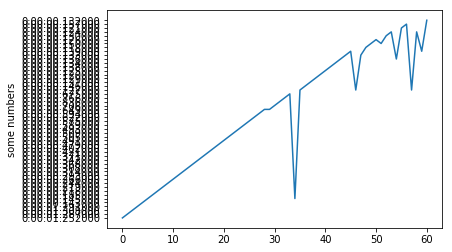

In [10]:
blocks = {}
# print(all_peers)
for j, peer in enumerate(all_peers):
    print(peer)
#     print(all_peers[peer].block_times)
    print(len(all_peers[peer].block_times))
    for i in range(1, len(all_peers[peer].block_times)):
        rt = all_peers[peer].block_times[i][0]
        vt = all_peers[peer].block_times[i][1]
        ct = all_peers[peer].block_times[i][2]
        print("rt %s; vt %s; ct %s"% (rt, vt, ct))
        if i not in blocks:
            blocks[i] = Block(i)
        blocks[i].add_peer(all_peers[peer].name, rt, vt, ct)
    print(all_peers[peer].name)
    
propogation_times = []
for i in range(1, len(blocks)):
#     print('Propogation Time of %s is %s' % (i, blocks[i].get_propogation_time(all_peers[peer])))
    propogation_times.append(blocks[i].get_propogation_time(all_peers[peer]))
    
import matplotlib.pyplot as plt
str_p_time=[]
for time in propogation_times:
    str_p_time.append(str(time))
plt.plot(str_p_time)
plt.ylabel('some numbers')
plt.show()

# 